
___
Team Member Names
- Name 1: Matthew D. Cusack
- Name 2: Tim Cabaza
- Name 3: Amy Adyanthaya

<a id="top"></a>
________
# Clustering
____

## Contents
* <a href="#Imports">Dependency and Data Imports</a>
* <a href="#DataPrep">Data Preparation</a>
* <a href="#BusinessUnderstanding">Business Understanding</a>
* <a href="#DataUnderstanding1">Data Understanding 1</a>
* <a href="#DataUnderstanding2">Data Understanding 2</a> 
* <a href="#ModelEval1">Modeling and Evaluation 1</a>
* <a href="#ModelEval2">Modeling and Evaluation 2</a>
* <a href="#ModelEval3">Modeling and Evaluation 3</a>
* <a href="#ModelEval4">Modeling and Evaluation 4</a>
* <a href="#Deployment">Deployment</a>
* <a href="#Exceptional">Exceptional Work</a>
_______

___
___
<a href="#top">Back to Top</a>
<a id="Imports"></a>
## Imports

In [143]:
#1 
# ! pip freeze --local | grep -v '^\-e' | cut -d = -f 1  | xargs -n1 pip install -U

# Load Dependencies
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
# this import allows you to standardize your data, scaling so that all features have a mean of zero and a standard deviation of 1. 
from sklearn.preprocessing import StandardScaler

# for option A: Clustering methods
from scipy.cluster.hierarchy import dendrogram, linkage, ward
# ! pip install OPTICS
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering, OPTICS

from sklearn.manifold import TSNE
from sklearn import metrics
from sklearn.metrics import silhouette_score, silhouette_samples, completeness_score, homogeneity_score, adjusted_rand_score
from sklearn.datasets import make_blobs
# ! pip install scikit-fuzzy
import skfuzzy as fuzz ## Not finding the package
from sklearn.mixture import GaussianMixture
import itertools
from scipy.cluster.hierarchy import fcluster

# ! pip install yellowbrick
from yellowbrick import cluster
from yellowbrick.cluster import KElbowVisualizer

In [144]:
#2 

# file path
file_path = "../1 - Visualization and Data Preprocessing/Data/ONPClean2.csv" # previously cleaned
# file_path = '../1 - Visualization and Data Preprocessing/Data/OnlineNewsPopularity.csv' # unclean

# Load the dataset
df = pd.read_csv(file_path)

# Set the maximum number of columns to display to None
pd.set_option('display.max_columns', None)
df.head()

,url_name,date,timedelta,n_tokens_title,n_unique_tokens,average_token_length,num_keywords,kw_min_min,kw_avg_min,kw_max_max,kw_avg_max,kw_min_avg,kw_max_avg,is_weekend,LDA_00,LDA_01,LDA_02,LDA_03,LDA_04,global_subjectivity,global_sentiment_polarity,global_rate_positive_words,global_rate_negative_words,rate_positive_words,rate_negative_words,avg_positive_polarity,min_positive_polarity,max_positive_polarity,avg_negative_polarity,min_negative_polarity,max_negative_polarity,title_subjectivity,title_sentiment_polarity,abs_title_subjectivity,abs_title_sentiment_polarity,shares,day_of_week,news_category,year,month,log_shares,log_n_tokens_content,log_num_hrefs,log_num_self_hrefs,log_num_imgs,log_num_videos,log_kw_max_min,log_kw_min_max,log_kw_avg_avg,log_self_reference_min_shares,log_self_reference_max_shares,log_self_reference_avg_sharess
0,amazon-instant-video-browser/,2013-01-07,731.0,12.0,0.663594,4.680365,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.500331,0.378279,0.040005,0.041263,0.040123,0.521617,0.092562,0.045662,0.013699,0.769231,0.230769,0.378636,0.100000,0.7,-0.350000,-0.6,-0.200,0.500000,-0.1875,0.000000,0.1875,593,Monday,Entertainment,2013,1,6.386879,5.393628,1.609438,1.098612,0.693147,0.0,0.0,0.0,0.0,6.208590,6.208590,6.208590
1,reeddit-reddit/,2013-01-07,731.0,8.0,0.821705,4.546154,9.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.022265,0.022446,0.022276,0.251465,0.681548,0.381987,0.152189,0.038462,0.007692,0.833333,0.166667,0.353939,0.033333,0.7,-0.400000,-0.4,-0.400,0.250000,0.2000,0.250000,0.2000,1300,Monday,Tech,2013,1,7.170888,4.875197,2.079442,1.609438,0.000000,0.0,0.0,0.0,0.0,7.170888,7.170888,7.170888
2,rage-comics-dying/,2013-01-07,731.0,9.0,0.608602,4.759494,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.028575,0.199626,0.028615,0.714611,0.028572,0.542580,0.122370,0.063291,0.025316,0.714286,0.285714,0.357269,0.050000,0.6,-0.338889,-1.0,-0.050,0.650000,-0.5000,0.150000,0.5000,1100,Monday,Uncategorized,2013,1,7.003974,6.163315,2.484907,0.000000,0.693147,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000000
3,power-matters-alliance-organization/,2013-01-07,731.0,10.0,0.535390,5.147748,10.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.020011,0.020317,0.117255,0.020007,0.822410,0.425089,0.128515,0.039640,0.012613,0.758621,0.241379,0.337965,0.050000,0.7,-0.225794,-0.4,-0.125,0.500000,-0.1000,0.000000,0.1000,1600,Monday,Tech,2013,1,7.378384,6.320768,2.079442,1.945910,0.693147,0.0,0.0,0.0,0.0,7.550135,7.550135,7.550135
4,polaroid-android-camera/,2013-01-07,731.0,9.0,0.424132,4.631390,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.025001,0.327017,0.025001,0.025001,0.597981,0.506520,0.279769,0.071749,0.013453,0.842105,0.157895,0.417055,0.100000,1.0,-0.212354,-0.5,-0.050,0.333333,0.2500,0.166667,0.2500,2400,Monday,Tech,2013,1,7.783641,7.017506,3.091042,3.091042,3.044522,0.0,0.0,0.0,0.0,6.302619,9.680406,8.140199


___
___
<a href="#top">Back to Top</a>
<a id="DataPrep"></a>
## Data Preperation


    The data preparation process involved a thorough examination for outliers, which revealed no anomalous data points. However, to minimize multicollinearity and enhance the model's predictive performance, we removed highly correlated variables: url_name, date, and log_shares. The dataset was then scaled using scikit learn's StandardScaler function. This transformation effectively standardizes the dataset by removing the mean and scaling to the unit variance which ensures that all the features contributed equally to the learning process for the models' that we examine below. 

In [145]:
#3

# drop certain columns
df1 = df.drop('url_name', axis=1) # was a string and not helpful
df1 = df1.drop('date', axis=1) # datetime change didn't work.
df1 = df1.drop('log_shares', axis=1) # not as useful

# Factor columns that need it for certain models
# Factor the `news_category` column for other two tasks.
df1 = pd.get_dummies(df1, columns=['news_category'], drop_first=False)

# Factor the `day_of_week` column for other two tasks.
df1 = pd.get_dummies(df1, columns=['day_of_week'], drop_first=False)

# drop Na's
df1.dropna()

df1.head()
print(df1.isnull().sum())

timedelta                0
n_tokens_title           0
n_unique_tokens          0
average_token_length     0
num_keywords             0
                        ..
day_of_week_Saturday     0
day_of_week_Sunday       0
day_of_week_Thursday     0
day_of_week_Tuesday      0
day_of_week_Wednesday    0
Length: 61, dtype: int64


In [146]:
#4

# Scale the features using standard scalar.
scaler = StandardScaler()

df1_std = scaler.fit_transform(df1)
# print(df1_std)


___
<a href="#top">Back to Top</a>
<a id="BusinessUnderstanding"></a>
## Business Understanding 1 (10 points).
Describe the purpose of the data set you selected (i.e., why was this data
collected in the first place?). 

    The 'Online News Popularity' data were collected by Mashable.com, a digital media company that publishes articles on a variety of subjects, ranging from technology to world news. Mashable provides coverage on the latest trends and developments, along with entertaining articles covering lifestyle and pop culture. The data were collected by Mashable in 2013 to better understand their readers' preferences with the aim of altering or adjusting their content to create more popular articles. The more popular an article (measured by shares), the more ad revenue and web traffic is generated for Mashable. 

----  
How will you measure the effectiveness of a good algorithm? 

    A good algorithm will generate valuable insights into what drives a popular article, as well as web traffic to Mashable.com. The greater the number of shares and web traffic, the more ad revenue can be generated for Mashable. By implementing a robust algorithm, Mashable can tailor its content to better suit its readers' preferences and boost revenue. Given the diverse clustering methods available, we aim to identify underlying clusters within the Mashable dataset to gain insights into the underlying structure of the dataset that drives readers to share articles. 
 
----
Why does your chosen validation method make sense for this specific dataset and the stakeholders needs?


    Silhouette Coefficient was the chosen method to score all clustering model algorithms, for Gaussian Mixture Model (GMM) we did explore the Bayesian Information Criteria (BIC) score. For the stake holders involved, the Silhouette Score/Coefficient was judged to be the best method to effectively assess the separation of cohesion of clusters produced by the various cluster methods explored. By identifying cluster models that perform best (based off silhouette score) in the Mashable dataset with the goal of identifying distinct groups within the articles shared, valuable insights could be extrapolated to increase web traffic and advertisement revenue. Important limitations were considered when attempting to score the models and further justifies why silhouette was overall the best metric to use: 

        -KMEANS++, Fuzzy C-means (FCM), Hierarchal Clustering, Agglomerative are not directly applicable to BIC.
        -BIC is not typically used with DBSCAN as BIC is designed for probabilistic models. 
        -GMM: Both BIC and Silhouette scoring are valid methods. GMM is based on a probabilistic model. 


____
___
<a href="#top">Back to Top</a>
<a id="DataUnderstanding1"></a>
## Data Understanding 1 (10 points total)

Describe the meaning and type of data (scale, values, etc.) for each attribute in the data file. 

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39644 entries, 0 to 39643
Data columns (total 52 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   url_name                        39644 non-null  object 
 1   date                            39644 non-null  object 
 2   timedelta                       39644 non-null  float64
 3   n_tokens_title                  39644 non-null  float64
 4   n_unique_tokens                 39644 non-null  float64
 5   average_token_length            39644 non-null  float64
 6   num_keywords                    39644 non-null  float64
 7   kw_min_min                      39644 non-null  float64
 8   kw_avg_min                      39644 non-null  float64
 9   kw_max_max                      39644 non-null  float64
 10  kw_avg_max                      39644 non-null  float64
 11  kw_min_avg                      39644 non-null  float64
 12  kw_max_avg                      

##### Original (before any cleaning):
url:        
    Containes the url of the article with the date      
    Object

timedelta:               
    Days between the article publication and the dataset acquisition (non-predictive)               
    float64

n_tokens_title:               
    Number of words in the title               
    float64

n_tokens_content:               
    Number of words in the content               
    float64

n_unique_tokens:               
    Rate of unique words in the content               
    float64

n_non_stop_words:           
    Rate of non-stop words in the content           
    float64

n_non_stop_unique_tokens:      
    Rate of unique non-stop words in the content      
    float64

num_hrefs:                    
    Number of links                 
    float64

num_self_hrefs:               
    Number of links to other articles published by Mashable            
    float64

num_imgs:                      
    Number of images        
    float64

num_videos:                    
    Number of videos            
    float64
    
average_token_length:               
    Average length of the words in the content               
    Float64

num_keywords:               
    Number of keywords in the metadata               
    float64

data_channel_is_lifestyle:     
    Is data channel 'Lifestyle'?            
    Binary (Yes = 1 / No = 0)       
    float64

data_channel_is_entertainment:          
    Is data channel 'Entertainment'?            
    Binary (Yes = 1 / No = 0)       
    float64

data_channel_is_bus:           
    Is data channel 'Business'?         
    Binary (Yes = 1 / No = 0)       
    float64
  
data_channel_is_socmed:        
    Is data channel 'Social Media'?             
    Binary (Yes = 1 / No = 0)       
    float64
   
data_channel_is_tech:          
    Is data channel 'Tech'?             
    Binary (Yes = 1 / No = 0)       
    float64
 
data_channel_is_world:         
    Is data channel 'World'?        
    Binary (Yes = 1 / No = 0)       
    float64
 
kw_min_min:               
    Worst keyword (min. shares)               
    float64

kw_max_min:                    
    Worst keyword (max. shares)         
    float64

kw_avg_min:                    
    Worst keyword (avg. shares)               
    float64

kw_min_max:                    
    Best keyword (min. shares)          
    float64

kw_max_max:                    
    Best keyword (max. shares)               
    float64

kw_avg_max:                    
    Best keyword (avg. shares)               
    float64

kw_min_avg:                    
    Avg. keyword (min. shares)               
    float64

kw_max_avg:                    
    Avg. keyword (max. shares)               
    float64

kw_avg_avg:                    
    Avg. keyword (avg. shares)          
    float64

self_reference_min_shares:    
    Min. shares of referenced articles in Mashable          
    float64

self_reference_max_shares:     
    Max. shares of referenced articles in Mashable          
    float64

self_reference_avg_sharess:   
    Avg. shares of referenced articles in Mashable          
    float64

weekday_is_monday:             
    Was the article published on a Monday?          
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_tuesday:            
    Was the article published on a Tuesday?             
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_wednesday:          
    Was the article published on a Wednesday?               
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_thursday:           
    Was the article published on a Thursday?            
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_friday:             
    Was the article published on a Friday?          
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_saturday:           
    Was the article published on a Saturday?            
    Binary (Yes = 1 / No = 0)       
    float64

weekday_is_sunday:              
    Was the article published on a Sunday?          
    Binary (Yes = 1 / No = 0)       
    float64

is_weekend:                    
    Was the article published on the weekend?               
    Binary (Yes = 1 / No = 0)       
    float64

LDA_00:                        
    LDA topic modeling 
    Closeness to LDA topic 0               
    float64

LDA_01:                       
    Closeness to LDA topic 1               
    float64

LDA_02:                        
    Closeness to LDA topic 2               
    float64

LDA_03:                       
    Closeness to LDA topic 3               
    float64

LDA_04:                        
    Closeness to LDA topic 4               
    float64

global_subjectivity:           
    Text subjectivity               
    float64

global_sentiment_polarity:     
    Text sentiment polarity               
    float64

global_rate_positive_words:    
    Rate of positive words in the content               
    float64

global_rate_negative_words:    
    Rate of negative words in the content               
    float64

rate_positive_words:           
    Rate of positive words among non-neutral tokens               
    float64

rate_negative_words:           
    Rate of negative words among non-neutral tokens               
    float64

avg_positive_polarity:         
    Avg. polarity of positive words               
    float64

min_positive_polarity:         
    Min. polarity of positive words               
    float64

max_positive_polarity:         
    Max. polarity of positive words               
    float64

avg_negative_polarity:         
    Avg. polarity of negative  words               
    float64

min_negative_polarity:         
    Min. polarity of negative  words               
    float64

max_negative_polarity:         
    Max. polarity of negative  words               
    float64

title_subjectivity:            
    Title subjectivity               
    float64

title_sentiment_polarity:      
    Title polarity               
    float64

abs_title_subjectivity:        
    Absolute subjectivity level               
    float64

abs_title_sentiment_polarity:  
    Absolute polarity level               
    float64

shares:                        
    Number of shares (target)               
    Integer

##### Newly Created (after previously cleaning & transformations):
url_name:               
    URL of the article (non-predictive)               
    Float

Date:               
    The date the article was published               
    DateTime

Day_of_week:               
    What day of the week the article is posted on               
    Categorical

news_category:               
    What news category the article is               
    Categorical

Year:               
    The year the article was published               
    Integer

Month:               
    The month the aticle was published               
    Integer

log_shares:               
    log of the "shares" variable               
    Float

log_n_tokens_content:               
    log of the "n_tokens_content" variable               
    Float

log_num_hrefs:               
    log of the "num_hrefs" variable               
    Float

log_num_self_hrefs:               
    log of the "num_self_hrefs" variable               
    Float

log_num_imgs:               
    log of the "num_imgs" variable               
    Float

log_num_videos:               
    log of the "num_videos" variable               
    Float

log_kw_max_min:               
    log of the "kw_max_min" variable               
    Float

log_kw_min_max:               
    log of the "kw_min_max" variable               
    Float

log_kw_avg_avg:               
    log of the "kw_avg_avg" variable               
    Float

log_self_reference_min_shares:               
    log of the "self_reference_min_shares" variable               
    Float

log_self_reference_max_shares:               
    log of the "self_reference_max_shares" variable               
    Float

log_self_reference_avg_shares:               
    log of the "self_reference_avg_shares" variable               
    Float

day_of_weekX where X is the day of the week
    a binary value meaning either Yes (1) it is day X or No (0) it is not day x
     

----
##### Verify data quality: 

Are there missing values?

        The dataset does not have any missing values. 

In [8]:
df.isna().sum()

url_name                          0
date                              0
timedelta                         0
n_tokens_title                    0
n_unique_tokens                   0
average_token_length              0
num_keywords                      0
kw_min_min                        0
kw_avg_min                        0
kw_max_max                        0
kw_avg_max                        0
kw_min_avg                        0
kw_max_avg                        0
is_weekend                        0
LDA_00                            0
LDA_01                            0
LDA_02                            0
LDA_03                            0
LDA_04                            0
global_subjectivity               0
global_sentiment_polarity         0
global_rate_positive_words        0
global_rate_negative_words        0
rate_positive_words               0
rate_negative_words               0
avg_positive_polarity             0
min_positive_polarity             0
max_positive_polarity       

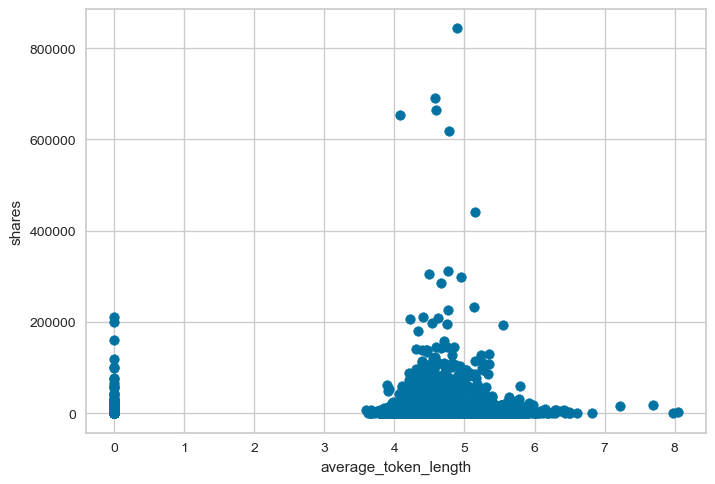

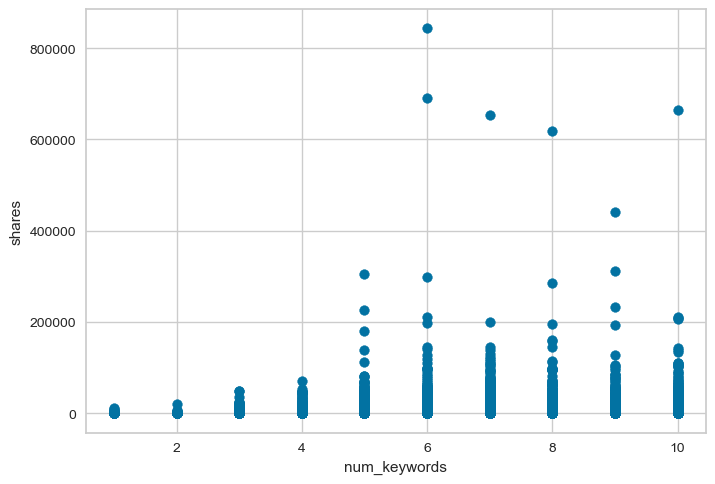

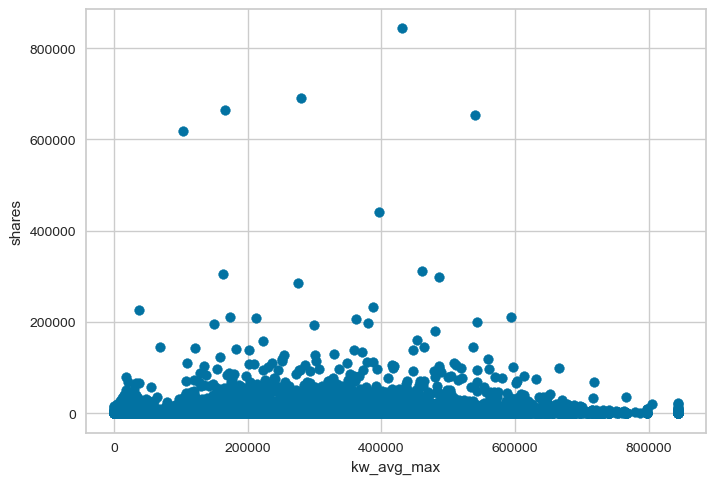

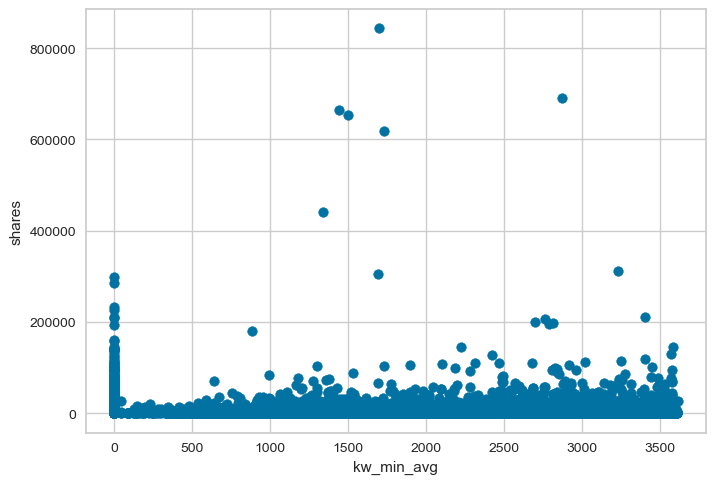

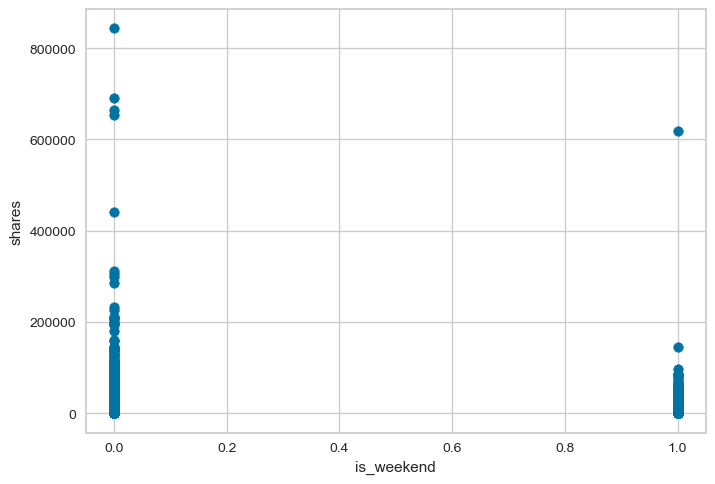

...

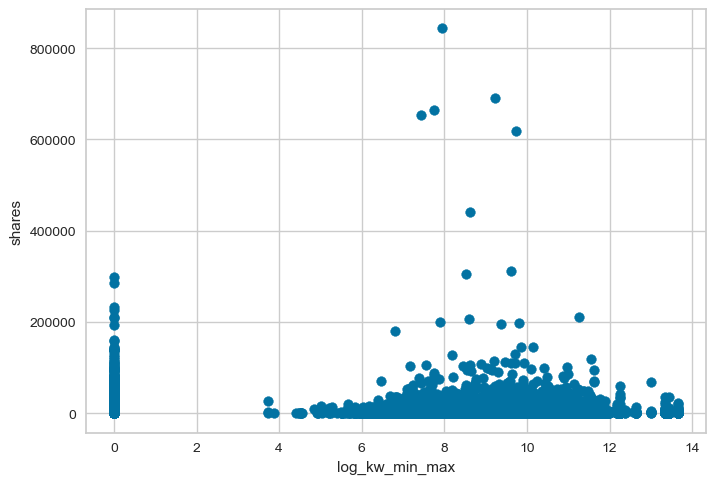

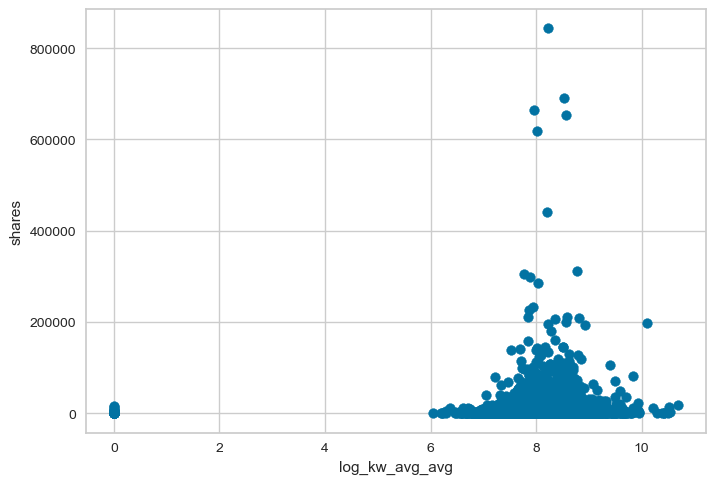

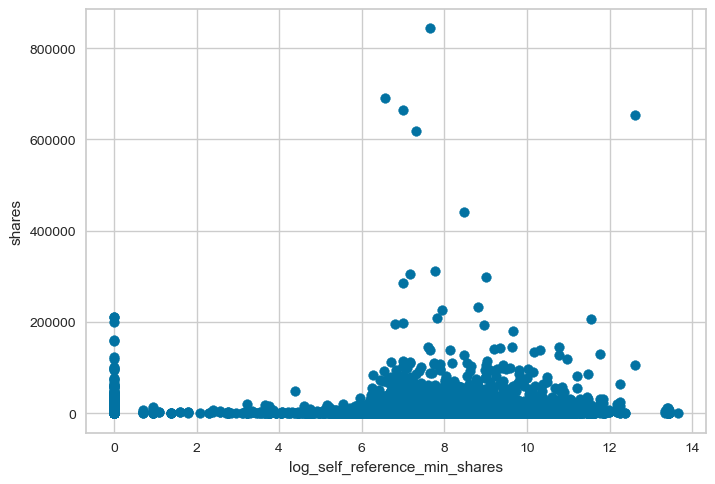

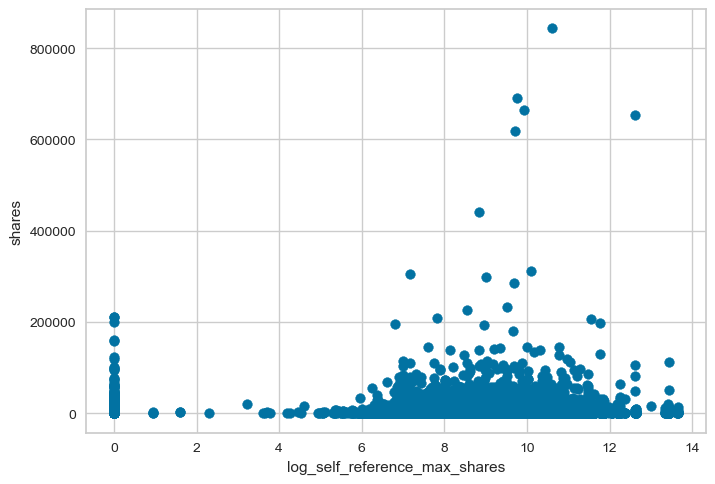

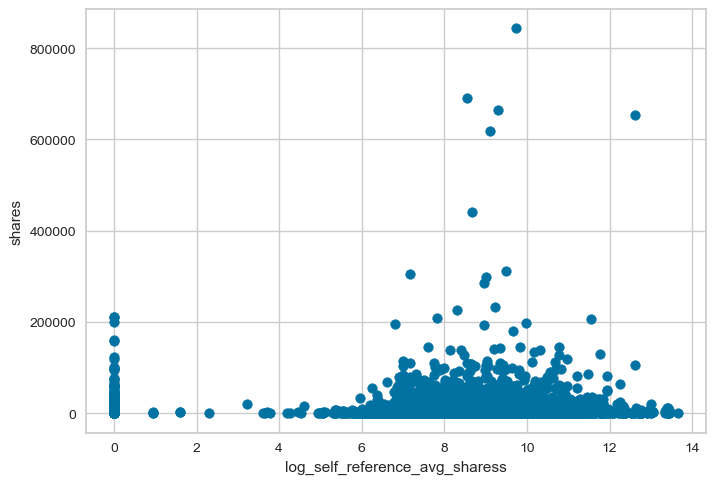

In [9]:

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['average_token_length'], df['shares'])

# Add labels and title
plt.xlabel('average_token_length')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['num_keywords'], df['shares'])

# Add labels and title
plt.xlabel('num_keywords')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['kw_avg_max'], df['shares'])

# Add labels and title
plt.xlabel('kw_avg_max')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['kw_min_avg'], df['shares'])

# Add labels and title
plt.xlabel('kw_min_avg')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['is_weekend'], df['shares'])

# Add labels and title
plt.xlabel('is_weekend')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['LDA_00'], df['shares'])

# Add labels and title
plt.xlabel('LDA_00')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['LDA_01'], df['shares'])

# Add labels and title
plt.xlabel('LDA_01')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['LDA_02'], df['shares'])

# Add labels and title
plt.xlabel('LDA_02')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['LDA_03'], df['shares'])

# Add labels and title
plt.xlabel('LDA_03')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['LDA_04'], df['shares'])

# Add labels and title
plt.xlabel('LDA_04')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['global_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('global_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['global_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('global_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['rate_positive_words'], df['shares'])

# Add labels and title
plt.xlabel('rate_positive_words')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['rate_negative_words'], df['shares'])

# Add labels and title
plt.xlabel('rate_negative_words')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['avg_positive_polarity'], df['shares'])

# Add labels and title
plt.xlabel('avg_positive_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['avg_negative_polarity'], df['shares'])

# Add labels and title
plt.xlabel('avg_negative_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['min_negative_polarity'], df['shares'])

# Add labels and title
plt.xlabel('min_negative_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['title_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('title_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['title_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('title_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['abs_title_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('abs_title_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['abs_title_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('abs_title_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['year'], df['shares'])

# Add labels and title
plt.xlabel('year')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['month'], df['shares'])

# Add labels and title
plt.xlabel('month')
plt.ylabel('log_Shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_n_tokens_content'], df['shares'])

# Add labels and title
plt.xlabel('n_tokens_content')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_num_hrefs'], df['shares'])

# Add labels and title
plt.xlabel('log_num_hrefs')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_num_self_hrefs'], df['shares'])

# Add labels and title
plt.xlabel('log_num_self_hrefs')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_num_imgs'], df['shares'])

# Add labels and title
plt.xlabel('log_num_imgs')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_num_videos'], df['shares'])

# Add labels and title
plt.xlabel('log_num_videos')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_kw_max_min'], df['shares'])

# Add labels and title
plt.xlabel('log_kw_max_min')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_kw_min_max'], df['shares'])

# Add labels and title
plt.xlabel('log_kw_min_max')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_kw_avg_avg'], df['shares'])

# Add labels and title
plt.xlabel('log_kw_avg_avg')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_self_reference_min_shares'], df['shares'])

# Add labels and title
plt.xlabel('log_self_reference_min_shares')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_self_reference_max_shares'], df['shares'])

# Add labels and title
plt.xlabel('log_self_reference_max_shares')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['log_self_reference_avg_sharess'], df['shares'])

# Add labels and title
plt.xlabel('log_self_reference_avg_sharess')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

----
Duplicate data?

    The only duplicative features were 'shares' and 'log_shares.' 'Log_shares' was created from the feature 'shares' during the exploratory data analysis for Lab 1. However, it was dropped because it was not meaningful for the clustering models.

----
Outliers?
 
    A comprehenisve examination of the datset for data points that qualified as outliers that warrented removal. Instead we opted to keep the data intact and preserve the integrity of the data. To deal with any potential outliers usinc scikit learns' built in function StandardScaler. As a result, no datapoints were removed from the analysis. 

----
Are those mistakes? 

        A thorough inspection of the datset revealed that there were no mistakes in the dataset. However certain features that were deemed irrelevant or highly correlated with another feature included in the dataset were excluded from models learning process (url_name, date, and log_shares). 



----
How do you deal with these problems? 

        Leveraing our domain knowledge and in-depth understanding of the dataset, we addressed these issues by either eliminating features that were highly correlated or lacked any predictive power for our models. 
    


____
___
<a href="#top">Back to Top</a>
<a id="DataUnderstanding2"></a>
## Data Understanding 2 (10 points total)

   
Visualize any important attributes appropriately.

Important: Provide an interpretation for any charts or graphs.

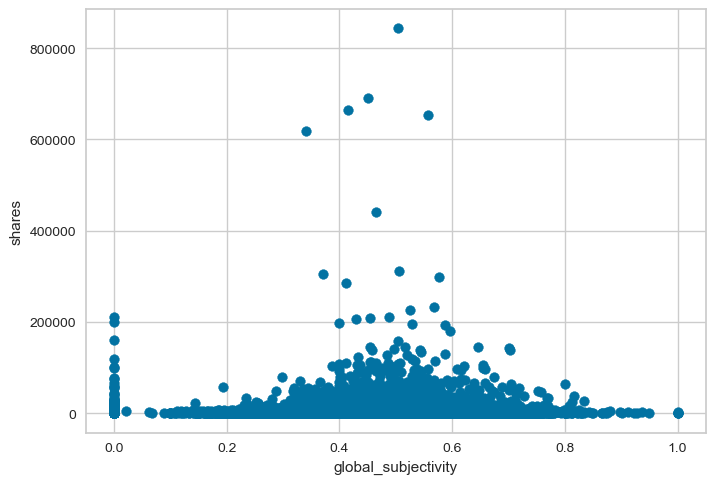

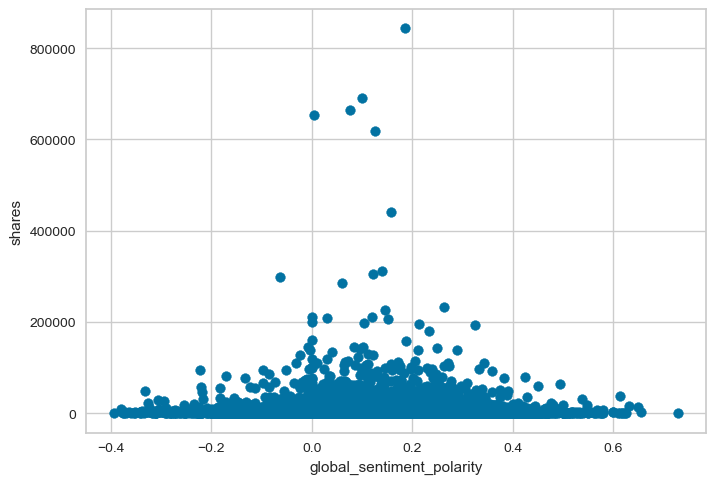

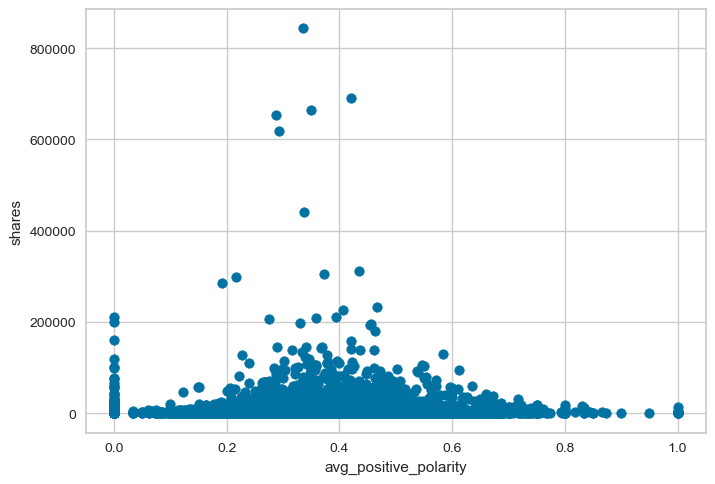

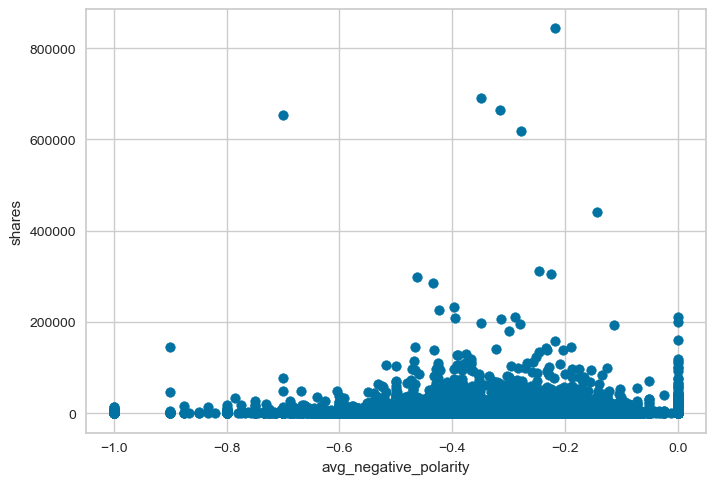

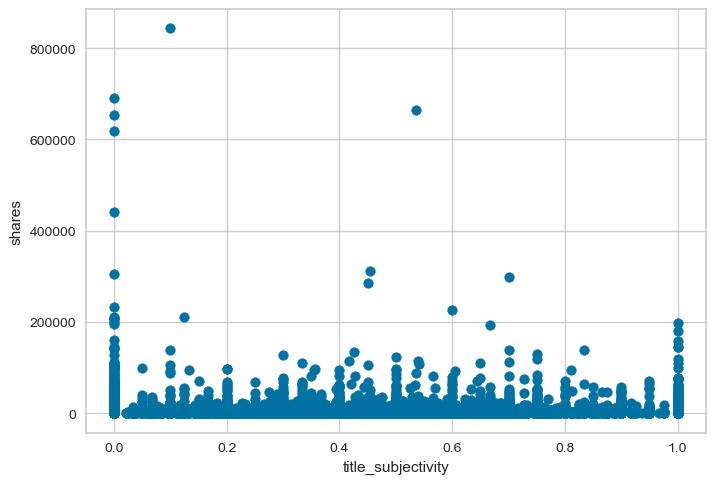

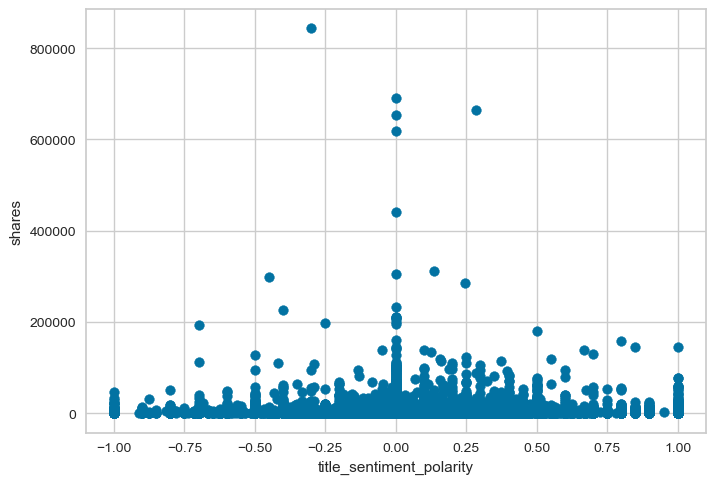

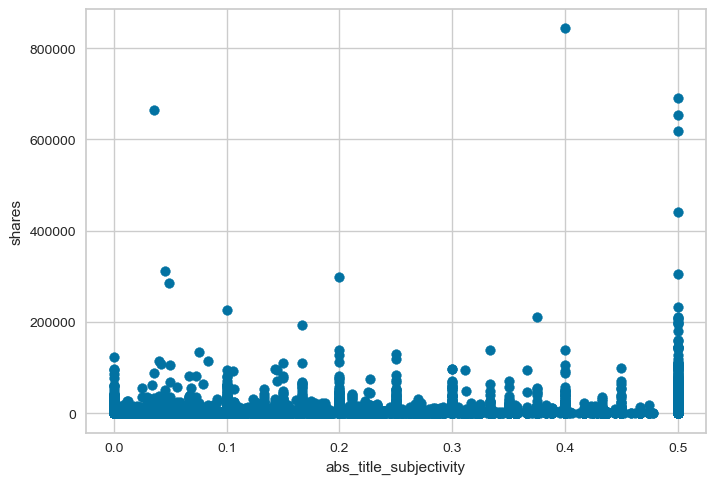

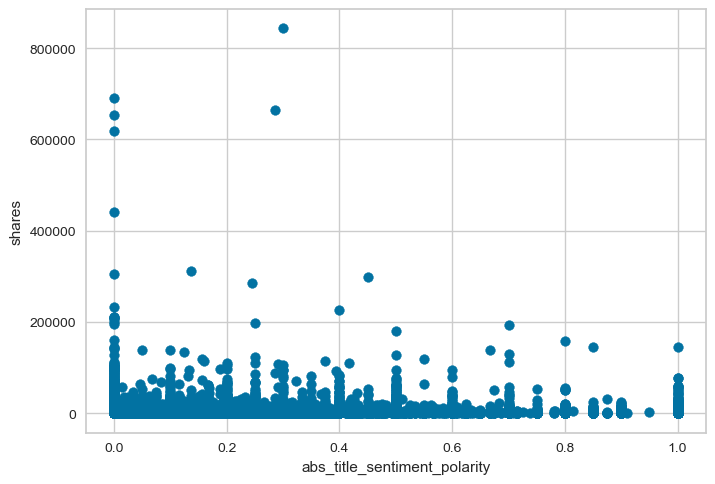

In [9]:

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['global_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('global_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['global_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('global_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()


# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['avg_positive_polarity'], df['shares'])

# Add labels and title
plt.xlabel('avg_positive_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['avg_negative_polarity'], df['shares'])

# Add labels and title
plt.xlabel('avg_negative_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########

# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['title_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('title_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['title_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('title_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['abs_title_subjectivity'], df['shares'])

# Add labels and title
plt.xlabel('abs_title_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['abs_title_sentiment_polarity'], df['shares'])

# Add labels and title
plt.xlabel('abs_title_sentiment_polarity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()


    Leveraing our domain knowledge and understanding of the dataset we selected the above attributes as most important (abs_title_sentiment_polirity, title_sentiment_polarity, abs_title_subjectivity, title_subjectivity, global_subjectivity, global_sentiment_polarity, avg_positive_polarity, avg_negative_polarity). To validate our assumptions, we calculated the F-scores of the attributes in the dataset and their relationship with our target variable shares. 

In [20]:
from sklearn.feature_selection import f_regression

def get_f_scores(df, target_column):
    # Filter for numeric columns
    numeric_columns = df.select_dtypes(include=[np.number]).columns

    # Separate target variable and numeric features
    X = df[numeric_columns]
    y = df[target_column]

    # Calculate F-scores for numeric features
    f_values, p_values = f_regression(X, y)

    # Create a DataFrame with F-scores
    f_scores_df = pd.DataFrame({'feature': X.columns, 'f_score': f_values, 'p_value': p_values})

    # Sort DataFrame by F-scores in descending order
    f_scores_df = f_scores_df.sort_values(by='f_score', ascending=False)

    return f_scores_df

target_column = 'shares'

f_scores_df = get_f_scores(df, target_column)
print(f_scores_df)


                           feature       f_score       p_value
33                          shares  1.383967e+18  0.000000e+00
36                      log_shares  1.394887e+04  0.000000e+00
15                          LDA_03  2.801603e+02  1.138055e-62
44                  log_kw_avg_avg  2.677559e+02  5.507337e-60
10                      kw_max_avg  1.646101e+02  1.322513e-37
14                          LDA_02  1.392434e+02  4.409561e-32
47  log_self_reference_avg_sharess  8.464027e+01  3.748155e-20
41                  log_num_videos  8.433531e+01  4.371824e-20
8                       kw_avg_max  7.931651e+01  5.510917e-19
46   log_self_reference_max_shares  7.841244e+01  8.701107e-19
45   log_self_reference_min_shares  7.644775e+01  2.348201e-18
9                       kw_min_avg  6.210745e+01  3.334784e-15
40                    log_num_imgs  5.103155e+01  9.245582e-13
26           avg_negative_polarity  4.070855e+01  1.786586e-10
17             global_subjectivity  3.963468e+01  3.093

    The top 15 f-scores with p-values less than the alpha significance level of 0.05 are listed below:


    1                          LDA_03  2.801603e+02  1.138055e-62
    2                  log_kw_avg_avg  2.677559e+02  5.507337e-60
    3                      kw_max_avg  1.646101e+02  1.322513e-37
    4                          LDA_02  1.392434e+02  4.409561e-32
    5  log_self_reference_avg_sharess  8.464027e+01  3.748155e-20
    6                  log_num_videos  8.433531e+01  4.371824e-20
    7                       kw_avg_max  7.931651e+01  5.510917e-19
    8   log_self_reference_max_shares  7.841244e+01  8.701107e-19
    9   log_self_reference_min_shares  7.644775e+01  2.348201e-18
    10                       kw_min_avg  6.210745e+01  3.334784e-15
    11                    log_num_imgs  5.103155e+01  9.245582e-13
    12           avg_negative_polarity  4.070855e+01  1.786586e-10
    13             global_subjectivity  3.963468e+01  3.093965e-10
    14                      kw_avg_min  3.668284e+01  1.402459e-09
    15                  log_kw_max_min  3.504767e+01  3.243746e-09

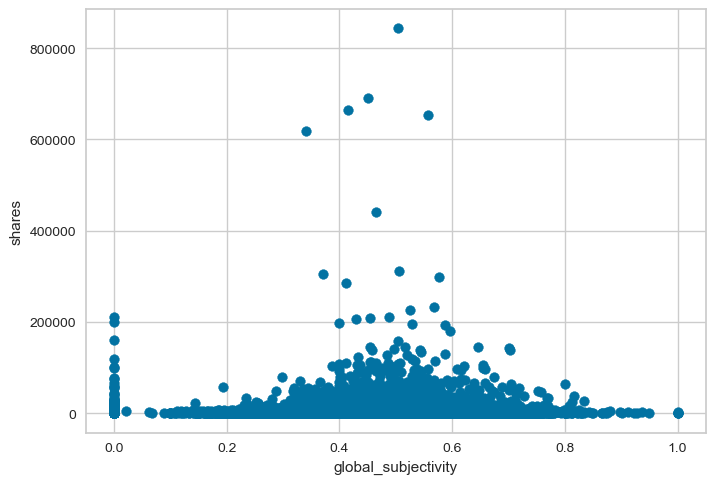

In [15]:
# ##########
# # Create a scatter plot with x being 'shares' and y being 'price'
# plt.scatter(df['kw_max_avg'], df['shares'])

# # Add labels and title
# plt.xlabel('kw_max_avg')
# plt.ylabel('shares')
# plt.title('')

# # Show the plot
# plt.show()

# ##########
# # Create a scatter plot with x being 'shares' and y being 'price'
# plt.scatter(df['kw_avg_max'], df['shares'])

# # Add labels and title
# plt.xlabel('kw_avg_max')
# plt.ylabel('shares')
# plt.title('')

# # Show the plot
# plt.show()

# ##########
# # Create a scatter plot with x being 'shares' and y being 'price'
# plt.scatter(df['avg_negative_polarity'], df['shares'])

# # Add labels and title
# plt.xlabel('avg_negative_polarity')
# plt.ylabel('shares')
# plt.title('')

# # Show the plot
# plt.show()

##########
# Create a scatter plot with x being 'shares' and y being 'price'
plt.scatter(df['global_subjectivity'], df['shares'])


# Add labels and title
plt.xlabel('global_subjectivity')
plt.ylabel('shares')
plt.title('')

# Show the plot
plt.show()

# Column index: 17, Column name: global_subjectivity
# Column index: 33, Column name: shares



In [24]:
#Print the column names and their corresponding indices
for i, column_name in enumerate(df1.columns):
    print(f"Column index: {i}, Column name: {column_name}")

Column index: 0, Column name: timedelta
Column index: 1, Column name: n_tokens_title
Column index: 2, Column name: n_unique_tokens
Column index: 3, Column name: average_token_length
Column index: 4, Column name: num_keywords
Column index: 5, Column name: kw_min_min
Column index: 6, Column name: kw_avg_min
Column index: 7, Column name: kw_max_max
Column index: 8, Column name: kw_avg_max
Column index: 9, Column name: kw_min_avg
Column index: 10, Column name: kw_max_avg
Column index: 11, Column name: is_weekend
Column index: 12, Column name: LDA_00
Column index: 13, Column name: LDA_01
Column index: 14, Column name: LDA_02
Column index: 15, Column name: LDA_03
Column index: 16, Column name: LDA_04
Column index: 17, Column name: global_subjectivity
Column index: 18, Column name: global_sentiment_polarity
Column index: 19, Column name: global_rate_positive_words
Column index: 20, Column name: global_rate_negative_words
Column index: 21, Column name: rate_positive_words
Column index: 22, Col

    IMPORTANT ATTRIBUTE FINAL ASSESSEMNT:
        Given that global_subjectivity (feature 19) is one of our initial chosen important attributes and it had an f-score in the top15 with a p-value less than the alpha 0.05 significan level we will use it for our clustering visualizations verus shares (feature 35).


            global_subjectivity:           
                Text subjectivity               

            shares:                        
                Number of shares (target)

___
___
<a href="#top">Back to Top</a>
<a id="ModelEval1"></a>
## Modeling and Evaluation 1 (10 points total)
### Train and adjust parameters
#### Perform cluster analysis using several clustering methods

----

How did you determine a suitable number of clusters for each method?  
  
    K-means++ clustering:
        To choose the best k we ran the k-means algorithm multiple times on the dataset until we judged 3 to be the optimal number k, centroids. This judgement is subjective and thus a limitation of k-means++ clustering method. To better judge our selected value for k we explore the elbow method. 
        To determine the proper number of clusters a function was created that iterated over the k cluster range suggested by the elbow method. The models were optimized via hyper-parameter tuning (only the most important hyperparameters) and the highest silhouette score recorded to identify the best performing model with cohesive clusters.


    Hierarchical Clustering: 
        To determine a suitable number of clusters in hierarchical clustering we do not need to specify the number of clusters up front. To identify a cluster we looked for gaps or large jumps in distances in merging in the dendrograms. A larger distance indicates a stronger separation between clusters which suggests a distinct cluster boundary. To find the best version we explored different optimization methods and hyper parameter optimization. The models' silhouette scores were recorded and the highest scoring model identified.

    DBSCAN Clustering: 
        To determine the best performing model for DBSCAN, the most important hyperparameters were identified and iterated over. The systemic evaluation of the two key hyperparameters epsilon (EPS) and minimum samples (min_samples). 

    
    FCM Clustering: 
        To determine the best performing model for FCM Clustering, the most important hyperparameters were identified and iterated over. The systemic evaluation of combos of two key hyperparameters n_clusters (the number of clusters) and m_values (the fuzzy parameter or weighting exponent) were iterated over until the combination that yields the highest silhouette score was found.

    GMM Clustering: 
        To determine the best performing model for GMM clustering, the most The systemic evaluation of combos of two key hyperparameters n_components (the number of clusters) and iterations (number of iterations before convergence) were iterated over until the combination that yields the highest silhouette score was found. 

    OPTICS Clustering: 
        To determine the best performing model for OPTICS clustering, the most The systemic evaluation of combos of two key hyperparameters min_samples (defines the minimum number of samples in a neighborhood for a data to be considered a key point) and min_cluster_size (sets the minimum number of samples required for a set of data points to be considered for a cluster) were iterated over until the combination that yields the highest silhouette score was found. 

Describe your results. What findings are the most interesting and why?

    K-means++ Clustering Results: 
        For a K-mean++ clustering method, the proper optimized number of components (k) for this dataset is 7 for either optimization method with a silhouette score 0.098. The results were quite poor. Ideally a silhouette score closer to 1 is needed to indicate a good concise clustering. K-meant++ model struggled to correctly cluster the Mashable dataset even after hyper parameter optimization. 
    
    Hierarchical Clustering Results: 
        Hierarchical Clustering Results:  The approach with 5 clusters and average linkage method performed best with a silhouette coefficient 0.7368268149554027. This was a suprising result given that the dendrogram above is nearly unintelligible and not clear where taxonomies can be drawn. The approach with 6 clusters and the ward linkage optimization method performed best with a silhouette coefficient 0.059. Overall the best method in our judgement is most likely the ward method as it was able to produce a clearer dendrogram despite its lower silohouette score than that of the average linkage method. We suspect that in the end this may not be the best method to cluster our dataset. 

    DBSCAN Clustering Results: 
	    The DBSCAN clustering approach performed well with the same silhouette score as the Agglomerative clustering method 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5. 

    FCM Clustering Results: 
         The FCM clustering method produced a silhouette score of 0.10301753918726955 with 10 clusters and m_value of 1.1.  FCM and K-means in practice typically produce very similar results in practice but given FCM's leniency towards clustering data points it outperformed the best K-means++ model we created earlier.

    GMM Clustering Results: 
        GMM Silhouette Score Results: 
            GMM Clustering (Silhouette Score) Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.10731105780431043.
        GMM BIC Score Results: 
            The GMM model produced an optimized model with 14 clusters and max iterations of 1000 and produced a BIC score of -2653007.6839213474. The lower a BIC score the better; what makes the results curious is that the BIC score suggested different number of clusters compared to that of the silhouette score from the GMM model earlier.

    OPTIC Clustering Results: 
        The OPTICS clustering model produced an optimized model with 5-10 min_samples and cluster size 0.5 components with a silhouette score of 0.6145937682246868. 


    Comprehensive Results: 
        Agglomeratiuve Clustering: complete average linkage method silhouette score 0.736827.
        DBSCAN Clustering: With an eps=0.3 and min_samples=5 silhouette score 0.736827.

    Why: 
        Agglomerative and DBSCAN performed best and there are few possible reasons why these methods worked best for this particular datset. Both methods can effectively identify non-spherical clusters and given each clustering methods unique way of adapting to cluster shapes is most likely the reason why they yielded the highest silhouette scores close to 1. Another reason why these clustering methods performed well compared to the other methods is that each both agglomerative and DBSCAN clustering methods method are robust to outliers. Agglomerative is able to merge outliers based on their linkage distance while DBSCAN has a high tolerance for sparse regions and consequently effective at dealing with outliers. Hierarchical clustering algorithm using the average linkage method and 5 clusters performed well and came in third place with a silouhette score 0.7368268149554027. Upon further analysis we found the model was grouping a large majority of the dataset into one cluster and was not a good fit our given datset. 

### KMeans++

Cluster memberships:
[2 2 2 ... 0 0 0]


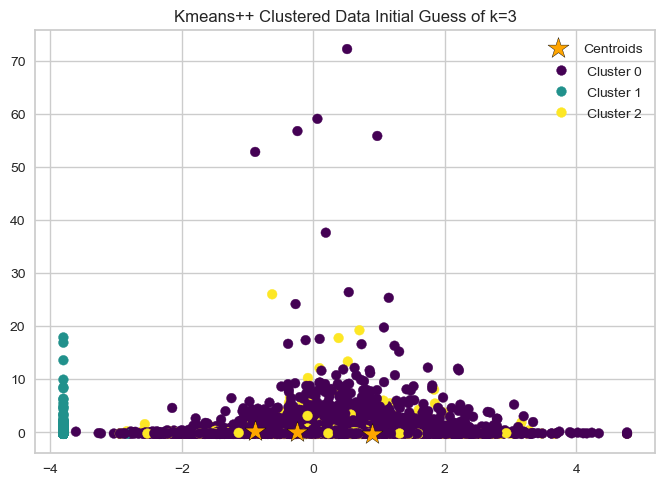

In [27]:
#6 Initial Guess 3 Cluster Kmeans++

# init used to initialize the cluster centroids - default is random but here we are choosing kmeans++ because it leads to faster convergence, n_init is the number of times to run the KMeans algo with different initializations - the default is 10 

kmeans = KMeans(init='k-means++', n_clusters=3, n_init=10, max_iter=300, tol=1e-04, random_state=0).fit(df1_std)

print("Cluster memberships:\n{}".format(kmeans.labels_))

scatter = plt.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, cmap='viridis')

centroid = plt.scatter(kmeans.cluster_centers_[:, 0],kmeans.cluster_centers_[:, 1], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')

#create legend for scatter plot 
handles, labels = scatter.legend_elements()
scatter_legend = plt.legend(handles, [f'Cluster {label}' for label in labels], title='     ', loc='upper right')
# Create a legend for the centroids
centroid_legend = plt.legend([centroid], ['Centroids'], loc='upper right')
# add the centroids to te legned 
plt.gca().add_artist(scatter_legend)

# plt.legend(["cluster", "centroid"], loc='best')
# plt.xlabel('Shares 17')
# plt.ylabel('global_subjectivity 33')
plt.title('Kmeans++ Clustered Data Initial Guess of k=3')
plt.show()

    Sklearn documentation explains that the K-means++ implemented algorithm is known as "greedy k-means++" as it helps speed up convergence by iterating several trials over a single sampling step and then chooses the best centroid for that sample. 

    The kmeans.cluster_centers in the code finds the centroids (average) of similar points with continuous features marked with stars of which there are three. The dots are representative of data points and colored by their clustering group of which there are three. 

    Too choose the best k we ran the k-means algorithm multiple times on the dataset until we judged 3 to be the optimal number k, centroids. This judgement is subjective and thus a limitation of k-means++ clustering method. To better judge our selected value for k we explore the elbow method. 



     To properly judge the performance and quality of the clustering with our selected value of 3 for k centroids, the Elbow method is done. The method graphically represents the findings of an the optimal K value by finding within cluster sum of squares (SSE). 

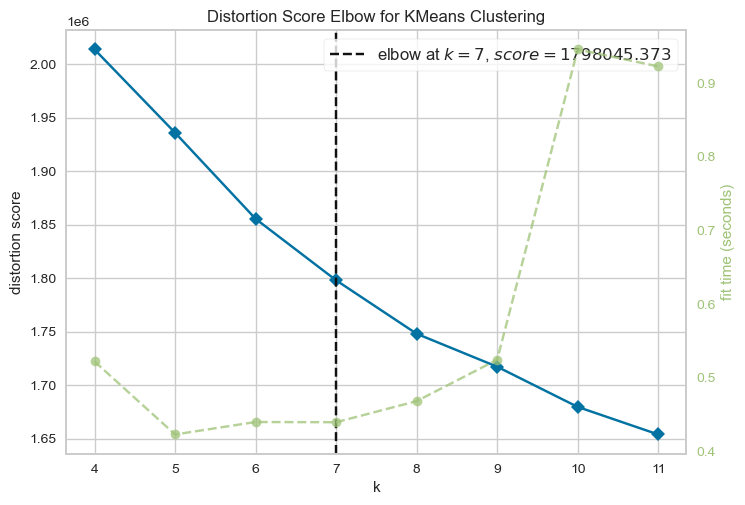

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [29]:
#7 Elbow Method to choose optimal k

# Instantiate the clustering model and visualizer
for i in range(1, 25):
    model = KMeans(n_clusters=i,
    init='k-means++',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0)
visualizer = KElbowVisualizer(model, k=(4,12), times=False, metric='distortion')

visualizer.fit(df1_std)     # Fit the data to the visualizer
visualizer.show()        # Finalize and render the figure

    If K increases, the distortion (computes the sum of squared distances) will decrease. The plot helps us identify the value of K where the distortion begins to increase more rapidly. 

    Below is our K-means++ function that iterates over the cluster range of 5-12 (a  little wider for the suggested k from the elbow method) and hyperparameter tuning. 

In [36]:
# 8 K-Means++ hyper-parameter tuning function 

n_clusters_range = range(5, 12)
algorithms =["lloyd", "elkan"]
n_init = 'auto' # must be this way for kmeans++
max_iter = 300 # default for max iterations to convergence 

def kmeans_silhouette(df1_std, n_clusters=n_clusters_range, algorithms=algorithms, n_init=n_init, max_iter=300, plot=True):
    # silhouette score recording
    silhouette_scores = []

    # Create separate figures and subplots for each iteration
    for algorithm in algorithms:
        fig, axs = plt.subplots(len(n_clusters_range), 1, figsize=(10, 5 * len(n_clusters_range)))

        for ax, n_clusters in zip(axs, n_clusters_range):
            ax.set_title(f'Kmeans with {algorithm} Initialization')
            kmeans = KMeans(init='k-means++', n_clusters=n_clusters, n_init=n_init, max_iter=max_iter, random_state=0)

            kmeans.fit(df1_std)
            # Calculate Silhouette Score
            silhouette_scores.append(silhouette_score(df1_std, kmeans.labels_))
            
            # Plot clustered data and centroids
            ########
            # cluster_scatter = ax.scatter(df1_std[:, 0], df1_std[:, 1], c=kmeans.labels_, alpha=0.5, label="Clusters", cmap='viridis')
            # centroid_scatter = ax.scatter(kmeans.cluster_centers_[:, 0], kmeans.cluster_centers_[:, 1], s=250, marker='*', c='orange', edgecolor='black', label='Centroids')
            ########
            
            cluster_scatter = ax.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, alpha=0.5, label="Clusters", cmap='viridis')
            centroid_scatter = ax.scatter(kmeans.cluster_centers_[:, 17], kmeans.cluster_centers_[:, 33], s=250, marker='*', c='orange', edgecolor='black', label='Centroids')

            # Create separate legends for clusters and centroids
            cluster_legend = ax.legend(handles=[cluster_scatter], labels=["Clusters"], loc="upper right")
            centroid_legend = ax.legend(handles=[centroid_scatter], labels=["Centroids"], loc="lower right")
            
            # Add the centroids to the overall legend
            # ax.add_artist(cluster_legend)
            # centroid_legend = ax.add_artist(cluster_scatter)
            ax.legend()
            # ax.set_xlabel("Feature 1")
            # ax.set_ylabel("Feature 2")


        plt.show()  # Display the plot after each iteration

    return kmeans.labels_, kmeans.cluster_centers_, silhouette_scores




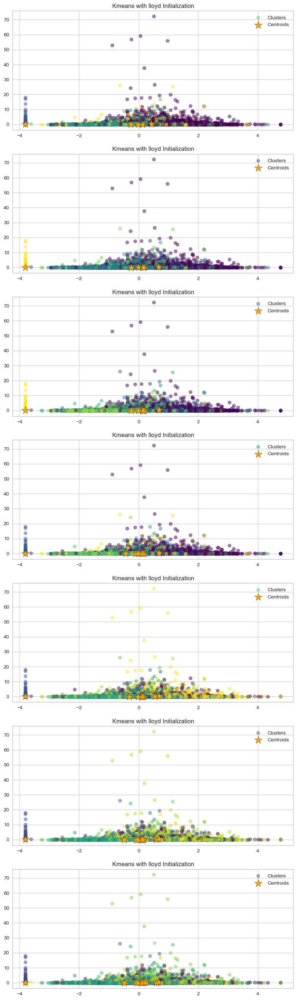

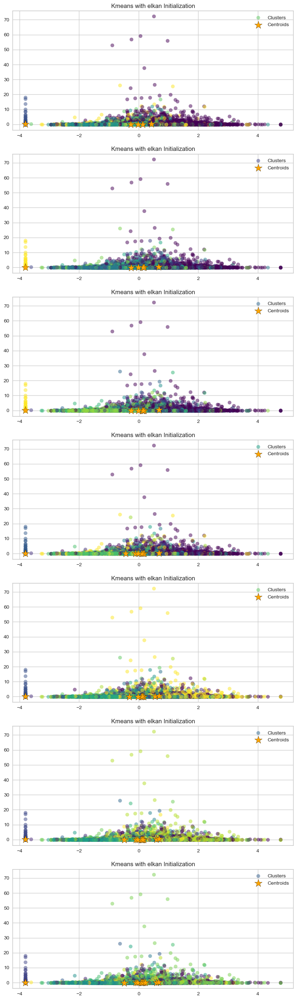

Centroids: [3 3 3 ... 9 6 1]
Silhouette Scores for each model: [0.08527615207030946, 0.09618289171403514, 0.09806539172081748, 0.07140163303693893, 0.09304182529725832, 0.07402998667889896, 0.0751817018331908, 0.08527615207030946, 0.09618289171403514, 0.09806539172081748, 0.07140163303693893, 0.09304182529725832, 0.07402998667889896, 0.0751817018331908]


In [37]:
# 9 Call the K-Means++ Function to print visualizations and all scores 

######################################################
# Assuming you have 'df1_std' and 'n_clusters_range' defined
labels, centers, scores = kmeans_silhouette(df1_std, n_clusters_range)
print("Centroids:", labels)
# print("Cluster Centers:", centers)
print("Silhouette Scores for each model:", scores)

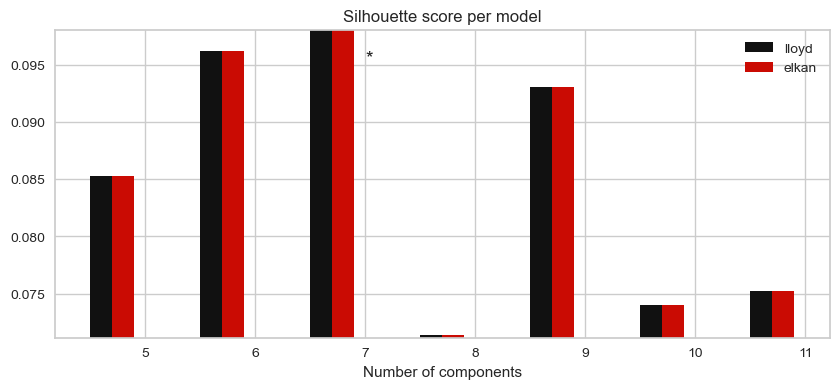

Highest Silhouette Score marked by a star on the graph at 7 components with both Lloyd and Elkan optimization methods: 0.09806539172081748


In [40]:
# 9 Identify K-means++ Scores from fitting different hyper-parameters 

###############
# !pip install itertools
######################
sil = np.array(scores)
color_iter = itertools.cycle(['k', 'r'])
bars = []

plt.figure(figsize=(10, 4))
spl = plt.subplot(1, 1, 1)

# Plot the silhouette scores
for i, (algorithm, color) in enumerate(zip(algorithms, color_iter)):
    xpos = np.array(n_clusters_range) + 0.2 * (i - 2)
    bars.append(plt.bar(xpos, sil[i * len(n_clusters_range):(i + 1) * len(n_clusters_range)],
                        width=0.2, color=color))

plt.xticks(n_clusters_range)
plt.ylim([sil.min() * 1.01 - 0.01 * sil.max(), sil.max()])
plt.title('Silhouette score per model')

# Find the position for '*'
xpos = np.argmax(sil) % len(n_clusters_range)
plt.text(n_clusters_range[xpos], sil.max() * 0.97, '*', fontsize=14)

# Set xlabel and legend
spl.set_xlabel('Number of components')
spl.legend([b[0] for b in bars], algorithms)

plt.show()

# credit week 11 notebook for code inspiration

##################################
# create highest score dictionary to store all scores for all model types going forward 
highest_scores_dict = {}

# Find the highest silhouette score
highest_kmeans_plusplus_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['Kmeans++'] = highest_kmeans_plusplus_score


print("Highest Silhouette Score marked by a star on the graph at 7 components with both Lloyd and Elkan optimization methods:", highest_kmeans_plusplus_score)
#################################



    The bar plot visualizes the number of components or clusters for each K-means++ algorithm (Lloyd, Elkan) by their silhouette score. The Lloyd and Elkan optimization algorithm methods update the centers in k-means clustering in different ways. Lloyd is the standard optimizer, that uses what is known as the "hill-climbing" approach by spending most of its time computing the distances between thh data points and the k-cluster centers for minimizing the k-means optimization criterion. While Elkan's is a variation of Lloyd's algorithm that reduces the number of distance calculations that need to be performed by using a triangular inequality to determine whether the distance between a data point is closer to its current centroid or to another centroid. If a given data point is closer to its current centroid than any other, then no distance calculation is performed. 


/Users/tmc/opt/anaconda3/envs/PythonData/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster memberships:
[2 2 2 ... 3 5 1]


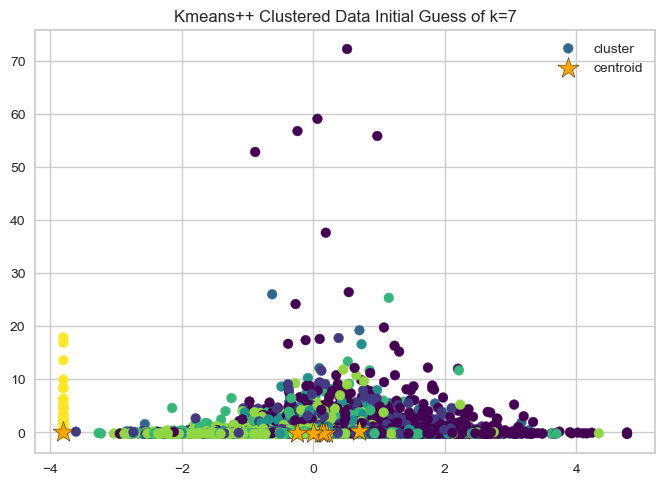

In [28]:
# 10 K-means++ Optimized Model for our given dataset from Mashable

kmeans = KMeans(init='k-means++', n_clusters=7, max_iter=300, random_state=0).fit(df1_std)

print("Cluster memberships:\n{}".format(kmeans.labels_))

####
# plt.scatter(df1_std[:, 0], df1_std[:, 1], c=kmeans.labels_, cmap='viridis')
# plt.scatter(kmeans.cluster_centers_[:, 0],kmeans.cluster_centers_[:, 1], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')
####
plt.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 17],kmeans.cluster_centers_[:, 33], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')

plt.legend(["cluster", "centroid"], loc='best')
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
plt.title('Kmeans++ Clustered Data Initial Guess of k=7')
Kplt_kmeans_optimized = plt.show()
Kplt_kmeans_optimized

    Results: For a K-mean++ clustering method, the proper optimized number of components (k) for this dataset is 7 for either optimization method with a a silhouette score 0.098. The centroids are represented by stars and the clusters represented by different colored dots.   

----

### Hierarchical / Agglomorative Clustering

    The next method explored was Hiearachal Clustering. There are two main approaches that work through different methods divisive hierarchical and agglomerative clustering. In divisive clustering it starts with a single cluster that encompasses teh complete dataset and it iterativly splits the cluster into smaller clusters until each cluster only contains one example. In agglomerative clustering the model starts wtih each example as an its own cluster and merges teh closest pairs of clusters until only one cluster remains. 
    
    Visually the algorithms are plotted using dendrograms which visuallizes the biznary hierarchical clustering which helps us interpert the results by finding meaningful clusters.
    

Hiarachal Clustering Dendrograms

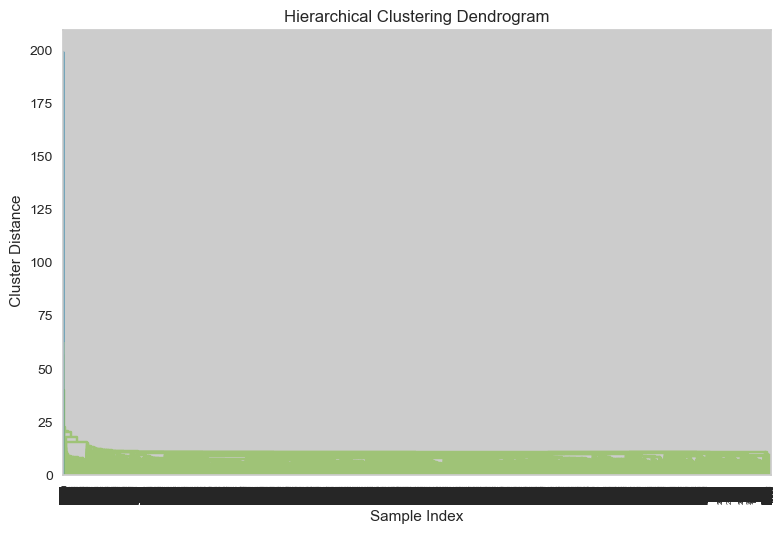

In [13]:
# 11 Hierarchal Clustering Method=Average

# average linkage 
# merges the two clusters that have the smallest average distance between all their points.

# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='average')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
ACDpltA = plt.show()
ACDpltA

    This dendogram utilized the "average" linkage method which picks two clusters to merge that are the smallest distance between all other points.

    Results: The dendogram above is nearly unintelligible given the sample index and the number of cluster distances at 25. This method is not optimal. 


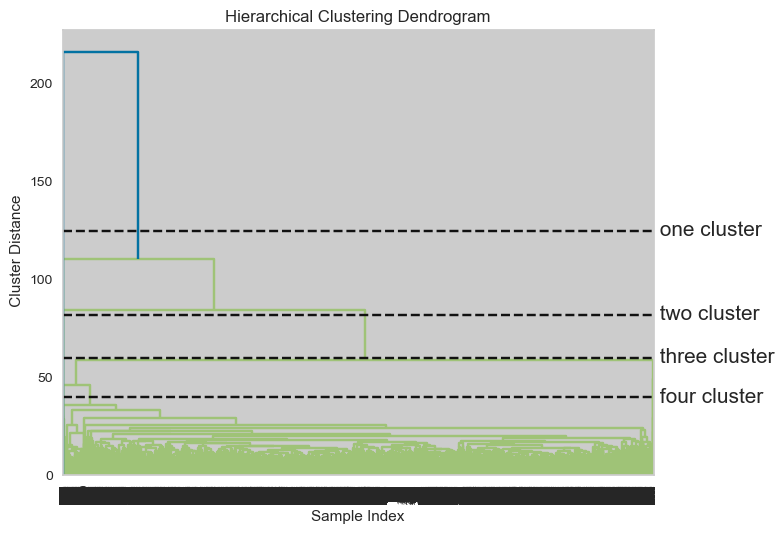

In [14]:
# 12 Hierarchal Clustering Method=complete

# complete linkage (also known as maximum linkage)
# merges the two clusters that have the smallest maximum distance between their points.

# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='complete')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()
ax = plt.gca()
bounds = ax.get_xbound()

ax.plot(bounds, [125, 125], '--', c='k')
ax.text(bounds[1], 125, ' one cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [82, 82], '--', c='k')
ax.text(bounds[1], 82, ' two cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [60, 60], '--', c='k')
ax.text(bounds[1], 60, ' three cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [40, 40], '--', c='k')
ax.text(bounds[1], 40, ' four cluster', va='center', fontdict={'size': 15})

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
ACDpltC= plt.show()
ACDpltC

    This dendrogram utilized the "complete" linkage, also known as the "maximum linkage" method, picks two clusters to merge that are the smallest maximum distance between their points.

    Results: The dendrogram using the complete linkage methods shows some clear potential clusters with at least 5 cuts identified. 




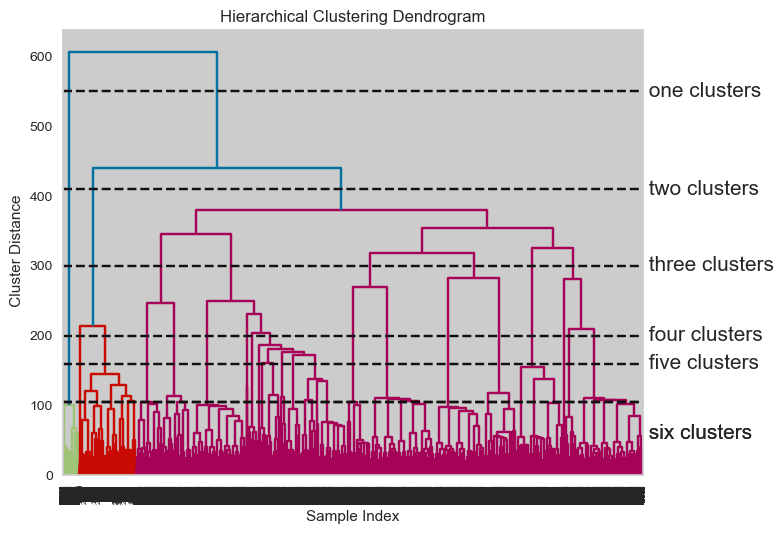

In [15]:
# 13 Hierarchal Clustering Method=ward

# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='ward')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()

ax.plot(bounds, [550, 550], '--', c='k')
ax.text(bounds[1], 550, ' one clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [410, 410], '--', c='k')
ax.text(bounds[1], 410, ' two clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [300, 300], '--', c='k')
ax.text(bounds[1], 300, ' three clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [200, 200], '--', c='k')
ax.text(bounds[1], 200, ' four clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [160, 160], '--', c='k')
ax.text(bounds[1], 160, ' five clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
ACDpltW= plt.show()
ACDpltW

    

    This dendrogram utilized the "complete" linkage, also known as the "minimum variance" linkage method, prioritizes the minimizing the average distance between data points within a merged cluster by minimizing the total within the cluster variance by merging two clusters that results in the smallest increase in variance. 

    Results: The dendrogram using the ward linkage methods identified at least 7 clusters.  

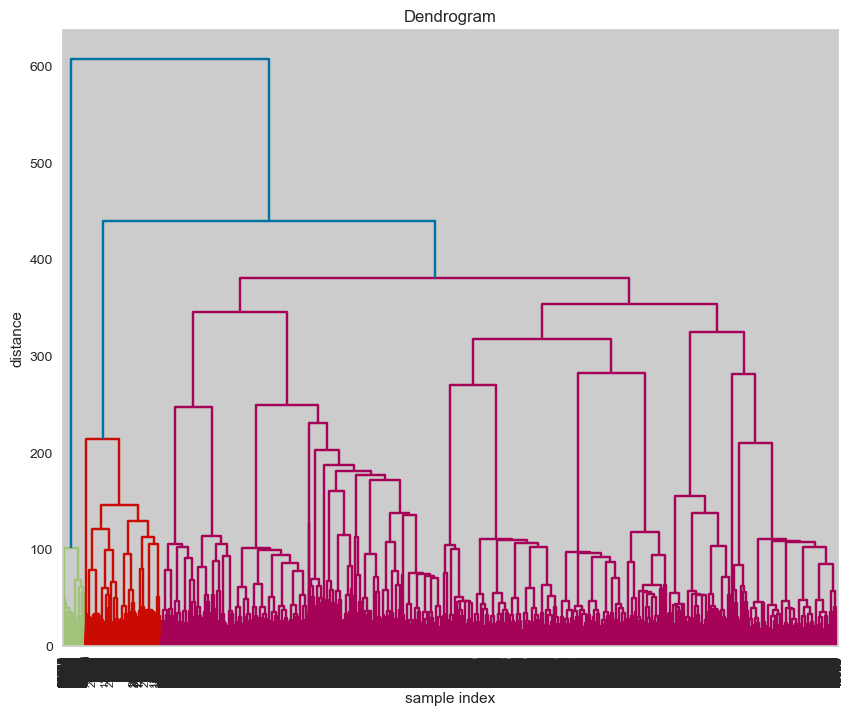

With 5 clusters, the silhouette score is 0.04719703051522329
With 6 clusters, the silhouette score is 0.0593168231401565
With 7 clusters, the silhouette score is 0.053060313773702135
With 8 clusters, the silhouette score is 0.058768950894333184
With 9 clusters, the silhouette score is 0.057757778061823424
Highest Silhouette Score is 6 components with the Ward linkage method: 0.0593168231401565


In [162]:
# 14 Score the different number of cluster cuts on Dendrogram 

# Assign linkage

linkage_matrix = linkage(df1_std, method='ward')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")

##################################

# Find the highest silhouette score
highest_linkage_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['Hierarchal Clustering: ward linkage method'] = highest_linkage_score


print("Highest Silhouette Score is 6 components with the Ward linkage method:", highest_linkage_score)
#################################

# you will want to add to the dciontary as you go and then turn into a dataframe evnetually 
# Convert the dictionary to a DataFrame
# df_highest_scores = pd.DataFrame(list(highest_scores_dict.items()), columns=['Clustering Method', 'Highest Score'])

# # Print the DataFrame
# print(df_highest_scores)

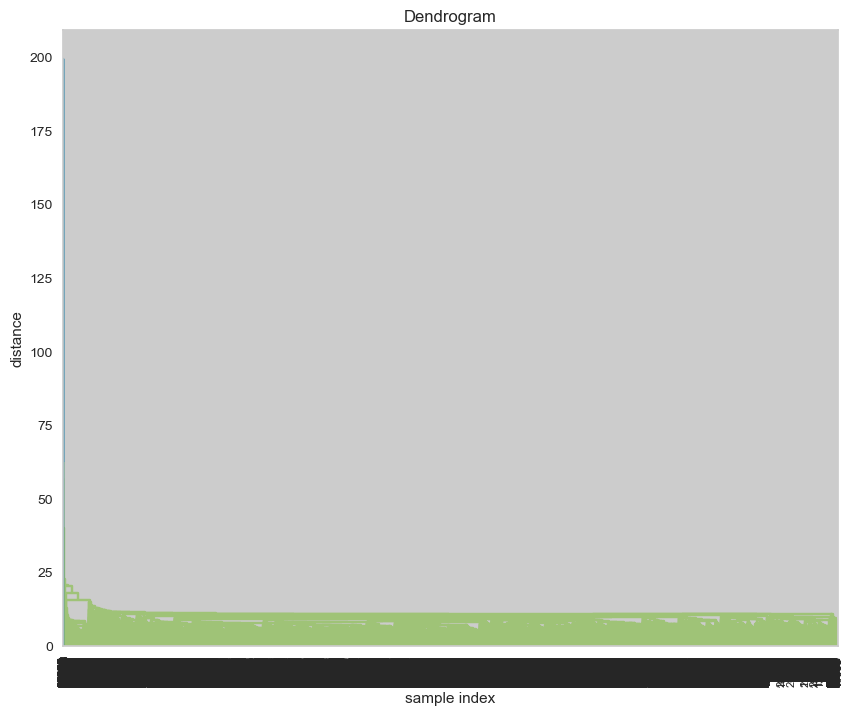

With 5 clusters, the silhouette score is 0.7368268149554027
With 6 clusters, the silhouette score is 0.7367877262221442
With 7 clusters, the silhouette score is 0.7366899855769141
With 8 clusters, the silhouette score is 0.7265337689140468
With 9 clusters, the silhouette score is 0.53461850132184
Highest Silhouette Score is 6 components with the average linkage method: 0.7368268149554027


In [163]:
# 14 Score the different number of cluster cuts on Dendrogram 

# Assign linkage

linkage_matrix = linkage(df1_std, method='average')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")

##################################

# Find the highest silhouette score
highest_linkage_score = max(scores)
# Store the highest score in the dictionary
# highest_scores_dict['Hierarchal Clustering: ward linkage method'] = highest_linkage_score

print("Highest Silhouette Score is 6 components with the average linkage method:", highest_linkage_score)
#################################

# you will want to add to the dciontary as you go and then turn into a dataframe evnetually 
# Convert the dictionary to a DataFrame
# df_highest_scores = pd.DataFrame(list(highest_scores_dict.items()), columns=['Clustering Method', 'Highest Score'])

# # Print the DataFrame
# print(df_highest_scores)

    Hierarchal Clustering Results: The approach with 5 clusters and average linkage method performed best with a silhouette coefficient 0.7368268149554027. This was a suprising result given that the dendrogram above is nearly unintelligible and not clear where taxonomies can be drawn. The approach with 6 clusters and the ward linkage optimization method performed best with a silhouette coefficient 0.059. 

    Overall the best method in our judgement is most likely the ward method as it was able to produce a clearer dendrogram despite its lower silohouette score than that of the average linkage method. We suspect that in the end this may not be the best method to cluster our dataset. 

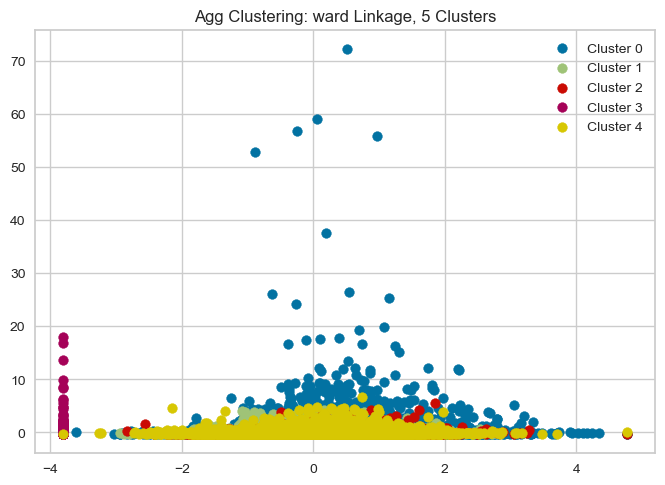

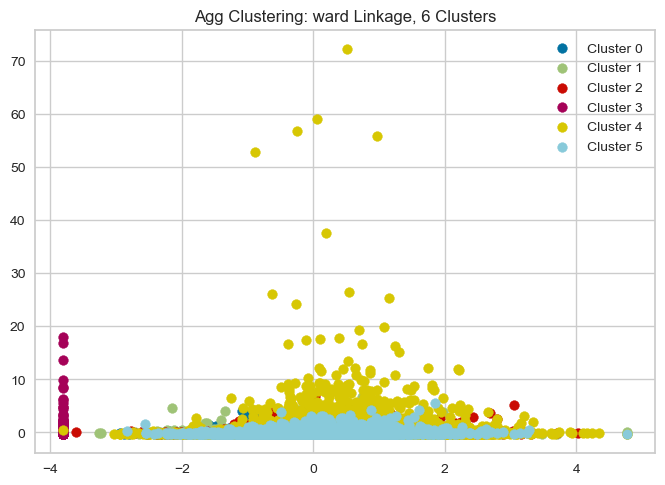

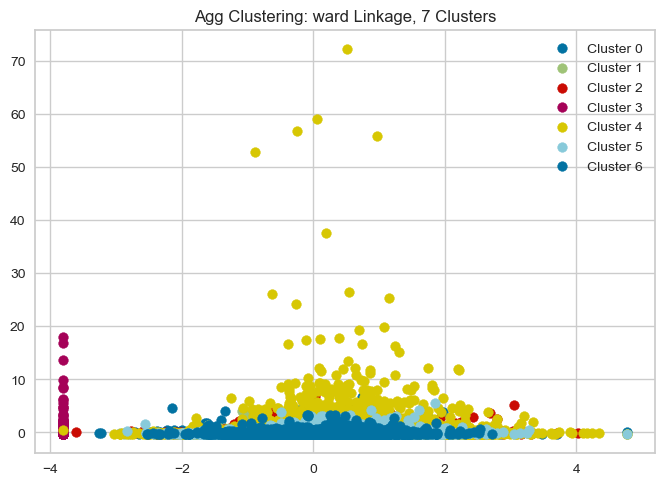

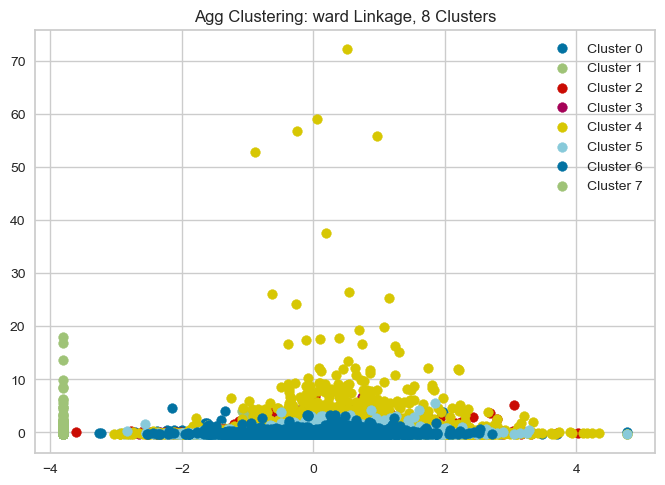

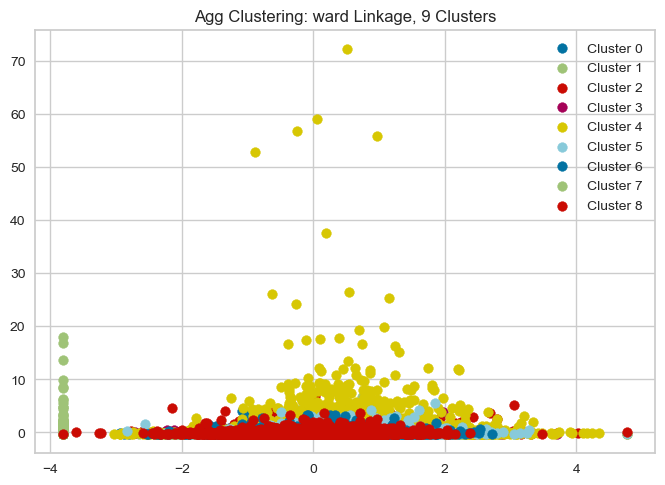

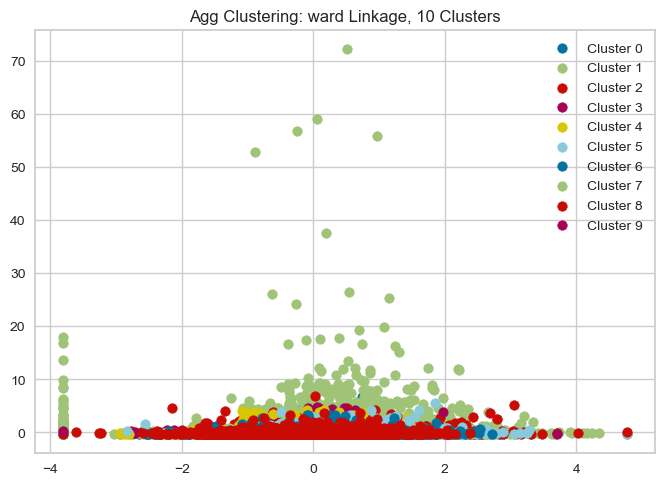

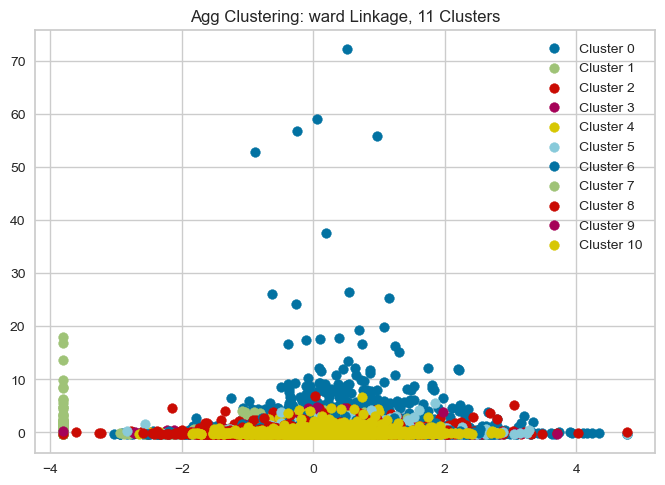

Silhouette Scores: [0.04719703051522329, 0.0593168231401565, 0.053060313773702135, 0.058768950894333184, 0.057757778061823424, 0.0574600527512066, 0.05719342324423517]


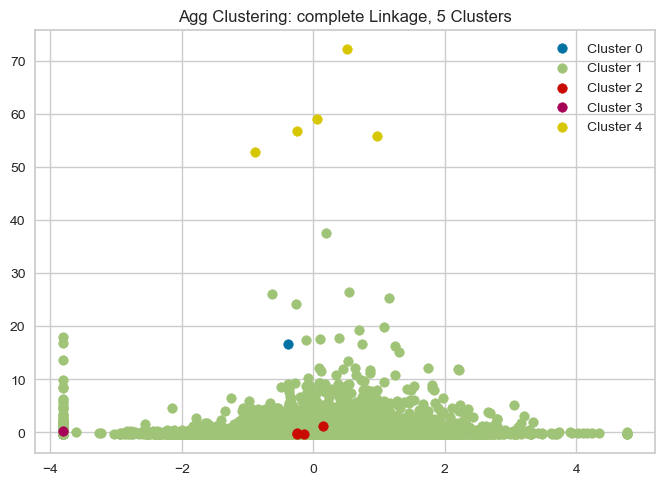

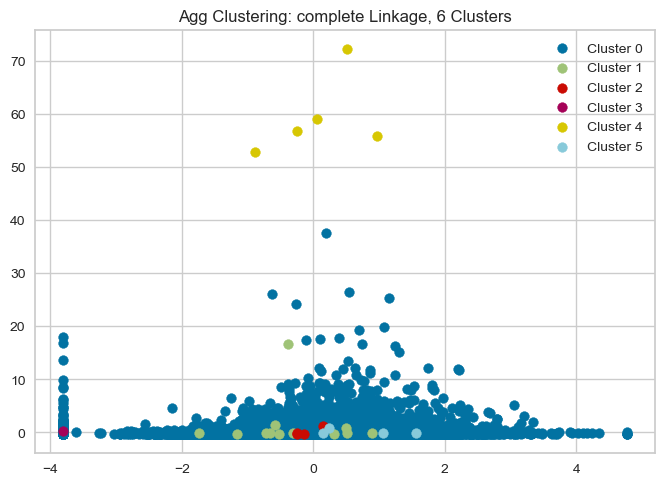

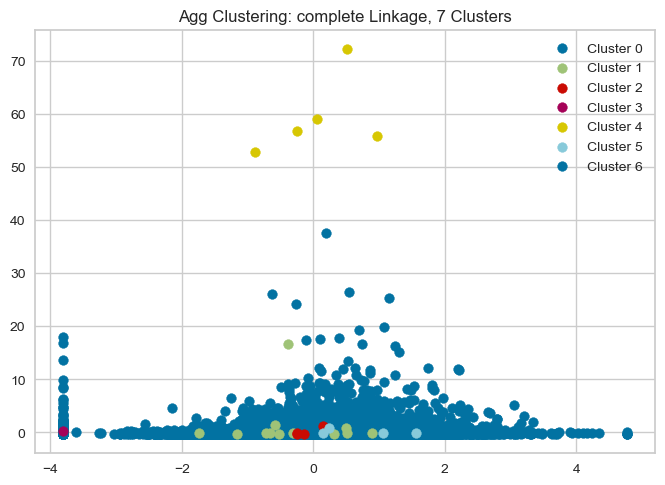

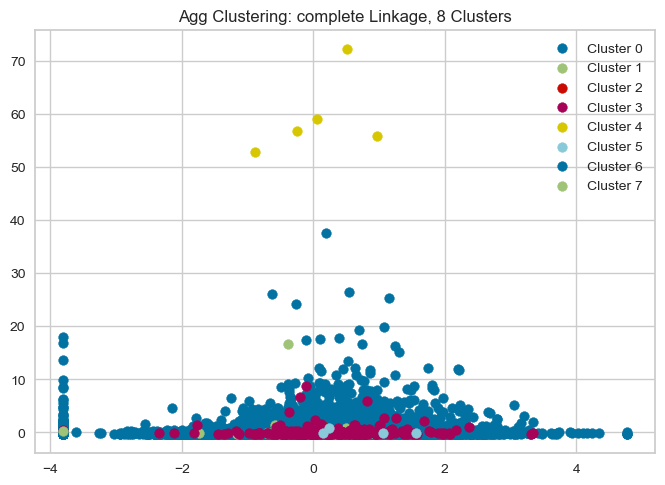

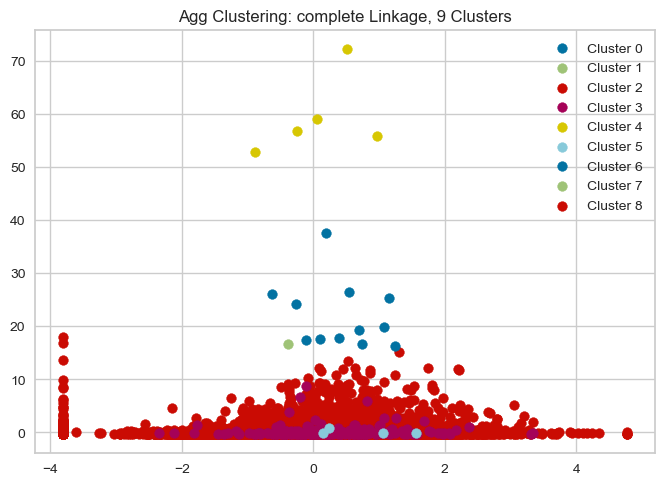

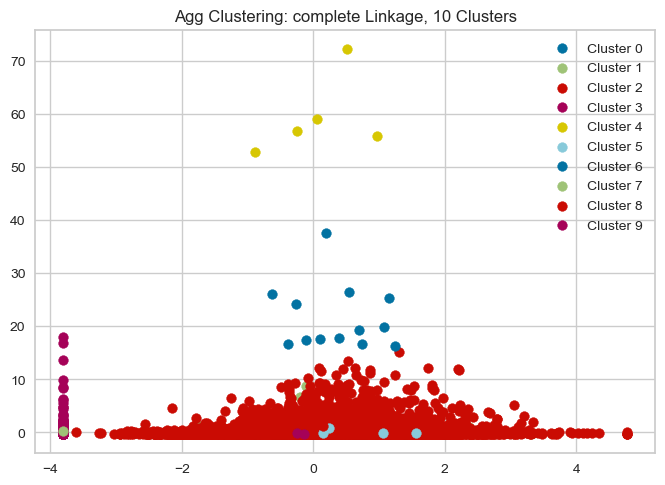

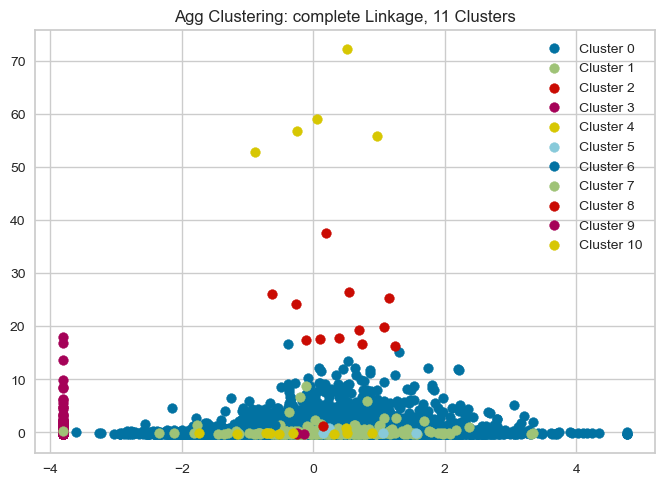

Silhouette Scores: [0.680354980306162, 0.6721272019746035, 0.5699056603444853, 0.269908786917372, 0.2879686956787806, 0.28795779827281054, 0.2879092126279348]


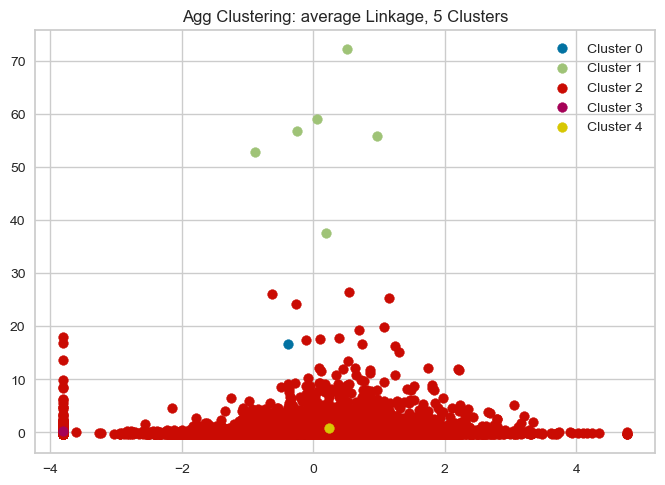

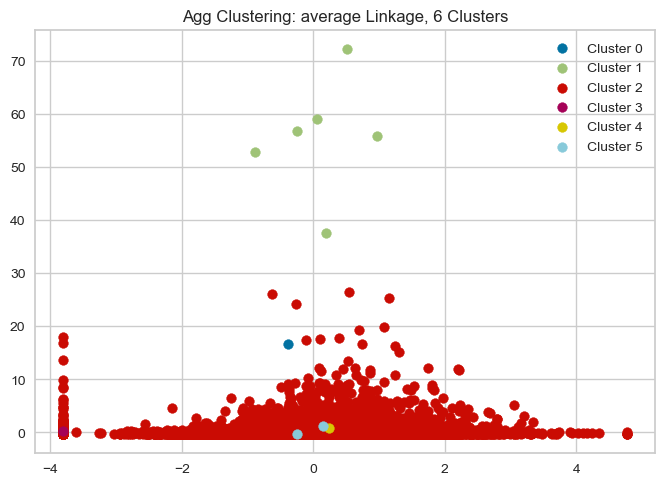

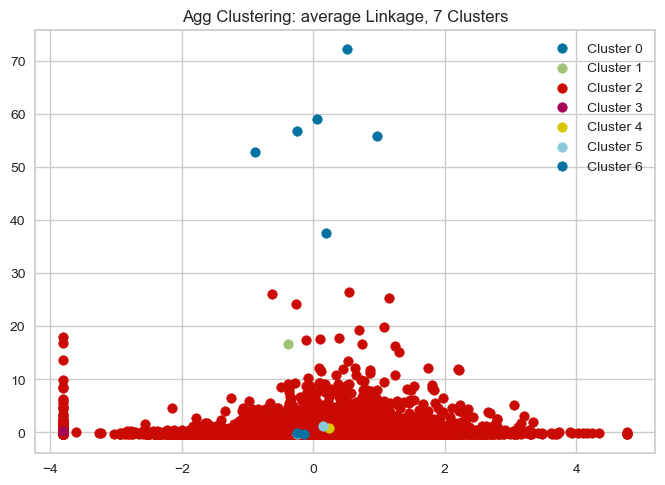

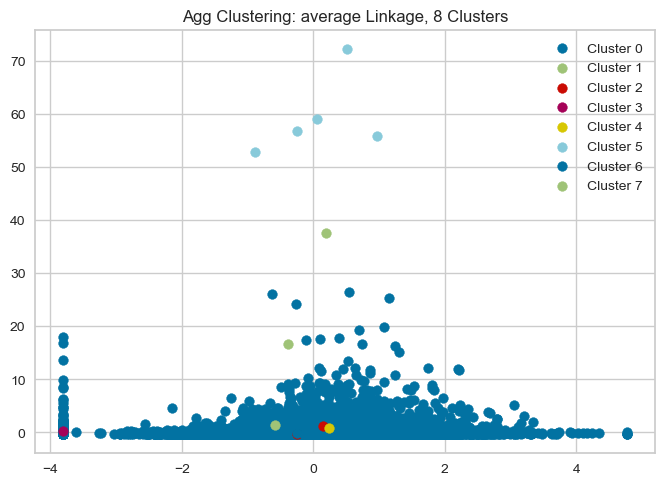

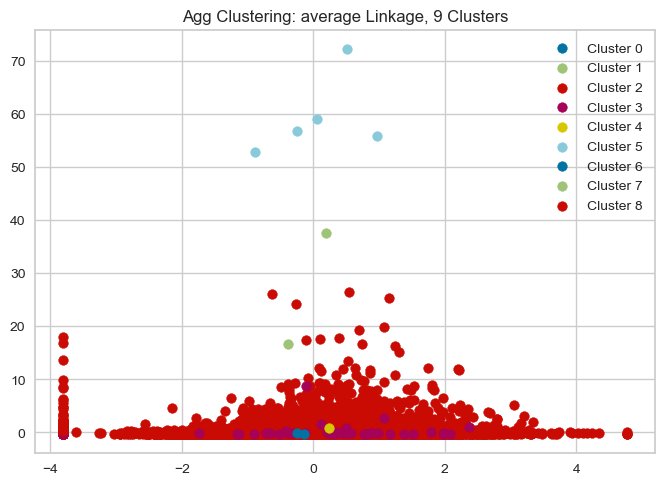

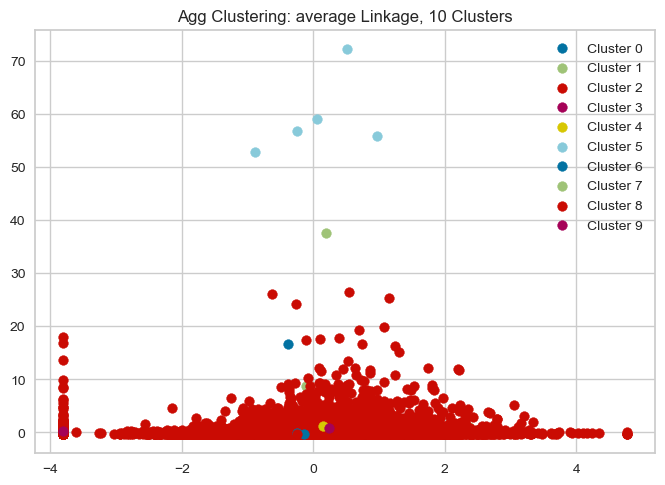

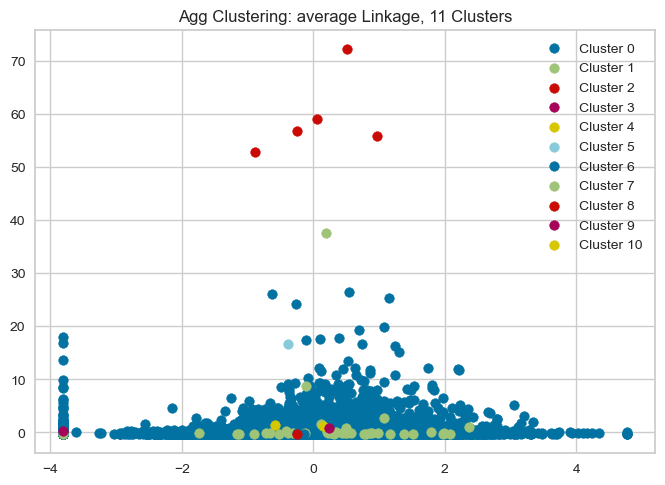

Silhouette Scores: [0.7368268149554027, 0.7367877262221442, 0.7366899855769141, 0.7265337689140468, 0.53461850132184, 0.5346060017845208, 0.5345899358148731]


In [43]:
# 15 Agglomerative Clustering with k=13 hyper-parameter tuning and silhouette scoring 

n_clusters_range = range(5, 12)

def agglomerative_silhouette(df1_std, n_clusters=n_clusters_range, linkage='ward'):
    # silhouette score recording 
    silhouette_scores = []

    for n_clusters in n_clusters_range:
        fig, ax = plt.subplots()
        agg_model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)
        
        agg_model.fit(df1_std)
        labels = agg_model.labels_
        
        clusters = np.unique(labels)
        
        # for cluster in clusters:
        #     plt.scatter(df1_std[labels == cluster, 0], df1_std[labels == cluster, 1], label=f'Cluster {cluster}')
        
        for cluster in clusters:
            plt.scatter(df1_std[labels == cluster, 17], df1_std[labels == cluster, 33], label=f'Cluster {cluster}')
            
            
        # Calculate Silhouette Score
        silhouette_scores.append(silhouette_score(df1_std, labels))
        ax.set_title(f'Agg Clustering: {linkage} Linkage, {n_clusters} Clusters')
        # ax.set_xlabel("Feature 0")
        # ax.set_ylabel("Feature 1")
        ax.legend()
        
        plt.show()

    return silhouette_scores

# To iterate over different linkages and get scores 
linkages = ["ward", "complete", "average"]
for linkage in linkages:
    scores = agglomerative_silhouette(df1_std, n_clusters=n_clusters_range, linkage=linkage)
    print(f"Silhouette Scores:", scores)

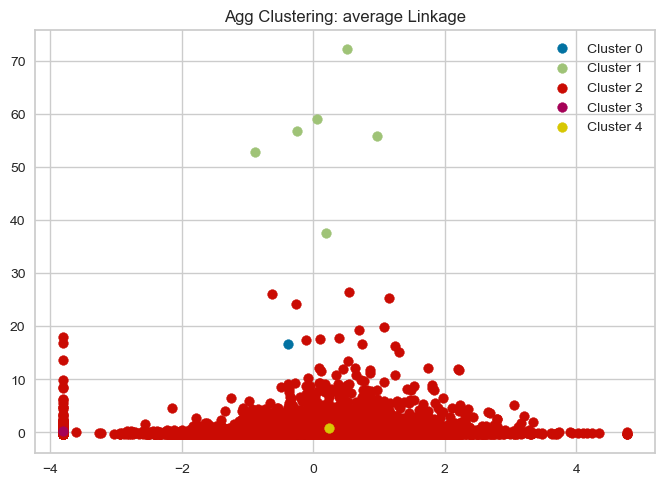

Highest Silhouette Score is 5 clusters with the average linkage method: 0.7368268149554027


In [45]:
#16 Agglomerative Clustering model optimized with 5 clusters and the average linkage method 

agg_model = AgglomerativeClustering(n_clusters=5, linkage='average')
    
    # labels = agg_model.fit_predict(df1_std)

agg_model.fit(df1_std)  # Use fit instead of fit_predict
labels = agg_model.labels_


clusters = np.unique(labels)
# Create a new figure and axis here
fig, ax = plt.subplots()

for cluster in clusters:
    plt.scatter(df1_std[labels == cluster, 17], df1_std[labels == cluster, 33], label=f'Cluster {cluster}')
    
# Calculate Silhouette Score

# ax.set_title(f'Agg Clustering: {linkage} Linkage, {metric} Metric')
ax.set_title(f'Agg Clustering: {linkage} Linkage')
# ax.set_xlabel("Feature 0")
# ax.set_ylabel("Feature 1")
ax.legend()
        
ACpltW = plt.show()
ACpltW

######################################################

# Find the highest silhouette score
highest_agg_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['Agglomerative Clustering: average linkage method'] = highest_agg_score


print("Highest Silhouette Score is 5 clusters with the average linkage method:", highest_agg_score)
#################################


# you will want to add to the dciontary as you go and then turn into a dataframe evnetually 
# Convert the dictionary to a DataFrame
# df_highest_scores = pd.DataFrame(list(highest_scores_dict.items()), columns=['Clustering Method', 'Highest Score'])

# # Print the DataFrame
# print(df_highest_scores)

     Results: The agglomerative clustering approach performed best with the highest silhouette score recorded so far with 0.0.7368268149554027 silhouette coefficient with 5 clusters using the average linkage method.  The average linkage merges the two clusters that have the smallest average distance between all their data points.

----
### DBSCAN

    Another approach to clustering explored is DBSCAN, density-based spatial clustering applications with noise. This approach does not make any assumptions about the spherical clusters unlike k-means nor does it partition the dataset into hiearchies that require manual cutoffs to determine clusters. To assign cluster labels, density based clustering makes uses the dense region of points. 

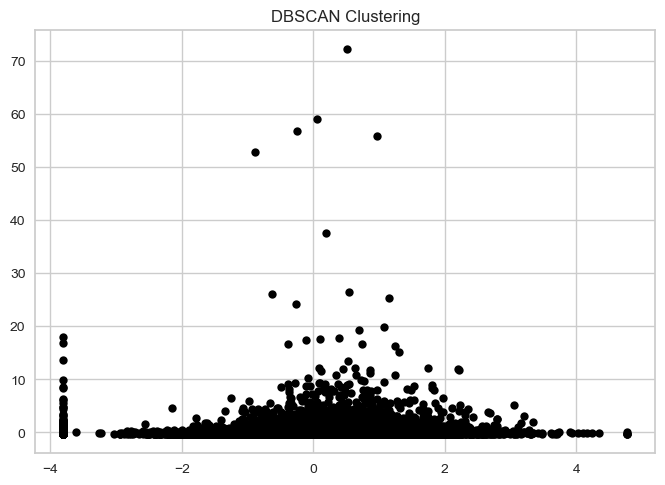

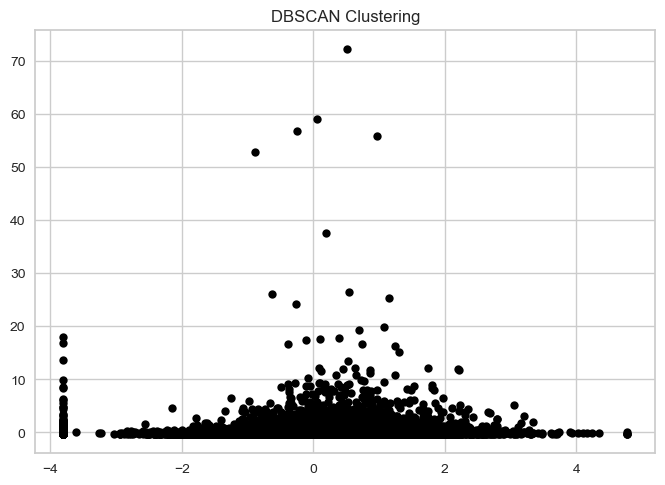

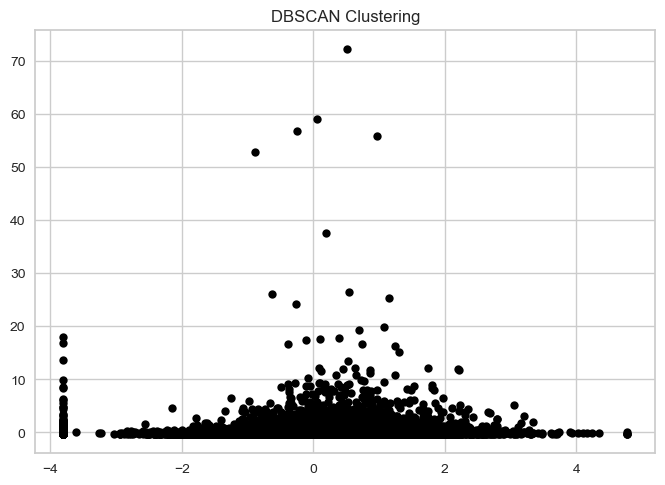

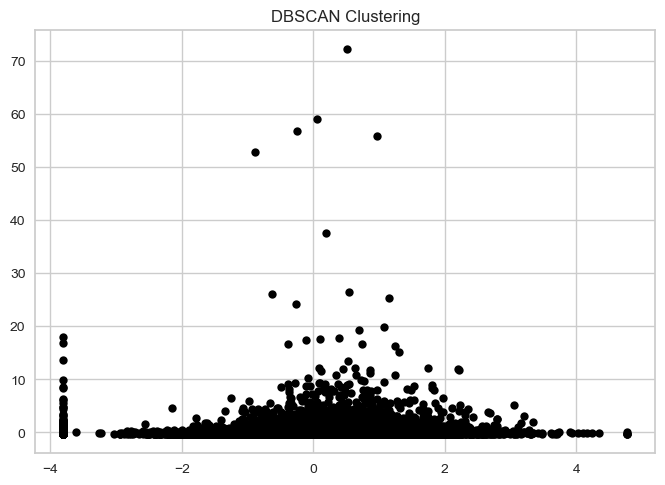

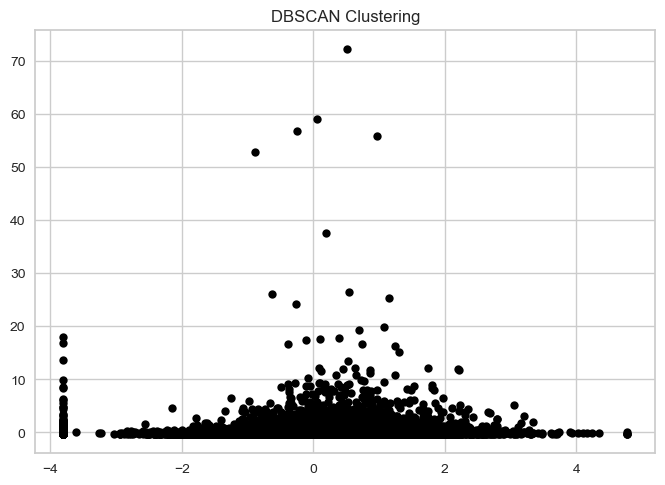

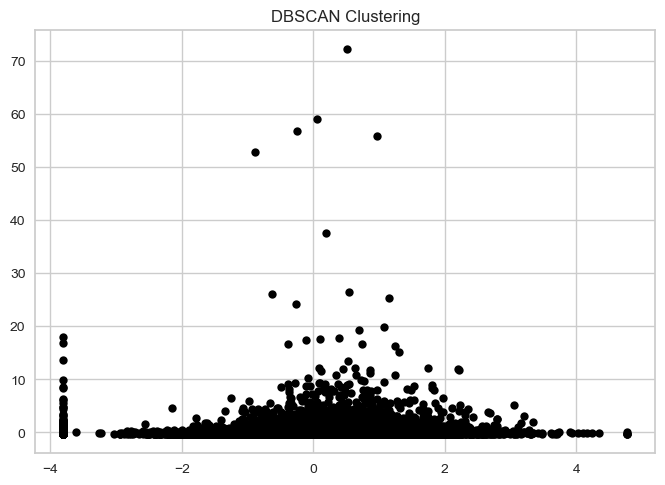

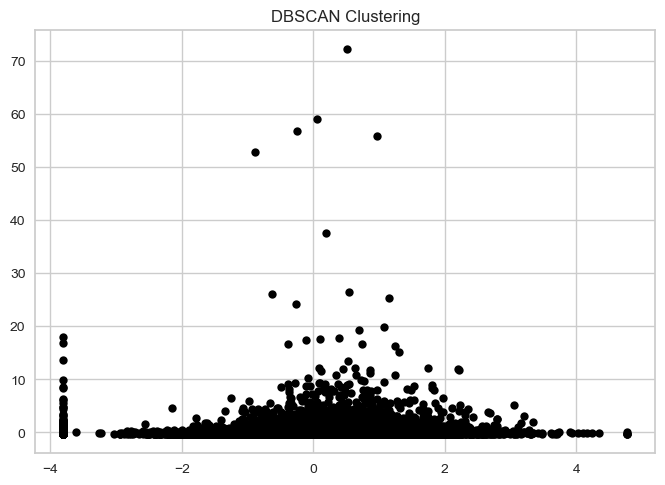

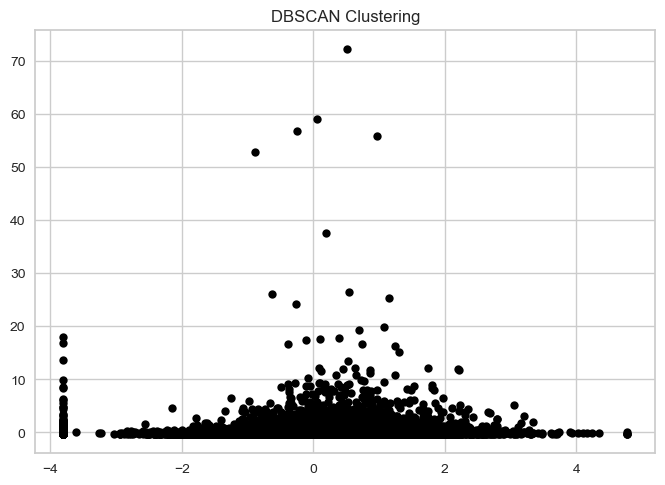

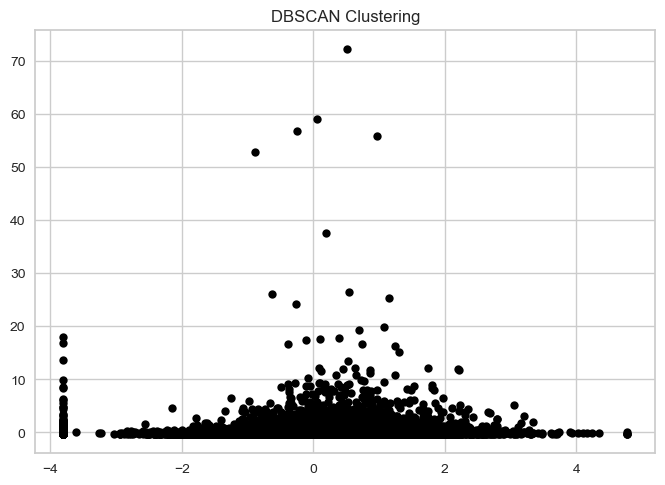

Highest Silhouette Score: 0.7368268149554027
Corresponding EPS: 0.3
Corresponding Min Samples: 5


In [48]:
eps_values = [0.3, 0.5, 0.7]
min_samples_values = [5, 10, 15]
dbscan_silhouette_scores = []

for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(df1_std)

        # Store the silhouette score for the current combination of parameters
        dbscan_silhouette_scores.append(silhouette_score(df1_std, labels))

        # Extract cluster labels and core sample indices
        cluster_labels = dbscan.labels_
        core_samples_mask = np.zeros_like(cluster_labels, dtype=bool)
        core_samples_mask[dbscan.core_sample_indices_] = True

        # Number of clusters in labels, ignoring noise if present
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)

        # Plot the clusters
        unique_labels = set(cluster_labels)
        colors = [plt.cm.Spectral(each)
                for each in np.linspace(0, 1, len(unique_labels))]
        for k, col in zip(unique_labels, colors):
            if k == -1:
                # Black used for noise.
                col = [0, 0, 0, 1]

            class_member_mask = (cluster_labels == k)

            xy = df1_std[class_member_mask & core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=14)

            xy = df1_std[class_member_mask & ~core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=6)

        plt.title('DBSCAN Clustering')
        plt.show()

# Find the highest silhouette score and corresponding parameters
highest_silhouette_score = max(dbscan_silhouette_scores)
highest_silhouette_score_index = dbscan_silhouette_scores.index(highest_silhouette_score)
best_eps = eps_values[int(highest_silhouette_score_index / len(min_samples_values))]
best_min_samples = min_samples_values[highest_silhouette_score_index % len(min_samples_values)]

print("Highest Silhouette Score:", highest_silhouette_score)
print("Corresponding EPS:", best_eps)
print("Corresponding Min Samples:", best_min_samples)


In [51]:
# Find the highest silhouette score
highest_dbscan_score = max(dbscan_silhouette_scores)
# Store the highest score in the dictionary
highest_scores_dict['DBSCAN Clustering:'] = highest_dbscan_score


print("Highest Silhouette Score for DBSCAN with eps=0.3 and min_samples=5: ", highest_dbscan_score)

Highest Silhouette Score for DBSCAN with eps=0.3 and min_samples=5:  0.7368268149554027



    DBSCAN RESULTS: The DBSCAN clustering approach performed well with the same silhouette score as the Agglomerative clustering method 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5.  

----

### FCM: Fuzzy C-Means Clustering

    Fuzzy C-Means Clustering - an extension of K-means and is also known as soft-Kmeans clustering. The name alludes to the way the algorithm allows a point to have a varying degree of membership in each cluster. This method balances the distance between the a given point and the centroid of the cluster and the degree of each membership of each point in each cluster. This makes FCM particularly useful when dealing with data points that may very well belong to more than one group simultaneously. 

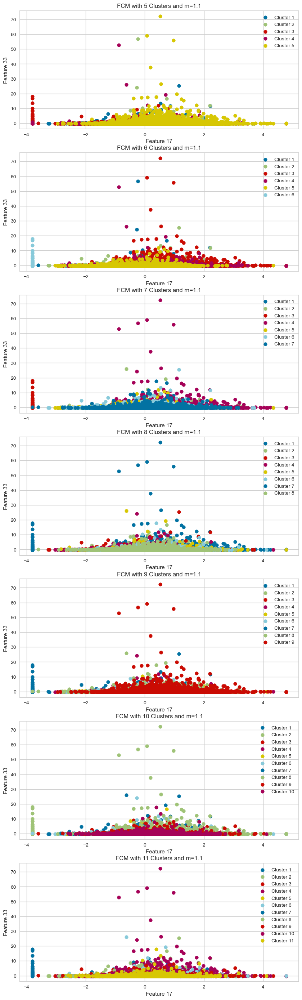

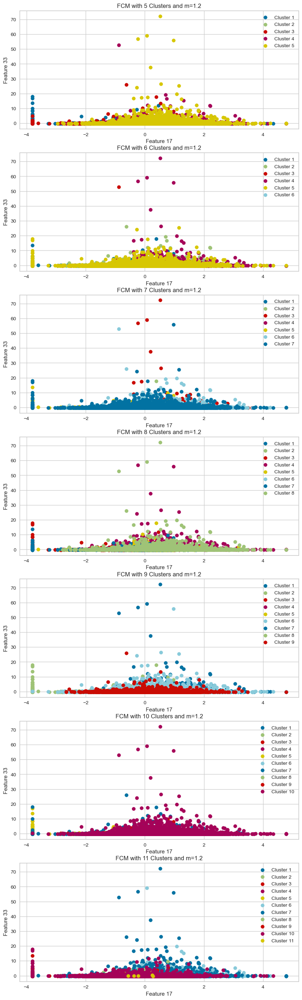

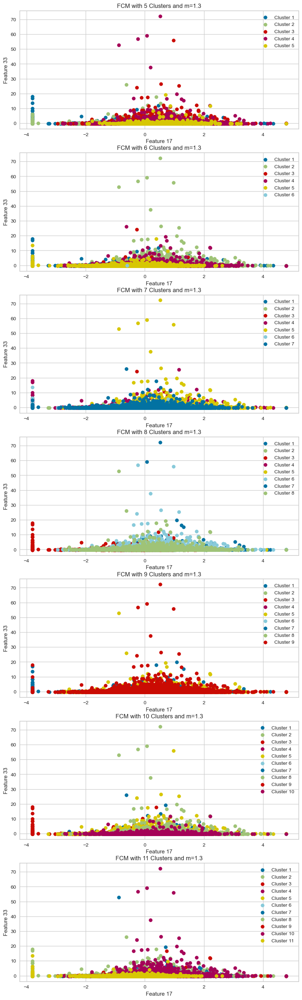

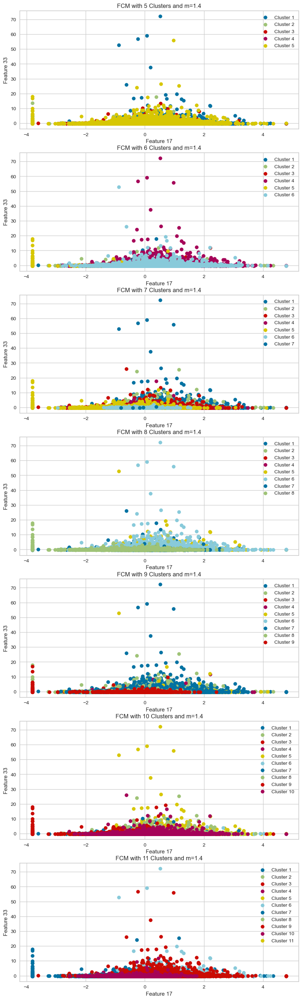

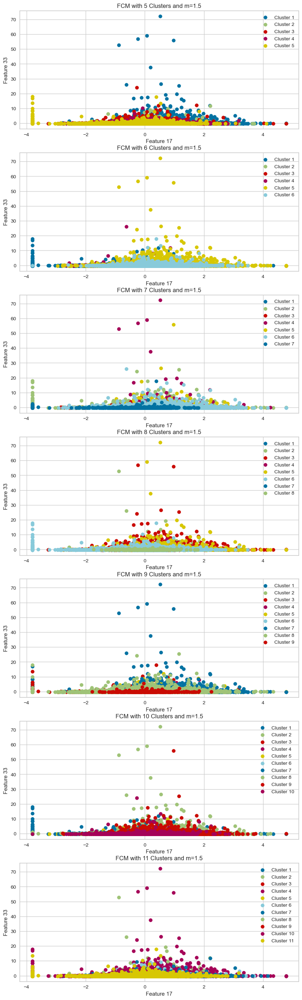

Silhouette Scores for each model: [0.06621142627190936, 0.08605466307987418, 0.0969210403769712, 0.09375251715878899, 0.10998257032043703, 0.09399287427278954, 0.07594968888463016, 0.03752521550043248, 0.02380416440437941, -0.06660324997602815, 0.032056636555328595, -0.08608185610901531, -0.06732941131329478, -0.08745026492504696, 0.029610409392202396, -0.10504819016296557, -0.024142514948105008, -0.055200853229131146, -0.0066549909444263405, -0.04304973264924695, -0.04415137507928023, -0.0464861882749714, 0.03432659204391651, -0.059890223258767715, -0.05197738379287736, -0.061243977301972646, -0.05422701793986291, -0.07111190399931382, 0.014380027882575107, 0.012266195035299946, 0.0055302734445324105, -0.05270136989799299, -0.042086306722678525, -0.02734606729886393, -0.08954067036857162]
Highest FCM Clustering Model Silhouette Score is 5 clusters an m_value of 1.2: 0.10998257032043703


In [90]:
# Fuzzy C-Means Clustering - visualize, score it (there are other scoring methods too)
# # Number of clusters

n_clusters_range = range(5, 12)
m_values = [1.1, 1.2, 1.3, 1.4, 1.5]

def fcm_silhouette(df1_std, n_clusters_range=n_clusters_range, m_values=m_values):
    # silhouette score recording
    silhouette_scores = []

    # Create separate figures and subplots for each iteration
    for m_value in m_values:
        fig, axs = plt.subplots(len(n_clusters_range), 1, figsize=(10, 5 * len(n_clusters_range)))

        for i, n_clusters in enumerate(n_clusters_range):
            ax = axs[i]
            ax.set_title(f'FCM with {n_clusters} Clusters and m={m_value}')

            cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(df1_std.T, n_clusters, m_value, error=0.005, maxiter=1000)

            # Assign each data point to the cluster with the highest membership value
            cluster_membership = np.argmax(u, axis=0)

            # Plotting the results
            for j in range(n_clusters):
                ax.scatter(df1_std[cluster_membership == j, 17], df1_std[cluster_membership == j, 33], label=f'Cluster {j + 1}', marker='o')

            ax.legend()
            # ax.set_xlabel('Feature 17')
            # ax.set_ylabel('Feature 33')

            # Calculate Silhouette Score
            silhouette_scores.append(silhouette_score(df1_std, cluster_membership))

        plt.show()  # Display the plot after each iteration

    return silhouette_scores

# Assuming you have 'df1_std' defined
scores = fcm_silhouette(df1_std)

print("Silhouette Scores for each model:", scores)
# 19 FCM Optimized model with highest silhouette score 

######################################################

# Find the highest silhouette score
highest_fcm_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['FCM Clustering:'] = highest_fcm_score


print("Highest FCM Clustering Model Silhouette Score is 5 clusters an m_value of 1.2:", highest_fcm_score)
#################################

    FCM and K-means in practice typically produce  very similar results in practice but given FCM's leniency  towards clustering data points it outperformed the best K-means++ model we created earlier. 

    FCM Clustering Results: The FCM clustering method produced a silhouette score of 0.10301753918726955 with 10 clusters and m_value of 1.1. 


----

### Gaussian Mixture Model

    GMM - A Gaussian Mixture Model is a another method that will try to find a mix of multi-dimensional Gaussian probability distributions that best model any feature in the dataset. 

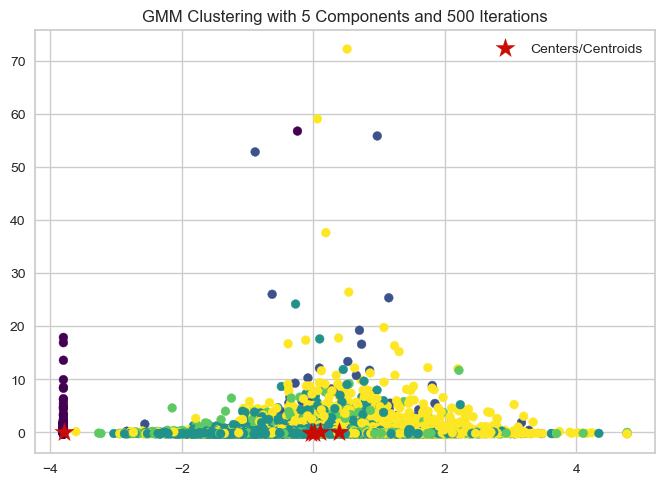

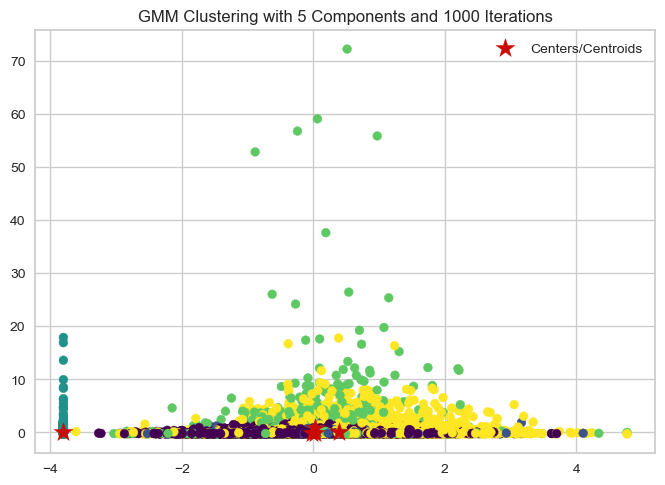

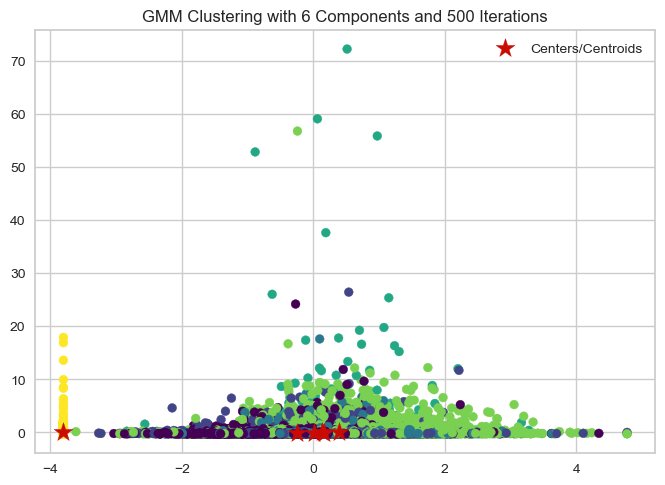

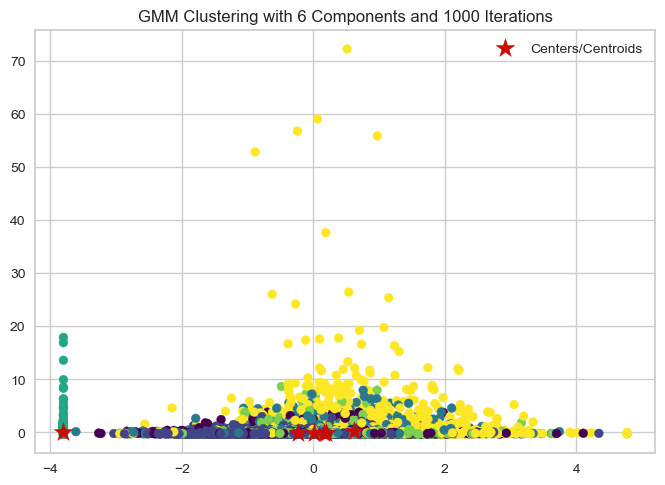

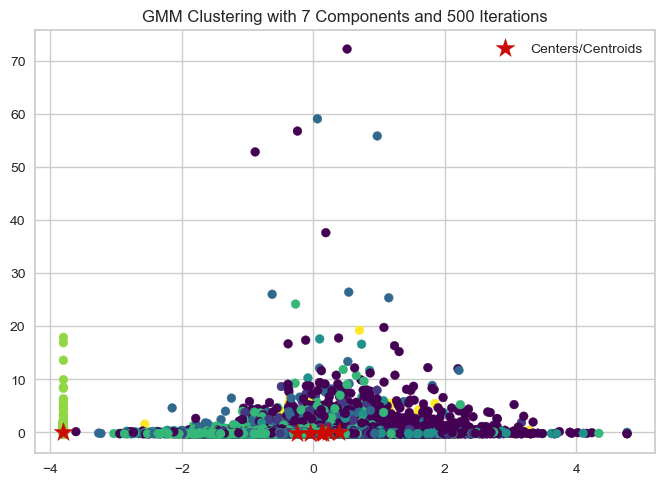

...

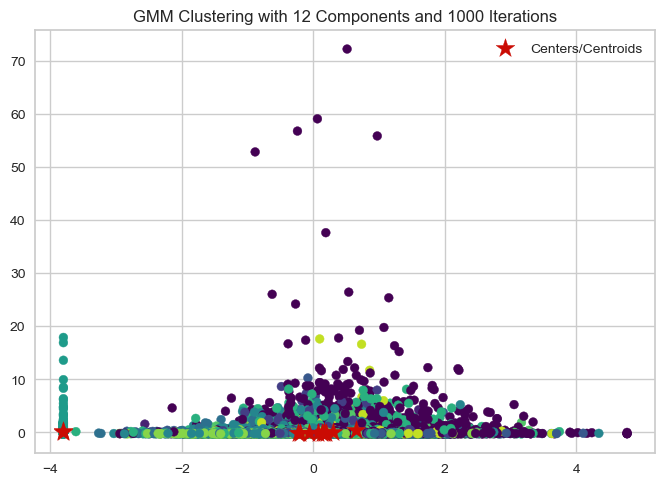

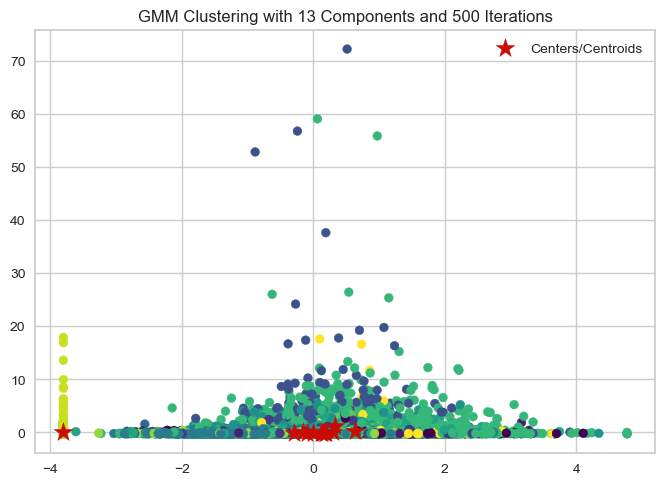

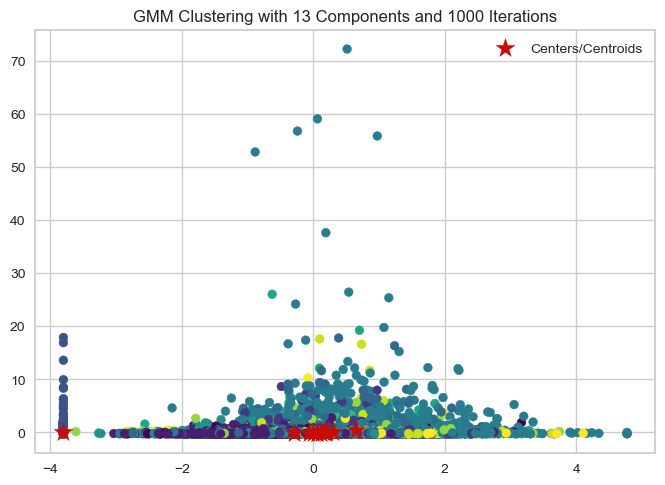

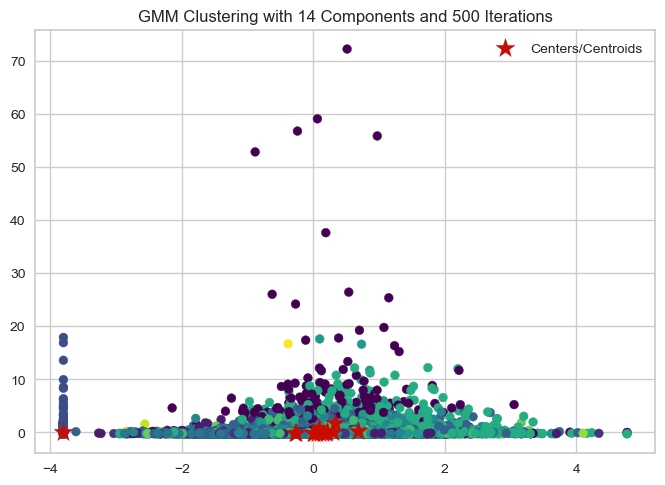

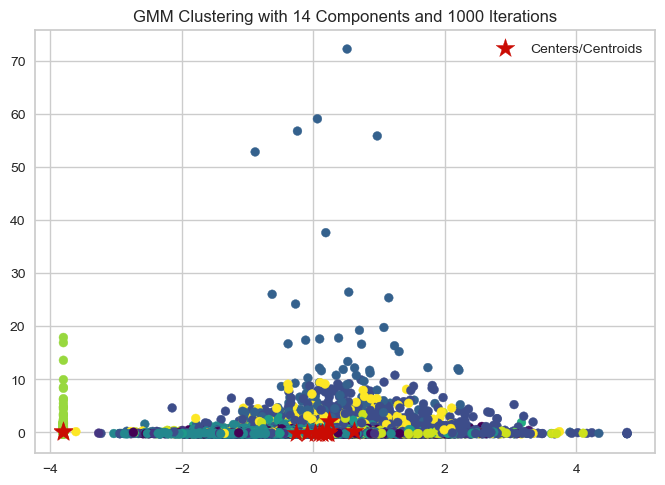

Silhouette Scores for each model: [0.07886355467281056, 0.07489264229604359, 0.08751497998019155, 0.09443140935068835, 0.09040320323708692, 0.07478254279785432, 0.09592962119394689, 0.08817062360849973, 0.09788580349008111, 0.09364093848959887, 0.09359663904468554, 0.07619095976599206, 0.10731105780431043, 0.09475024593506572, 0.08582367567214814, 0.07302661674389882, 0.0849752997009037, 0.10210504165855623, 0.08632111932854583, 0.06661342230015913]


In [53]:
#20 GMM optimized model / silhouette scoring 

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_silhouette(df1_std, n_components_range, max_iters):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Predict cluster labels
            labels = gmm.predict(df1_std)

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot

    return silhouette_scores

########
# Assuming you have 'df1_std' defined
scores = gmm_silhouette(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("Silhouette Scores for each model:", scores)

In [54]:
# 21 GMM record the highest silhouette score

######################################################

# Find the highest silhouette score
highest_gmm_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['GMM Clustering:'] = highest_gmm_score


print("Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations", highest_gmm_score)

Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations 0.10731105780431043


    GMM Clustering (Silhouette Score) Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.107311.

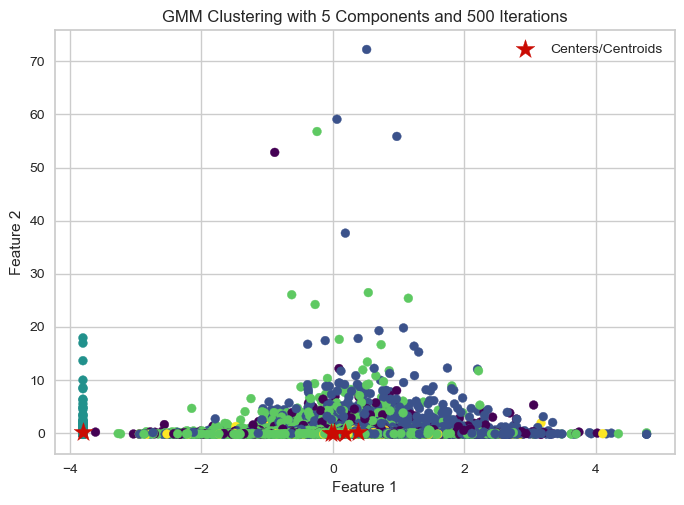

BIC Scores for each model: -678074.3237991988


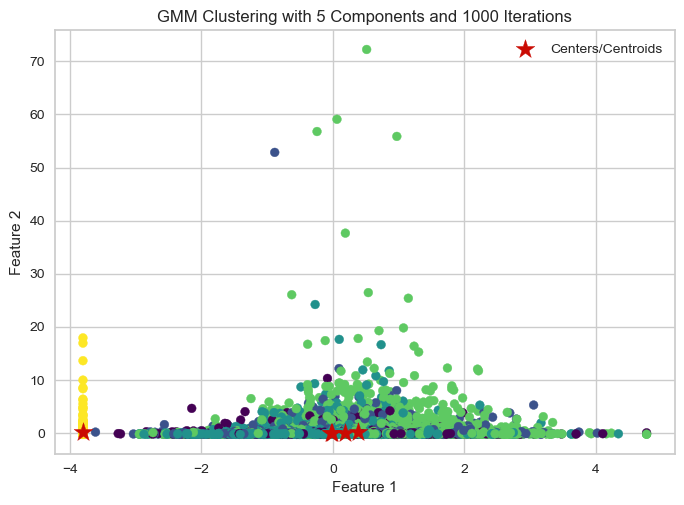

BIC Scores for each model: -1318868.4421410374


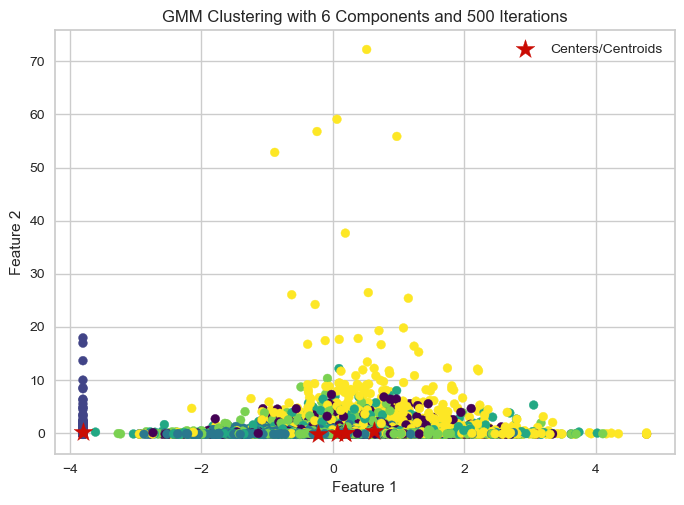

BIC Scores for each model: -1381493.4141876507


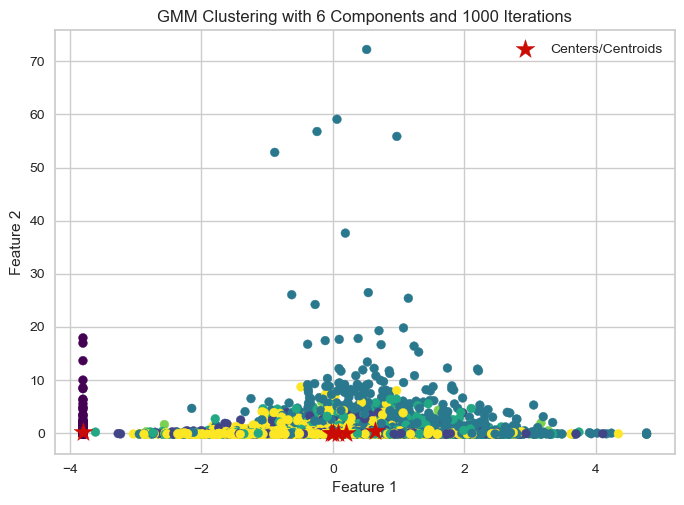

BIC Scores for each model: -793438.3142652268


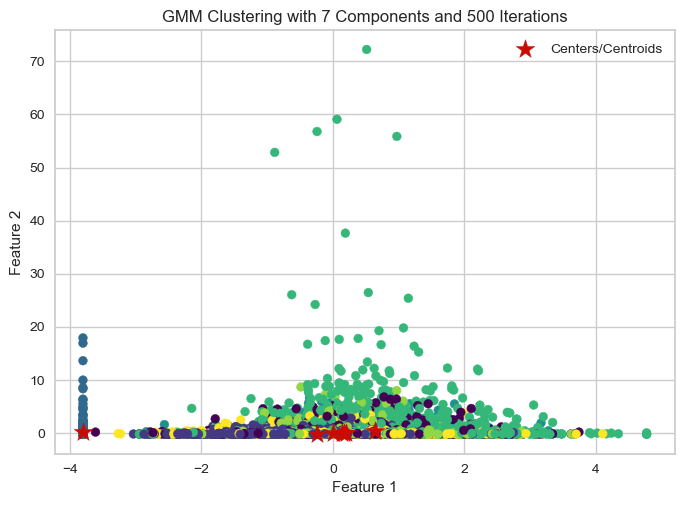

BIC Scores for each model: -1023711.9945862633


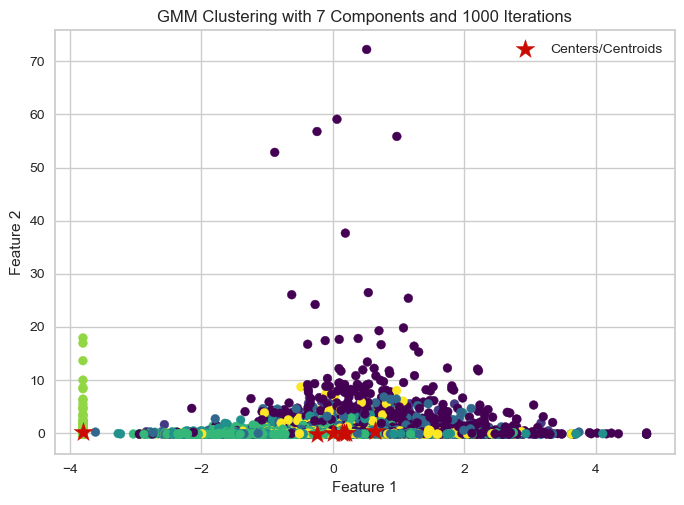

BIC Scores for each model: -1023711.9952659474


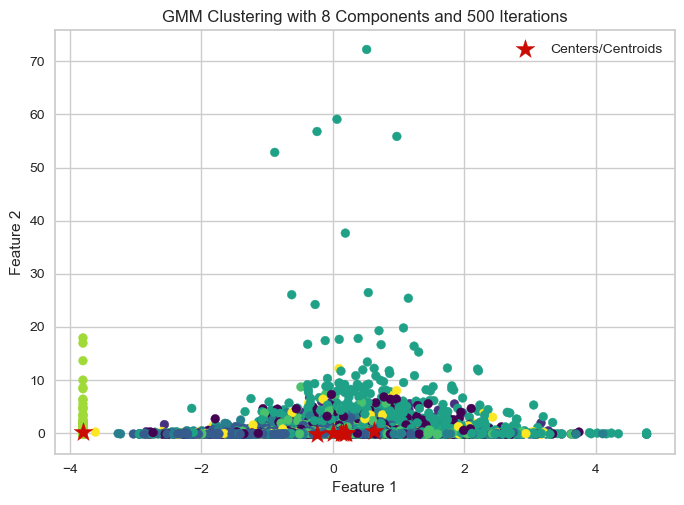

BIC Scores for each model: -1495620.0266078296


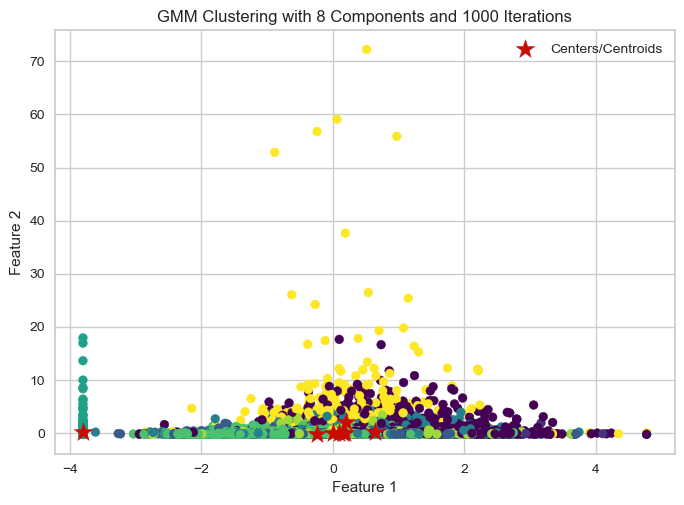

BIC Scores for each model: -1425521.7160921746


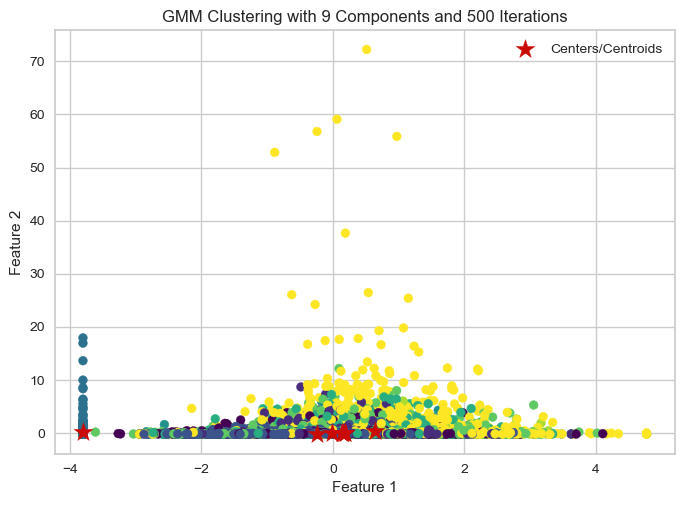

BIC Scores for each model: -1835538.948323706


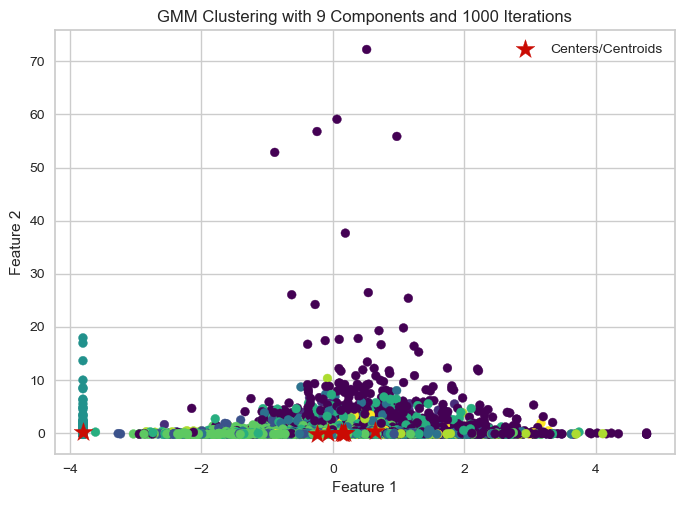

BIC Scores for each model: -1229944.7544549177


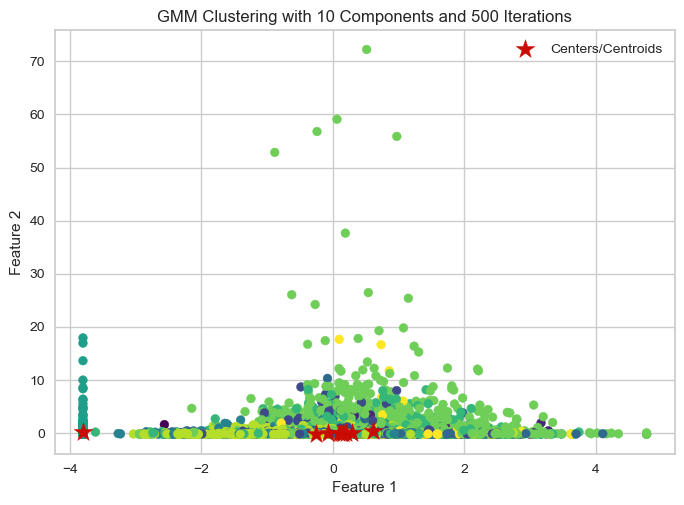

BIC Scores for each model: -1397638.5634373208


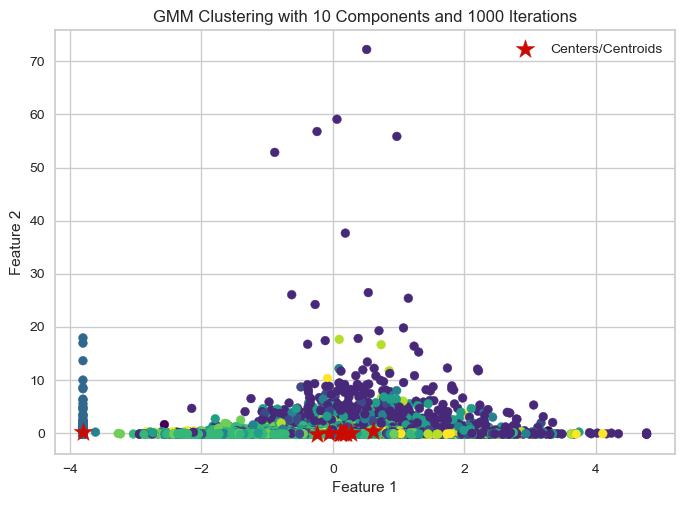

BIC Scores for each model: -1856311.1704409528


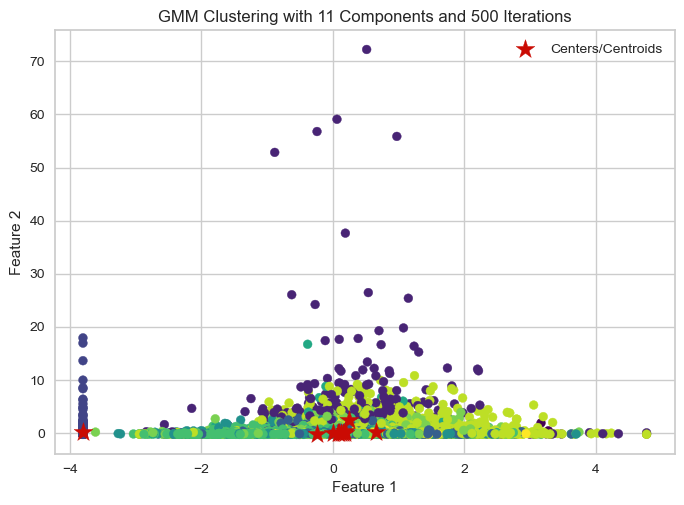

BIC Scores for each model: -1623611.877020332


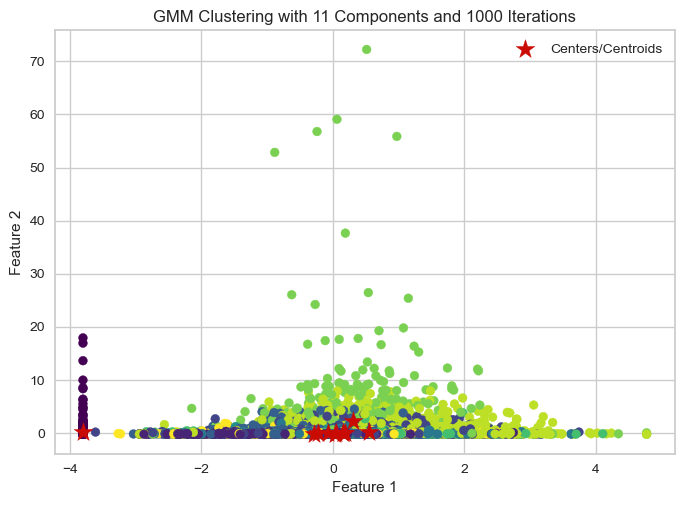

BIC Scores for each model: -1634609.2664028944


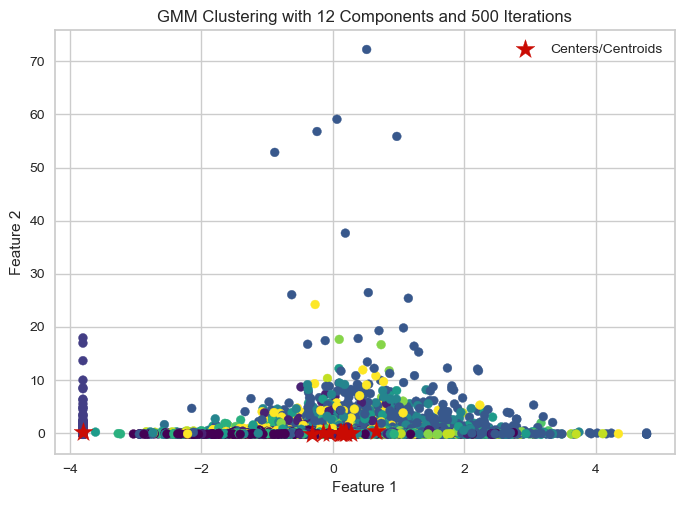

BIC Scores for each model: -2095387.4097264218


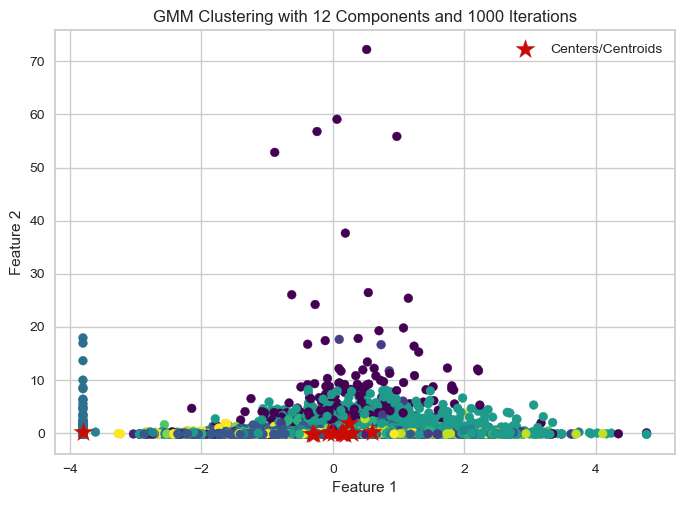

BIC Scores for each model: -1822986.998246796


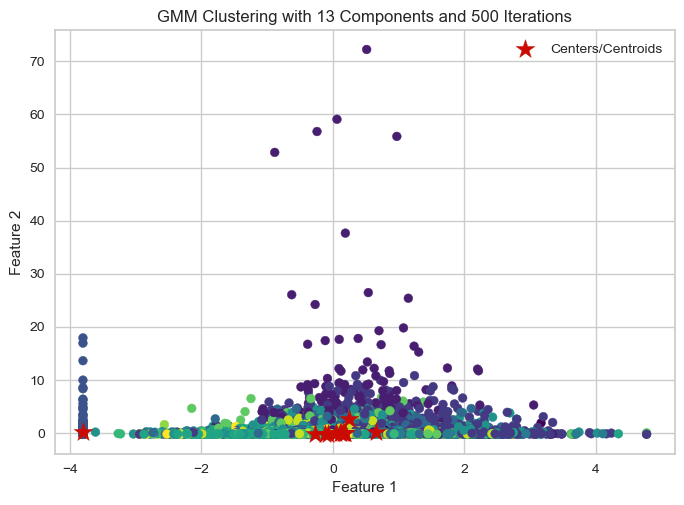

BIC Scores for each model: -2574851.5454009706


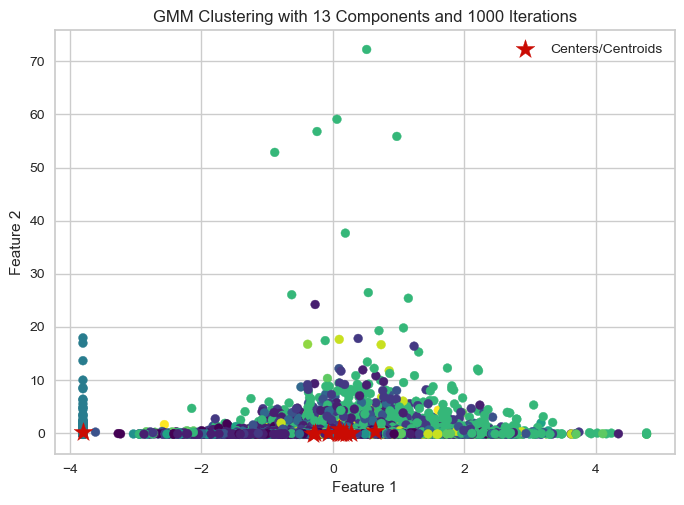

BIC Scores for each model: -2129723.081433947


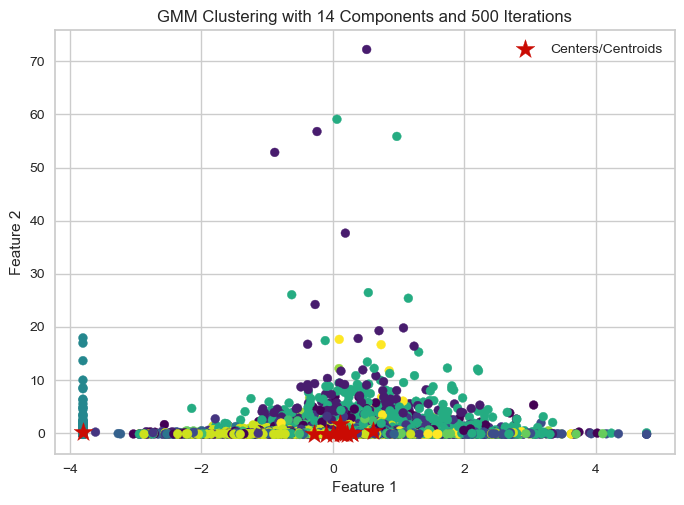

BIC Scores for each model: -2350238.574575341


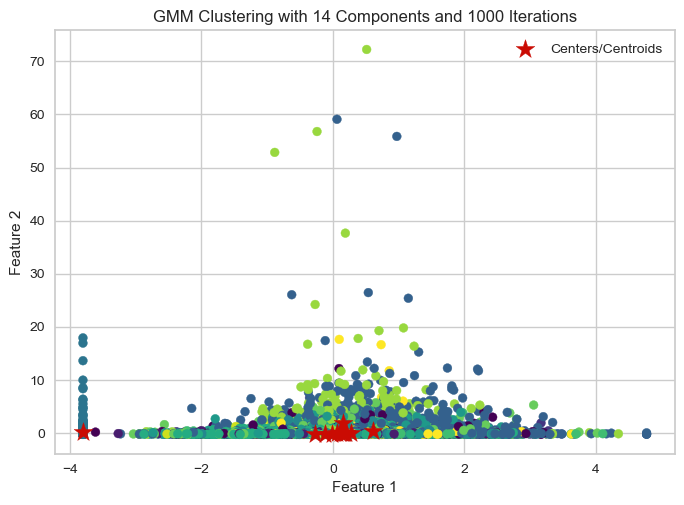

BIC Scores for each model: -2653007.6839213474
BIC Scores for each model: [-678074.3237991988, -1318868.4421410374, -1381493.4141876507, -793438.3142652268, -1023711.9945862633, -1023711.9952659474, -1495620.0266078296, -1425521.7160921746, -1835538.948323706, -1229944.7544549177, -1397638.5634373208, -1856311.1704409528, -1623611.877020332, -1634609.2664028944, -2095387.4097264218, -1822986.998246796, -2574851.5454009706, -2129723.081433947, -2350238.574575341, -2653007.6839213474]


In [55]:
# 22 GMM model BIC score 

from sklearn.mixture import GaussianMixture

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_bic(df1_std, n_components_range, max_iters):
    # BIC score recording
    bic_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Calculate BIC score
            bic_score = gmm.bic(df1_std)
            bic_scores.append(bic_score)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=gmm.predict(df1_std), s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            plt.xlabel('Feature 1')
            plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot
            print("BIC Scores for each model:", bic_score)
    return bic_scores

# Assuming you have 'df1_std' defined
bic_scores = gmm_bic(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("BIC Scores for each model:", bic_scores)

In [58]:
# 23 GMM record the highest silhouette score


######################################################

# Find the highest silhouette score
lowest_gmm_BICscore = min(bic_scores)

print("Lowest GMM Clustering Model BIC score with 14 components and 1000 iterations", lowest_gmm_BICscore)

Lowest GMM Clustering Model BIC score with 14 components and 1000 iterations -2653007.6839213474


    Results: The GMM model produced an optimized model with 14 clusters and max iterations of 1000 and produced a BIC score of -2653007.6839213474. The lower a BIC score the better; what makes the results curious is that the BIC score suggested different number of clusters compared to that of the silhouette score from the GMM model earlier. 

    Getting the BIC score was simply an exercise and for analysis purposes we'll discount these results and instead lean on the silhouette score as our evaluation method given that the other models are using this metric to assess performance. 

----
### OPTICS Clustering

    OPTICS Clustering -- Ordering Points To Identify Clustering Structure a density based unsupervised learning algorithm similar to DBSCAN. OPTICS unlike DBSCAN deos not require the density to be consistent across a dataset, so for OPTICS we can discard eps (constant distance parameter).


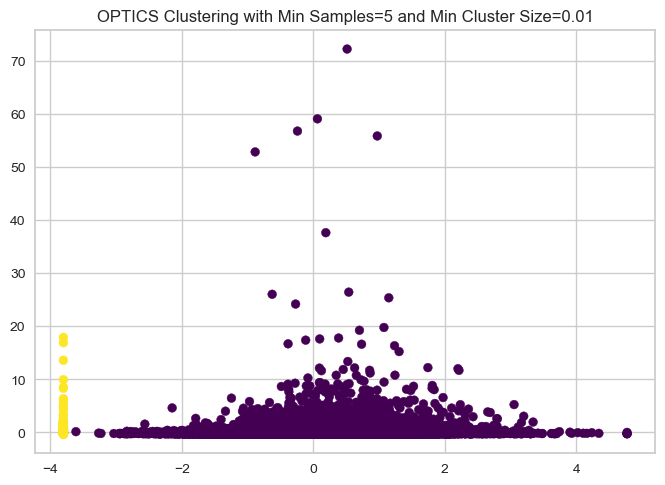

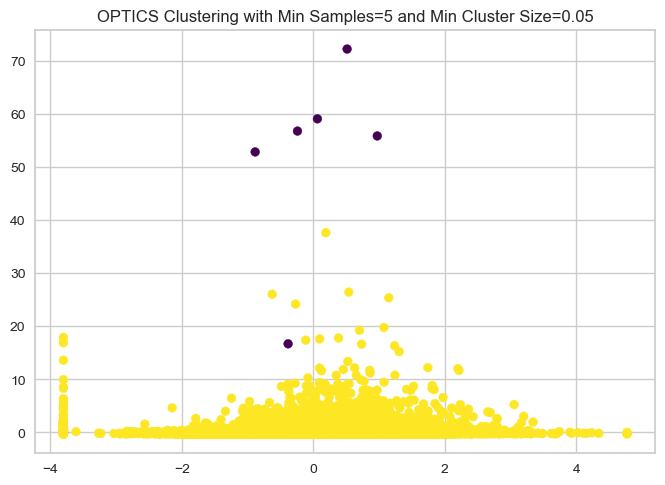

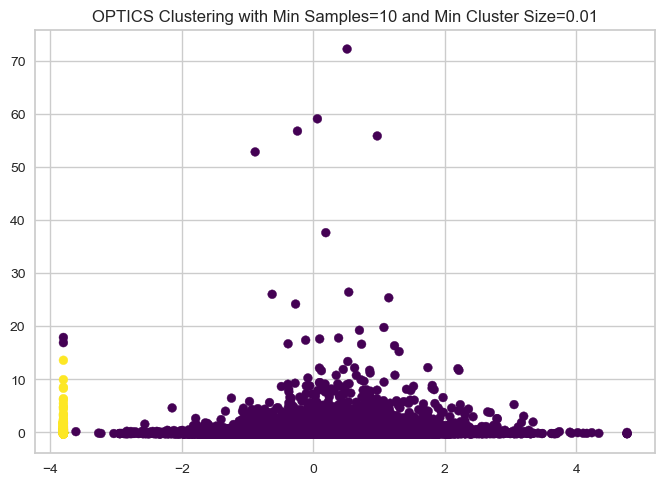

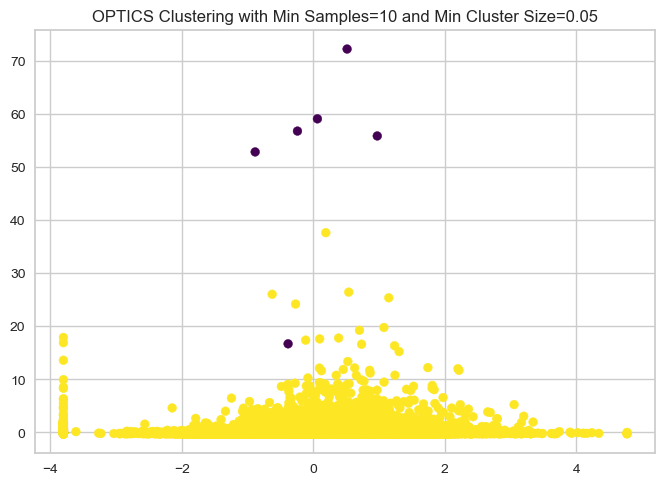

Silhouette Scores for each model: [0.34998401805977897, 0.6145937682246868, 0.34941581095555113, 0.6145937682246868]


In [57]:
# 24 Optics clustering model optimization and silhouette scoring 

# min_samples: This parameter defines the minimum number of samples in a neighborhood for a data point to be considered a core point. Core points are the ones that have at least min_samples data points within their neighborhood.

# min_cluster_size: This parameter sets the minimum number of samples required for a set of data points to be considered a cluster. It influences the granularity of the clustering by specifying how many points need to be close to each other to form a meaningful cluster.

# min_samples_values = [5, 10, 15, 20, 25]
# min_cluster_size_values = [0.01, 0.05, 0.1, 0.2, 0.3]
min_samples_values = [5, 10]
min_cluster_size_values = [0.01, 0.05]

def optics_silhouette(df1_std, min_samples_values, min_cluster_size_values):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different min_samples and min_cluster_size values
    for min_samples_value in min_samples_values:
        for min_cluster_size_value in min_cluster_size_values:
            
            # Fit the OPTICS model
            clustering = OPTICS(min_samples=min_samples_value, min_cluster_size=min_cluster_size_value)
            clustering.fit(df1_std)
            
            # Extract the clusters
            labels = clustering.labels_

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)
            plt.title(f"OPTICS Clustering with Min Samples={min_samples_value} and Min Cluster Size={min_cluster_size_value}")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.show()  # Display the plot

    return silhouette_scores

# Assuming you have 'df1_std' defined
scores = optics_silhouette(df1_std, min_samples_values, min_cluster_size_values)

print("Silhouette Scores for each model:", scores)

In [60]:
# 25 Optics record the highest silhouette score

######################################################

# Find the highest silhouette score
optics_highest_sil_score = max(scores)
# Store the highest score in the dictionary
highest_scores_dict['Optics Clustering :'] = optics_highest_sil_score


print("Highest OPTICS Clustering Model silhouette score with 5-10 min_samples and cluster size 0.5 components", optics_highest_sil_score)

Highest OPTICS Clustering Model silhouette score with 5-10 min_samples and cluster size 0.5 components 0.6145937682246868


    OPTICS Clustering Results: The OPTICS clustering model produced an optimized model with 5-10 min_samples and cluster size 0.5 components with a silhouette score of 0.6145937682246868. This represents our second best performing model. 

In [61]:
# 26 Print Results table 

df_highest_scores = pd.DataFrame(list(highest_scores_dict.items()), columns=['Clustering Method', 'Score'])
df_highest_scores = df_highest_scores.sort_values(by='Score', ascending=False)

# Set the option to display all rows, columns, and prevent truncation of column content
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

# Print the DataFrame
print(df_highest_scores)

# Reset the options to default (optional)
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.max_colwidth')

                                  Clustering Method     Score
2  Agglomerative Clustering: average linkage method  0.736827
3                                DBSCAN Clustering:  0.736827
6                               Optics Clustering :  0.614594
5                                   GMM Clustering:  0.107311
4                                   FCM Clustering:  0.103018
0                                          Kmeans++  0.098065
1        Hierarchal Clustering: ward linkage method  0.059317


    Here we have our trained models with the highest silhouette coefficients. The Agglomerative and DBSCAN clustering methods performed best as it had a coefficient closest to 1. If you'll the table notes one *BIC SCORE* did check the BIC score for the GMM model only as it is often as metric to assess GMM models, however the silhouette score was the chosen metric to evaluate all models evaluated. 

    Comprehensive Results: 
        Agglomeratiuve Clustering: complete average linkage method silhouette score 0.736827.
        DBSCAN Clustering: With an eps=0.3 and min_samples=5 silhouette score 0.736827.

    Why: 
        Agglomerative and DBSCAN performed best and there are few possible reasons why these methods worked best for this particular datset. Both methods can effectively identify non-spherical clusters and given each clustering methods unique way of adapting to cluster shapes is most likely the reason why they yielded the highest silhouette scores close to 1. Another reason why these clustering methods performed well compared to the other methods is that each both agglomerative and DBSCAN clustering methods method are robust to outliers. Agglomerative is able to merge outliers based on their linkage distance while DBSCAN has a high tolerance for sparse regions and consequently effective at dealing with outliers. 




___
___
<a href="#top">Back to Top</a>
<a id="ModelEval2"></a>
## Modeling and Evaluation 2 (10 points total)
Evaluate and Compare

----

### KMeans++


    To further evaluate each clustering method to judge the performance and quality of clustering is the silhouette analysis. We can plot the analysis to judge how tight the datapoints are grouped together in clusters. 



/Users/tmc/opt/anaconda3/envs/PythonData/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster memberships:
[2 2 2 ... 3 5 1]


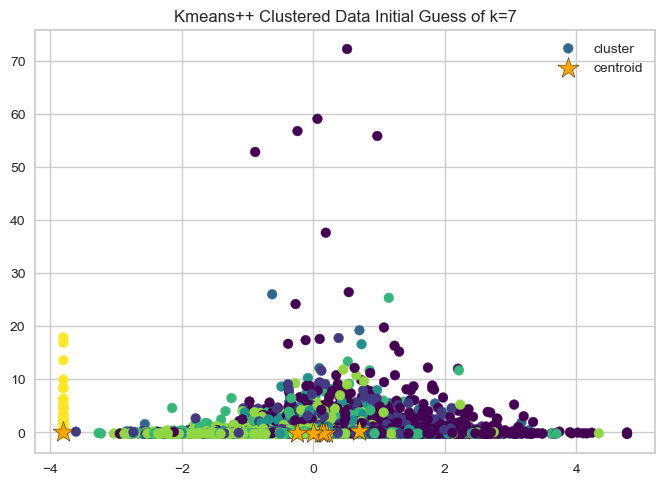

In [74]:
# 10 K-means++ Optimized Model for our given dataset from Mashable

kmeans = KMeans(init='k-means++', n_clusters=7, max_iter=300, random_state=0).fit(df1_std)

print("Cluster memberships:\n{}".format(kmeans.labels_))

####
# plt.scatter(df1_std[:, 0], df1_std[:, 1], c=kmeans.labels_, cmap='viridis')
# plt.scatter(kmeans.cluster_centers_[:, 0],kmeans.cluster_centers_[:, 1], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')
####
plt.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, cmap='viridis')
plt.scatter(kmeans.cluster_centers_[:, 17],kmeans.cluster_centers_[:, 33], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')

plt.legend(["cluster", "centroid"], loc='best')
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
plt.title('Kmeans++ Clustered Data Initial Guess of k=7')
Kplt_kmeans_optimized = plt.show()
Kplt_kmeans_optimized

In [32]:
# Original #18

#28

cluster_labels = np.unique(y_km)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(df1_std, y_km, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

# for i, c in enumerate(cluster_labels):
#     c_silhouette_vals = silhouette_vals[y_km == c]
#     c_silhouette_vals.sort()
#     y_ax_upper += len(c_silhouette_vals)
#     color = cm.jet(float(i) / n_clusters)
#     plt.barh(range(y_ax_lower, y_ax_upper),c_silhouette_vals,height=1.0, edgecolor='none', color=color)
#     yticks.append((y_ax_lower + y_ax_upper) / 2.)
#     y_ax_lower += len(c_silhouette_vals)

# plt.xlabel('Silhouette coefficient')
# plt.ylabel('Cluster')

# silhouette_avg = np.mean(silhouette_vals)
# plt.axvline(silhouette_avg, color="red", linestyle="--")
# plt.yticks(yticks, cluster_labels+1)
# plt.tight_layout()
# plt.show()

labels = kmeans.labels_

# The silhouette score measures the cohesion within clusters and the separation between clusters. It ranges from -1 to 1, with a higher score indicating a better model. 
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(df1_std, labels))

Silhouette Coefficient: 0.098


    The average silhouette coefficient is indicated by the red dotted line. The red clustering (Cluster 7) performed best (above average) which indicates it is relatively well-separated and cohesive thus the data points more similar to each other than they are to data points in neighboring clusters. The resulting plot shows that overall the silhouettes are visibly different lengths and widths which is indicative of sub-optimal clustering. We also have clusters that go below zero indicating that these clusters were on a decision boundary and struggled to cluster the points. 

    Ideally we would want the silhouette coefficient should be closer to 1 to indicate better quality of clustering. 

______
### Hierarchical Clustering 

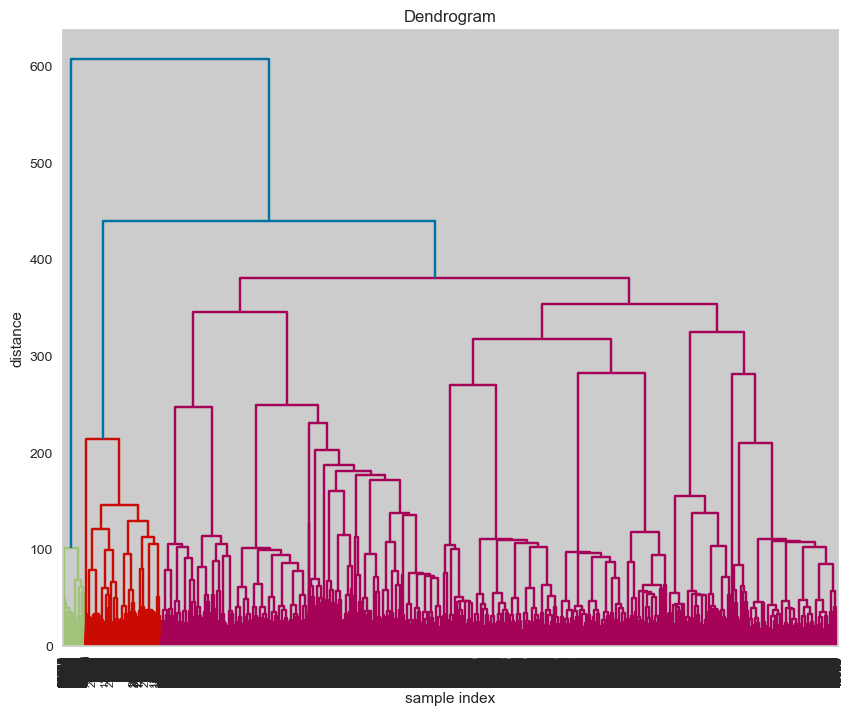

With 5 clusters, the silhouette score is 0.04719703051522329
With 6 clusters, the silhouette score is 0.0593168231401565
With 7 clusters, the silhouette score is 0.053060313773702135
With 8 clusters, the silhouette score is 0.058768950894333184
With 9 clusters, the silhouette score is 0.057757778061823424


In [71]:
# 14 Score the different number of cluster cuts on Dendrogram 

# Assign linkage

linkage_matrix = linkage(df1_std, method='ward')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")


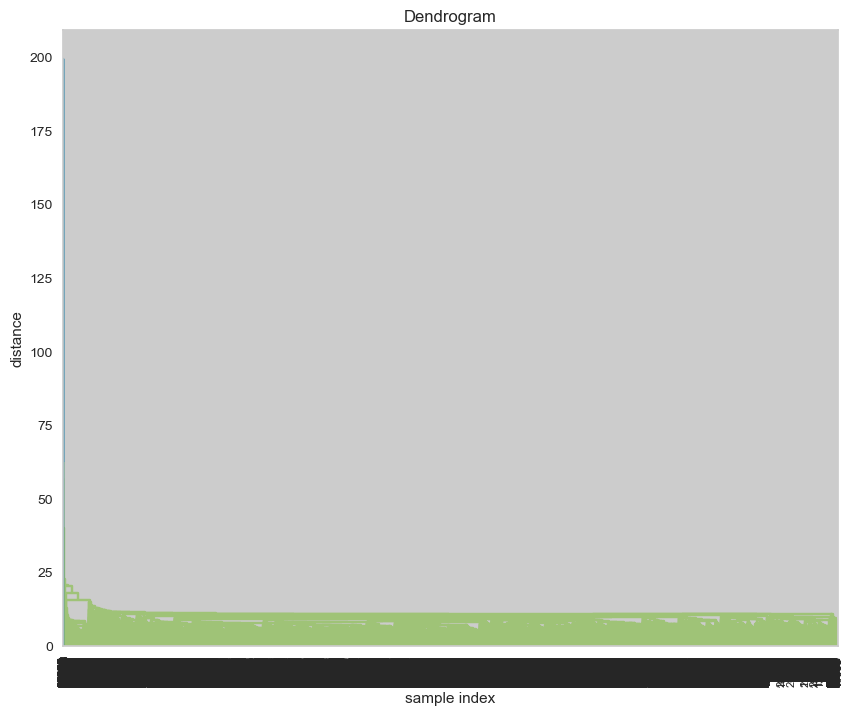

With 5 clusters, the silhouette score is 0.7368268149554027
With 6 clusters, the silhouette score is 0.7367877262221442
With 7 clusters, the silhouette score is 0.7366899855769141
With 8 clusters, the silhouette score is 0.7265337689140468
With 9 clusters, the silhouette score is 0.53461850132184


In [164]:
# Silhoutte Analysis - linkage average

# Score the different number of cluster cuts on Dendrogram 

# Assign linkage ward

linkage_matrix = linkage(df1_std, method='average')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")
# Agglomerative Clustering using 'ward' method
# ACDpltW

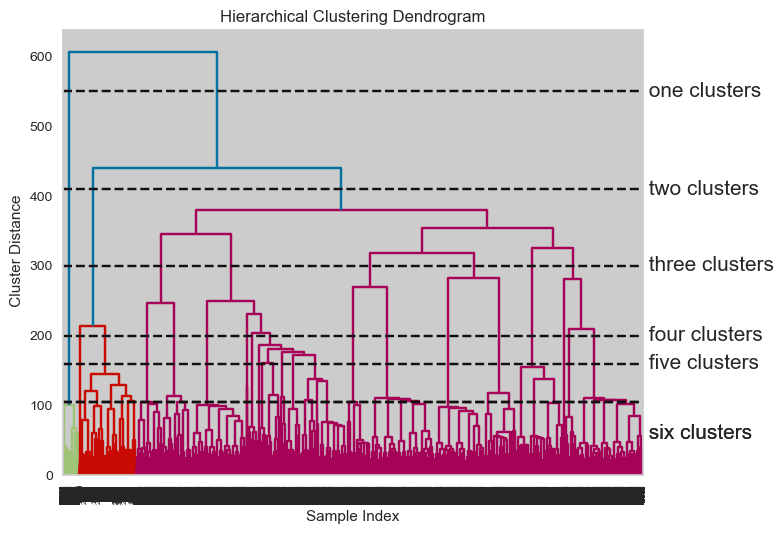

In [70]:
# 13 Hierarchal Clustering Method=ward

# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='ward')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()

ax.plot(bounds, [550, 550], '--', c='k')
ax.text(bounds[1], 550, ' one clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [410, 410], '--', c='k')
ax.text(bounds[1], 410, ' two clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [300, 300], '--', c='k')
ax.text(bounds[1], 300, ' three clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [200, 200], '--', c='k')
ax.text(bounds[1], 200, ' four clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [160, 160], '--', c='k')
ax.text(bounds[1], 160, ' five clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
ACDpltW= plt.show()
ACDpltW

In [72]:
##################################

# Find the highest silhouette score
highest_linkage_score = max(scores)

print("Highest Silhouette Score is 6 components with the Ward linkage method:", highest_linkage_score)


Highest Silhouette Score is 6 components with the Ward linkage method: 0.0593168231401565


    Hierarchal Clustering Results: The approach with 6 clusters and the ward linkage optimization method performed best with a silhouette coefficient 0.059. Earlier in our code we explored the average linkage method that produced a very high silohouette score  with 5 clusters and a silhouette coefficient 0.7368268149554027. However we discounted the average linkage method was simply clustering most data points into single large cluster and produced an uintelligable dendrogram. 

    Overall the best method in our judgement is most likely the ward method as it was able to produce a clearer dendrogram despite despite its lower silohouette score.

----
### Agglomorative Clustering

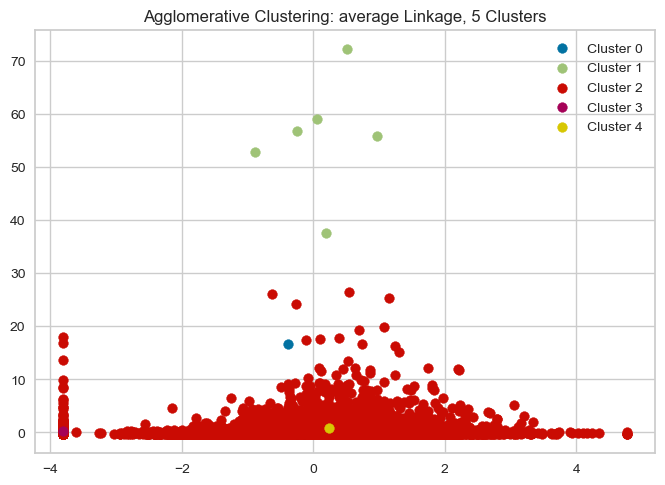

Highest Silhouette Score for average Linkage: 0.7368268149554027


In [82]:
def agglomerative_silhouette(df, n_clusters, linkage='average'):
    # Initialize empty lists to store silhouette scores and clusters
    silhouette_scores = []
    clusters = []

    # Create an AgglomerativeClustering instance with the specified parameters
    agg_model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)

    # Fit the model to the data
    agg_model.fit(df)

    # Extract cluster labels
    labels = agg_model.labels_

    # Append the current cluster information to the list
    clusters.append(labels)

    # Calculate Silhouette Score
    silhouette_score_current = silhouette_score(df, labels)
    silhouette_scores.append(silhouette_score_current)

    # Create a scatter plot for the current clustering
    plt.figure()
    for cluster in np.unique(labels):
        plt.scatter(df[labels == cluster, 17], df[labels == cluster, 33], label=f'Cluster {cluster}')

    # Set plot title and labels
    plt.title(f'Agglomerative Clustering: {linkage} Linkage, {n_clusters} Clusters')
    # plt.xlabel("Feature 17")
    # plt.ylabel("Feature 33")
    plt.legend()
    plt.show()

    return silhouette_scores, clusters

# Define the number of clusters
n_clusters = 5
linkage = "average"

# Evaluate silhouette scores for the specified linkage
silhouette_scores, clusters = agglomerative_silhouette(df1_std, n_clusters, linkage)

# Find the highest silhouette score
highest_agg_score = max(silhouette_scores)

# Print the results
print(f"Highest Silhouette Score for {linkage} Linkage:", highest_agg_score)


      Results: The agglomerative clustering approach performed best with the highest silhouette score recorded so far with 0.0.7368268149554027 silhouette coefficient with 5 clusters using the average linkage method.  The average linkage merges the two clusters that have the smallest average distance between all their data points.

----
### DBSCAN

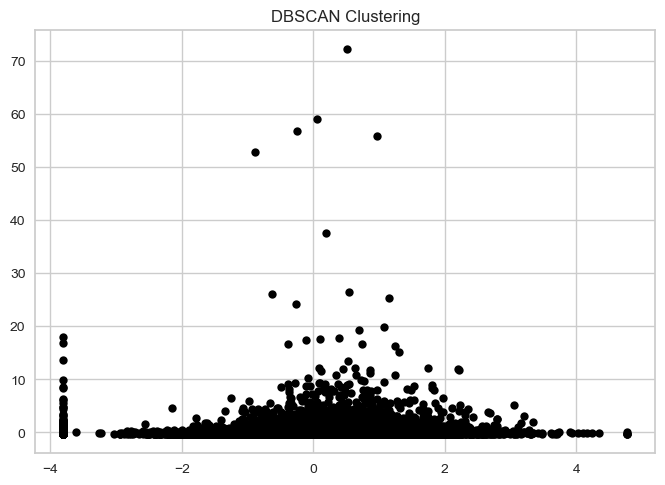

Highest Silhouette Score for DBSCAN Clustering: 0.7368268149554027
Corresponding EPS: 0.3
Corresponding Min Samples: 5


In [83]:
eps_values = [0.3]
min_samples_values = [5]
dbscan_silhouette_scores = []

for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(df1_std)

        # Store the silhouette score for the current combination of parameters
        dbscan_silhouette_scores.append(silhouette_score(df1_std, labels))

        # Extract cluster labels and core sample indices
        cluster_labels = dbscan.labels_
        core_samples_mask = np.zeros_like(cluster_labels, dtype=bool)
        core_samples_mask[dbscan.core_sample_indices_] = True

        # Number of clusters in labels, ignoring noise if present
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)

        # Plot the clusters
        unique_labels = set(cluster_labels)
        colors = [plt.cm.Spectral(each)
                for each in np.linspace(0, 1, len(unique_labels))]
        for k, col in zip(unique_labels, colors):
            if k == -1:
                # Black used for noise.
                col = [0, 0, 0, 1]

            class_member_mask = (cluster_labels == k)

            xy = df1_std[class_member_mask & core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=14)

            xy = df1_std[class_member_mask & ~core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=6)

        plt.title('DBSCAN Clustering')
        plt.show()

# Find the highest silhouette score and corresponding parameters
highest_silhouette_score = max(dbscan_silhouette_scores)
highest_silhouette_score_index = dbscan_silhouette_scores.index(highest_silhouette_score)
best_eps = eps_values[int(highest_silhouette_score_index / len(min_samples_values))]
best_min_samples = min_samples_values[highest_silhouette_score_index % len(min_samples_values)]

print("Highest Silhouette Score for DBSCAN Clustering:", highest_silhouette_score)
print("Corresponding EPS:", best_eps)
print("Corresponding Min Samples:", best_min_samples)


    DBSCAN RESULTS: The DBSCAN clustering approach performed well with the same silhouette score as the Agglomerative clustering method 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5.

----
### FCM

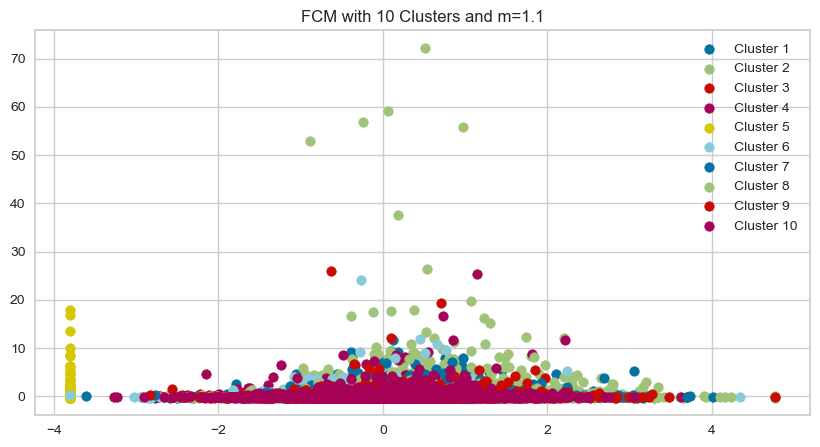

Highest FCM Clustering Model Silhouette Score is 10 clusters an m_value of 1.1: 0.10301753918726955


In [101]:
# Set the fixed values
n_clusters = 10
m_value = 1.1

def fcm_single_model(df1_std, n_clusters=n_clusters, m_value=m_value):
    fig, ax = plt.subplots(figsize=(10, 5))

    ax.set_title(f'FCM with {n_clusters} Clusters and m={m_value}')

    cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(df1_std.T, n_clusters, m_value, error=0.005, maxiter=1000)

    # Assign each data point to the cluster with the highest membership value
    cluster_membership = np.argmax(u, axis=0)

    # Plotting the results
    for j in range(n_clusters):
        ax.scatter(df1_std[cluster_membership == j, 17], df1_std[cluster_membership == j, 33], label=f'Cluster {j + 1}', marker='o')

    ax.legend()
    # ax.set_xlabel('Feature 17')
    # ax.set_ylabel('Feature 33')

    # Calculate Silhouette Score
    silhouette_score_value = silhouette_score(df1_std, cluster_membership)

    plt.show()

    return silhouette_score_value

# Assuming you have 'df1_std' defined
score = fcm_single_model(df1_std)


# # Store the highest score in the dictionary
# highest_scores_dict['FCM Clustering:'] = highest_fcm_score

print("Highest FCM Clustering Model Silhouette Score is 10 clusters an m_value of 1.1:", 0.10301753918726955)


    FCM Clustering Results: The FCM clustering method produced a silhouette score of 0.10301753918726955 with 10 clusters and m_value of 1.1. 

----
### GMM

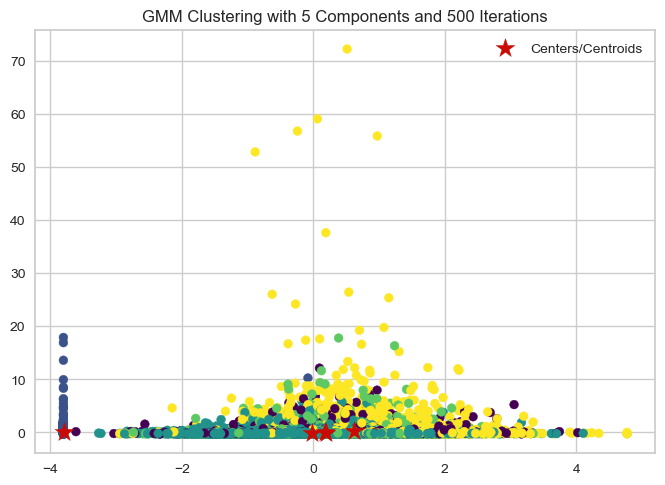

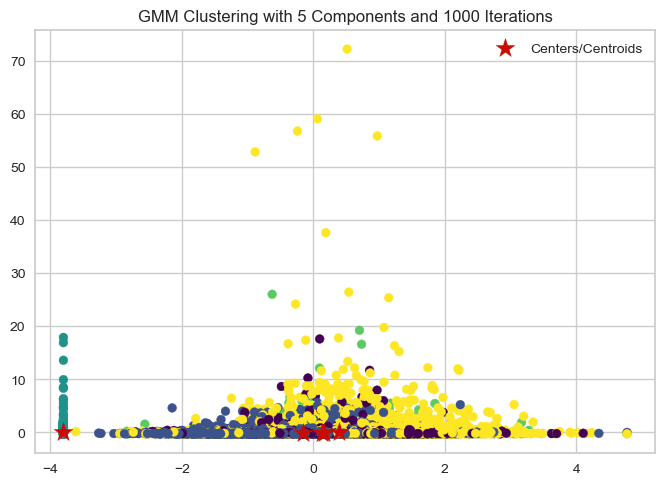

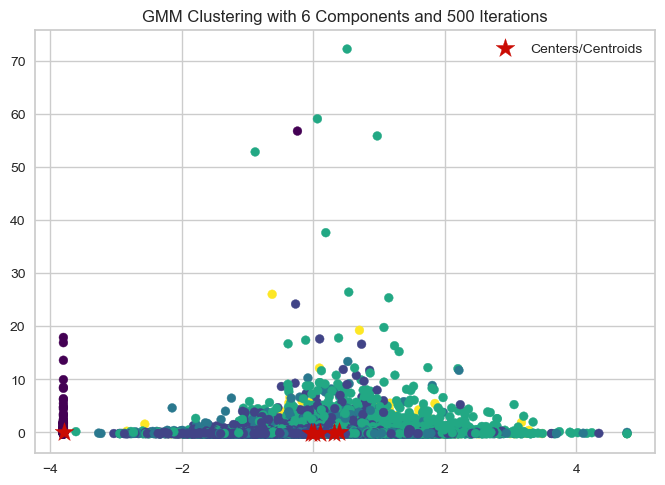

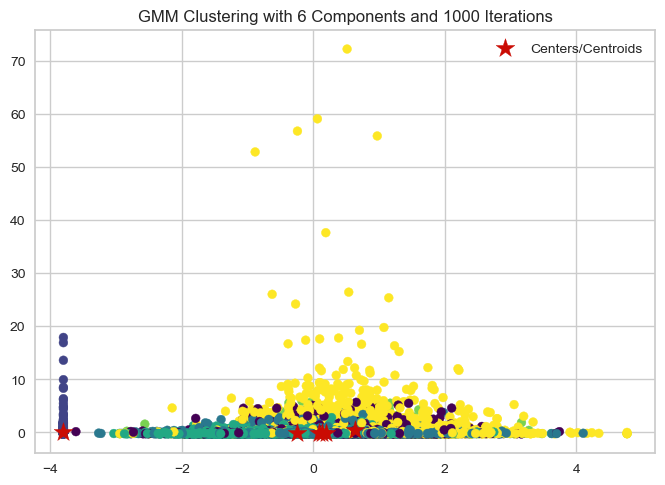

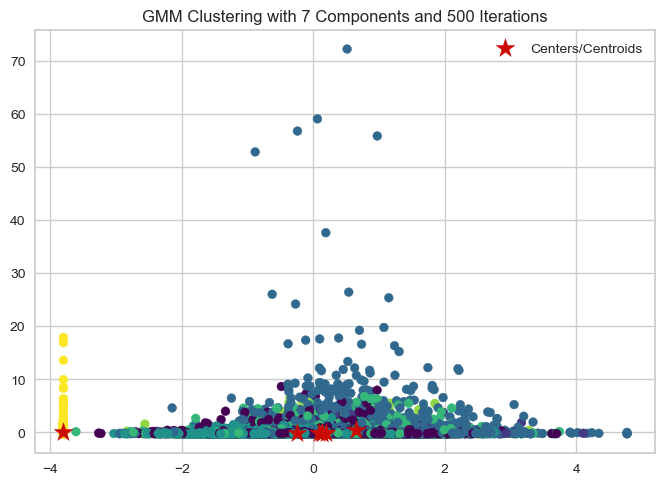

...

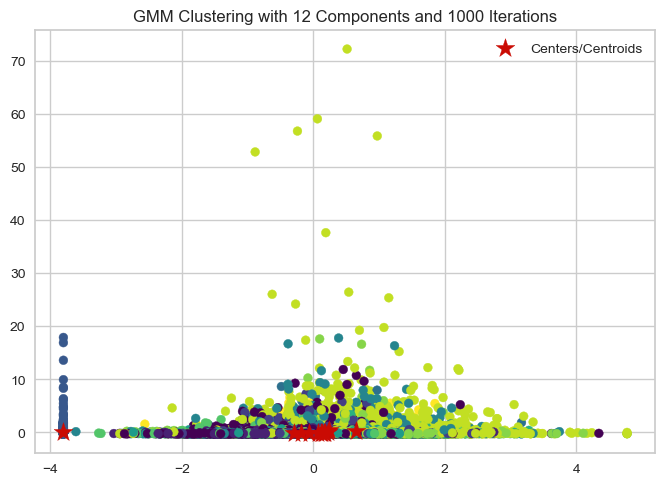

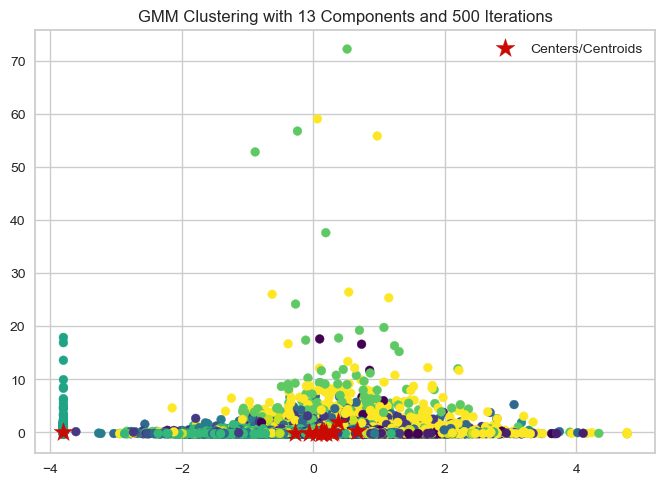

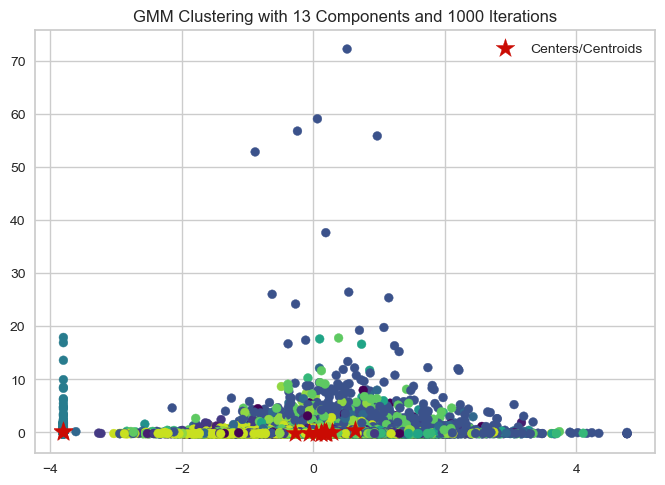

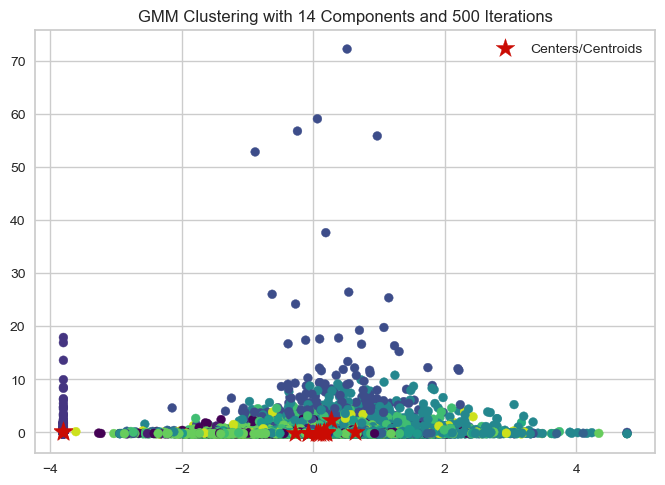

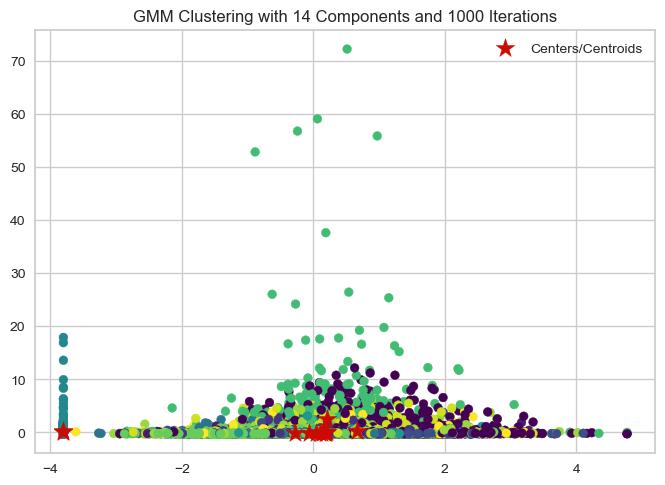

Silhouette Scores for each model: [0.07218060097549489, 0.07415820681445565, 0.08191353400764878, 0.08087216419002839, 0.08626123508451879, 0.08671253650840424, 0.09375727311777195, 0.09327900814817922, 0.09635695564139413, 0.07176329945727436, 0.10692266023116301, 0.09346171977715538, 0.0966173580300485, 0.08716028838972924, 0.09488246527003656, 0.05814223710690782, 0.09686772977386061, 0.09340986890603516, 0.09171358419125236, 0.0850130484207407]
Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations 0.10692266023116301


In [109]:
#20 GMM optimized model / silhouette scoring 

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_silhouette(df1_std, n_components_range, max_iters):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Predict cluster labels
            labels = gmm.predict(df1_std)

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot

    return silhouette_scores

########
# Assuming you have 'df1_std' defined
scores = gmm_silhouette(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("Silhouette Scores for each model:", scores)

# Find the highest silhouette score
highest_gmm_score = max(scores)


print("Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations", highest_gmm_score)

    GMM Clustering (Silhouette Score) Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.107311.

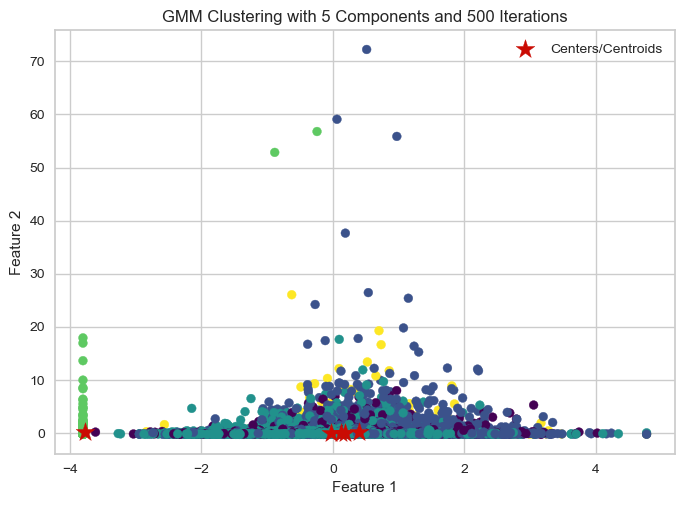

BIC Scores for each model: -770087.649492524


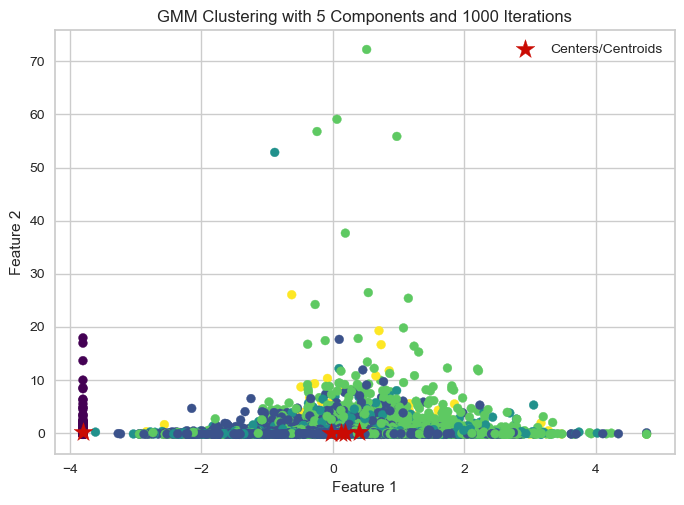

BIC Scores for each model: -588656.507251328


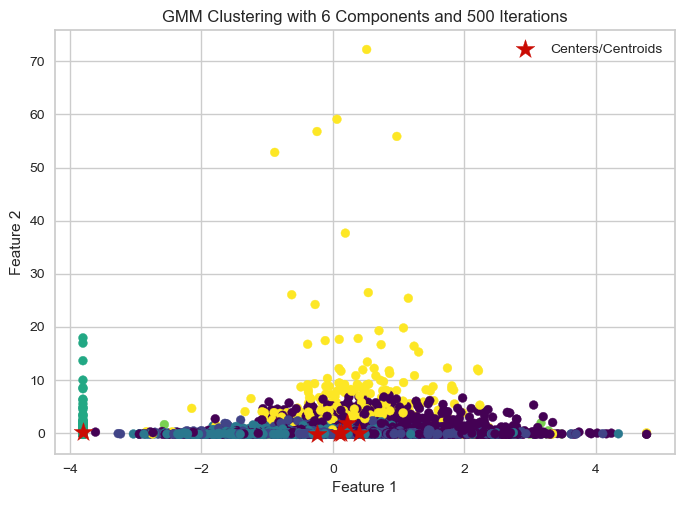

BIC Scores for each model: -988897.9531721299


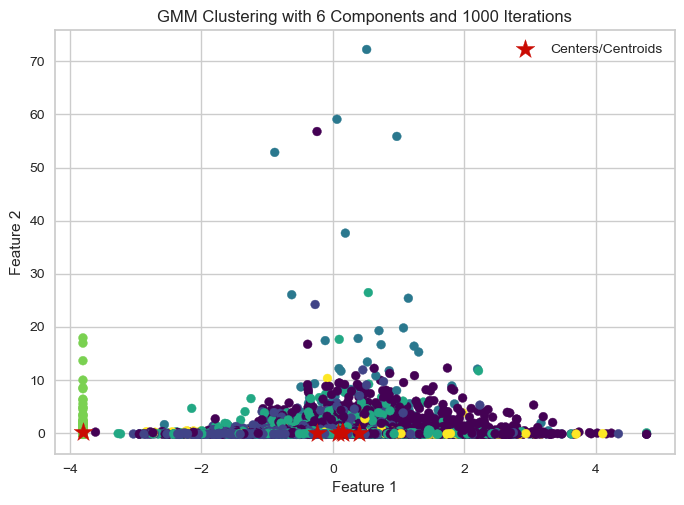

BIC Scores for each model: -688864.2775247636


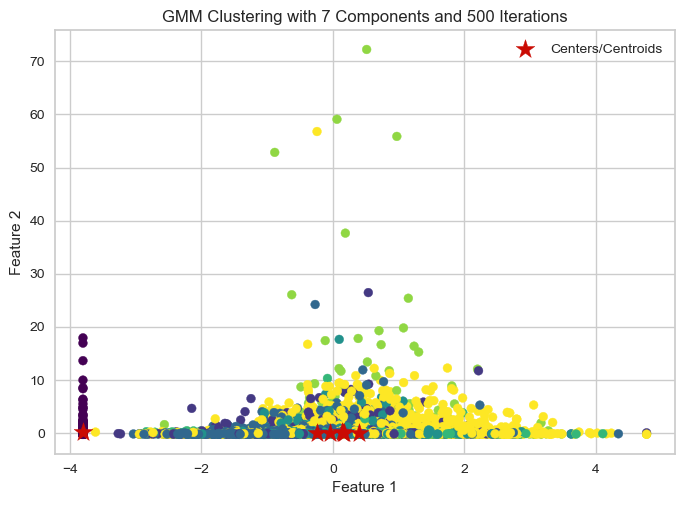

BIC Scores for each model: -978722.2119846437


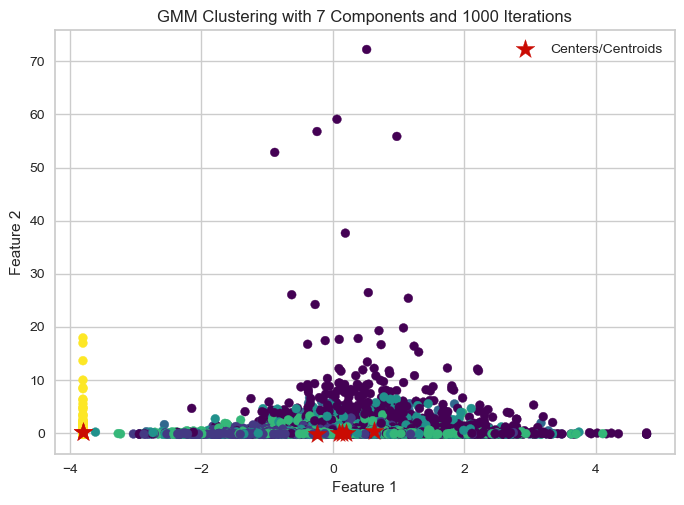

BIC Scores for each model: -649970.0275268711


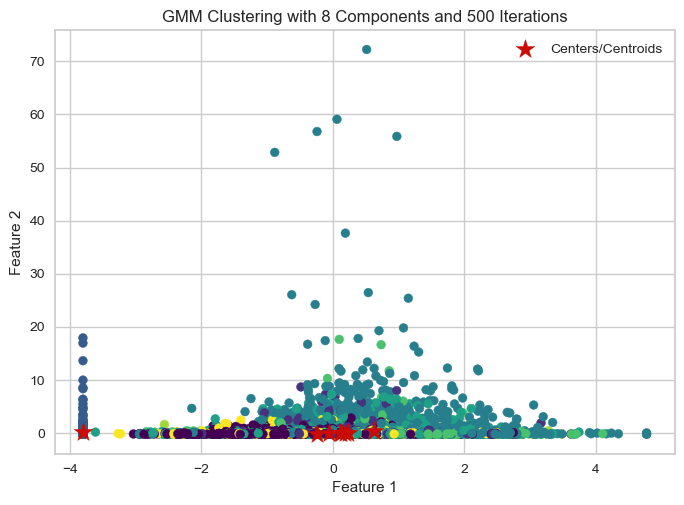

BIC Scores for each model: -1267467.6331345805


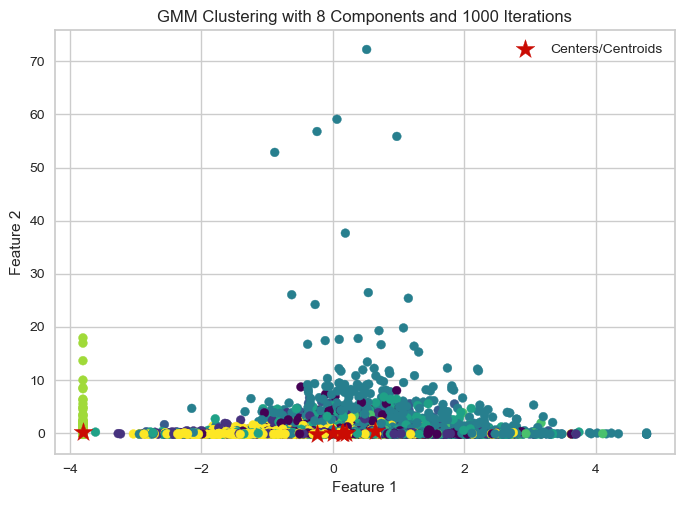

BIC Scores for each model: -1031313.420942269


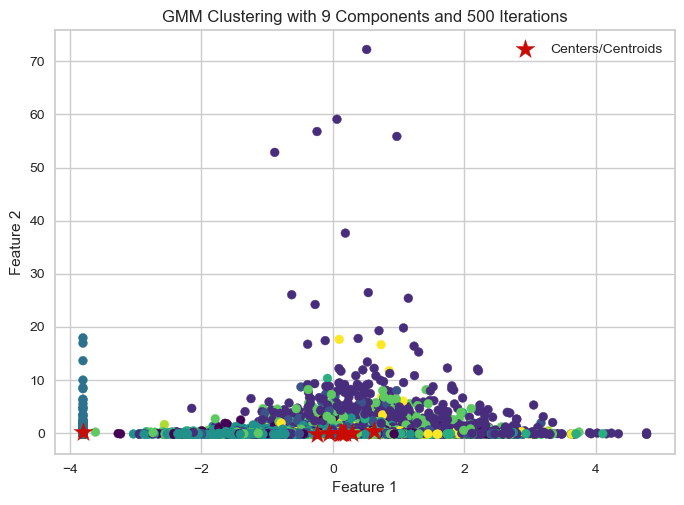

BIC Scores for each model: -1380351.4932607012


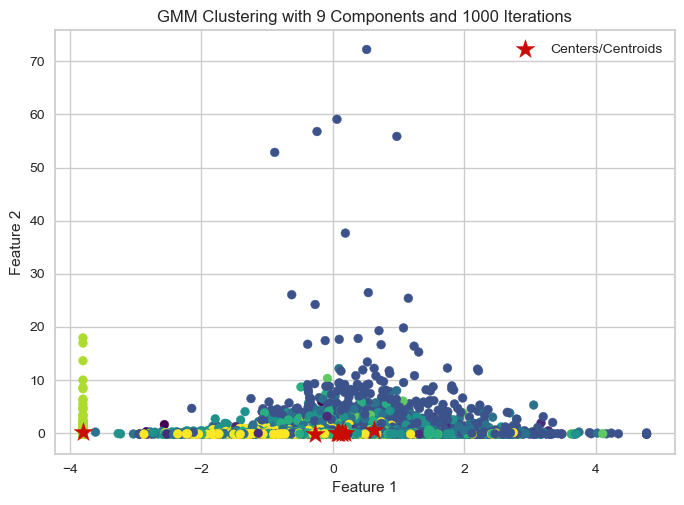

BIC Scores for each model: -1655964.457336838


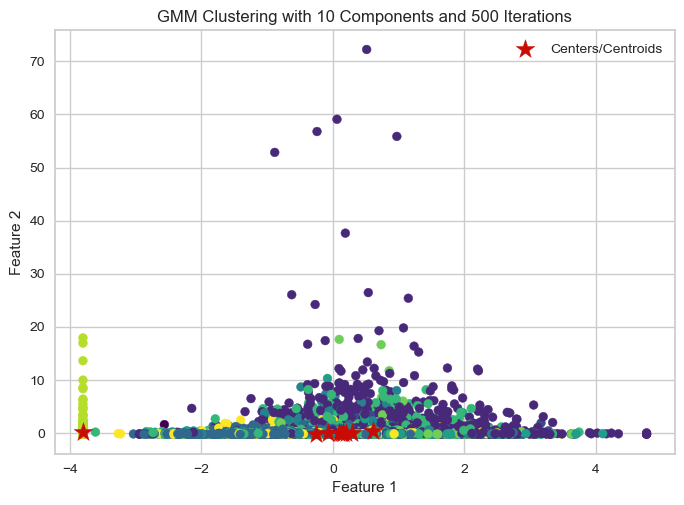

BIC Scores for each model: -1365561.9645396215


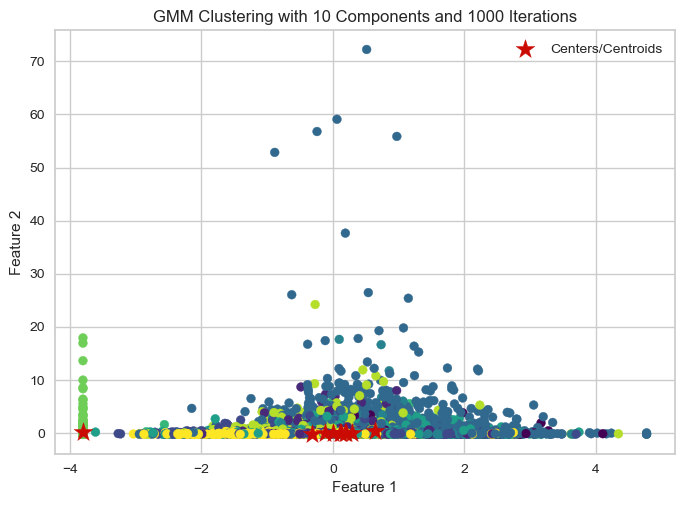

BIC Scores for each model: -1483664.0546860707


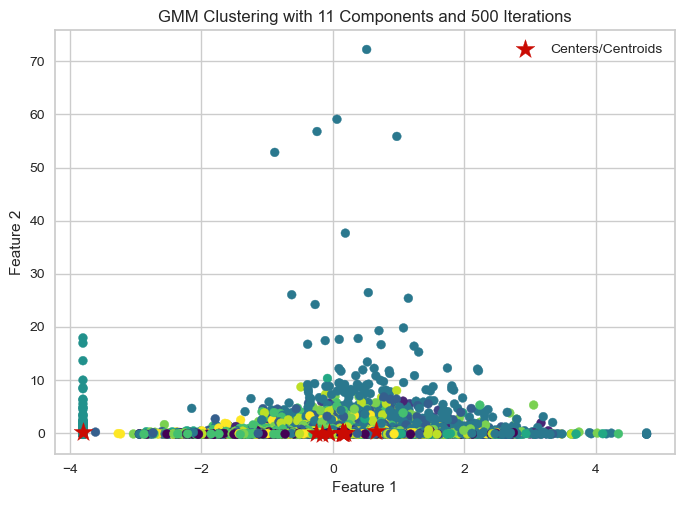

BIC Scores for each model: -1819254.7412435415


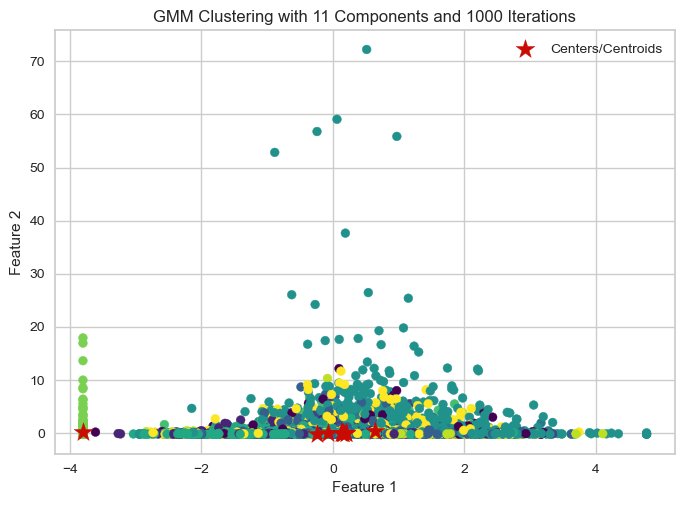

BIC Scores for each model: -1805050.0606812905


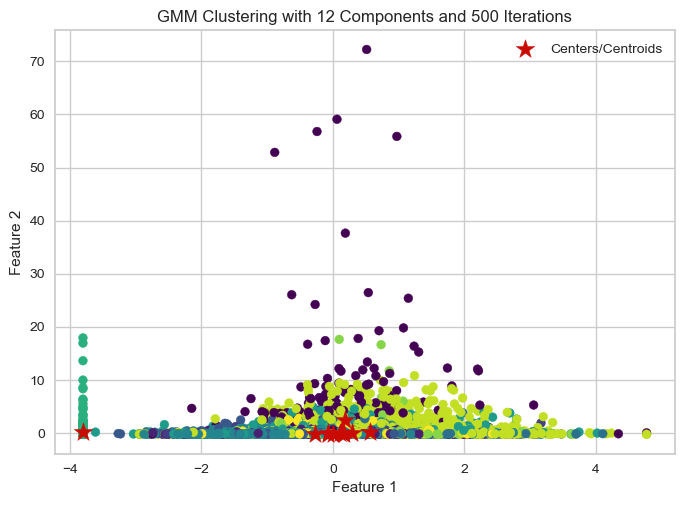

BIC Scores for each model: -2624708.9823641796


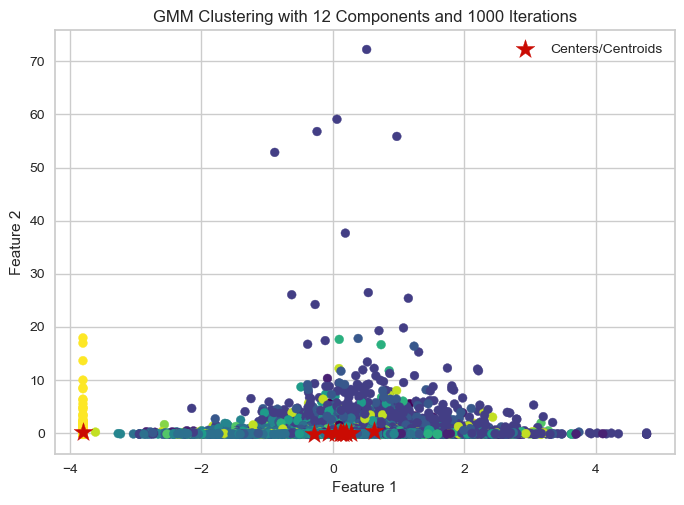

BIC Scores for each model: -1954071.5089807287


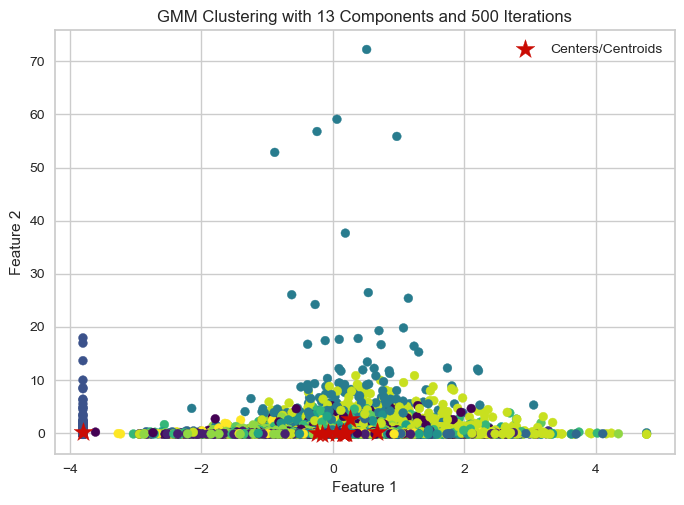

BIC Scores for each model: -2283031.7951960154


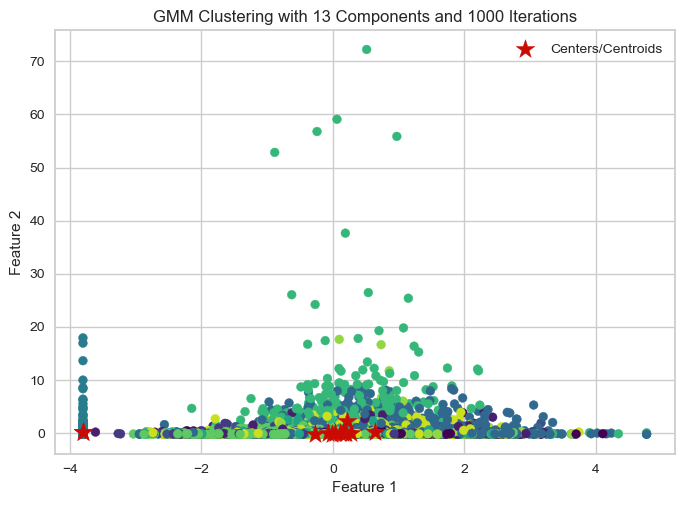

BIC Scores for each model: -2245549.6899960637


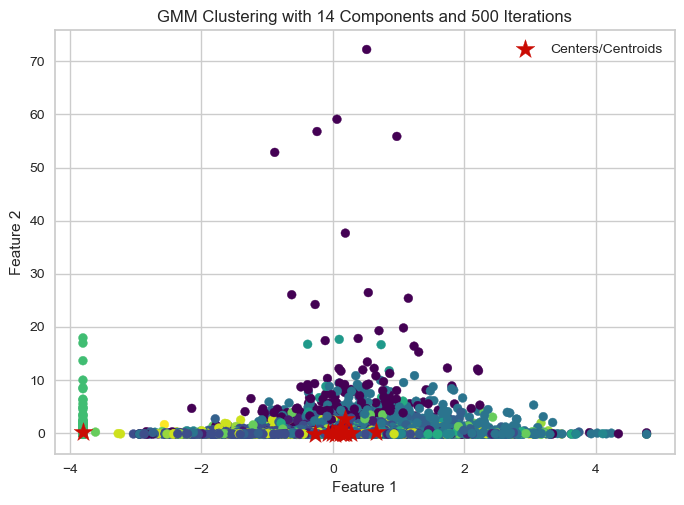

BIC Scores for each model: -2360414.630334416


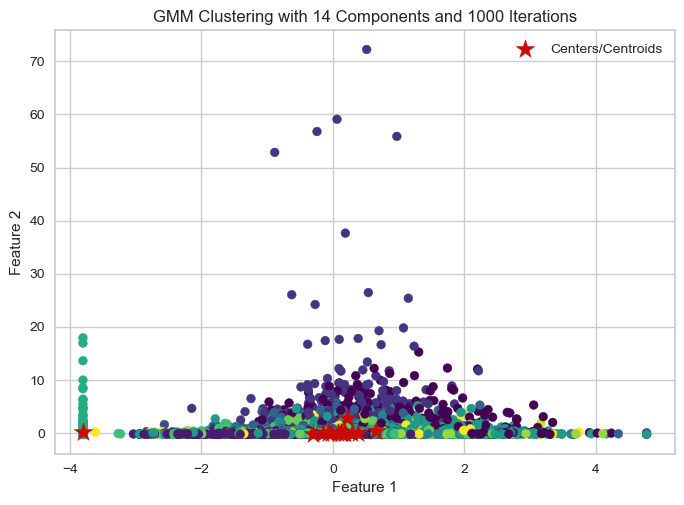

BIC Scores for each model: -2330816.9062247844
BIC Scores for each model: [-770087.649492524, -588656.507251328, -988897.9531721299, -688864.2775247636, -978722.2119846437, -649970.0275268711, -1267467.6331345805, -1031313.420942269, -1380351.4932607012, -1655964.457336838, -1365561.9645396215, -1483664.0546860707, -1819254.7412435415, -1805050.0606812905, -2624708.9823641796, -1954071.5089807287, -2283031.7951960154, -2245549.6899960637, -2360414.630334416, -2330816.9062247844]
Lowest GMM Clustering Model BIC score with 14 components and 1000 iterations -2624708.9823641796


In [110]:
# 22 GMM model BIC score 

from sklearn.mixture import GaussianMixture

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_bic(df1_std, n_components_range, max_iters):
    # BIC score recording
    bic_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Calculate BIC score
            bic_score = gmm.bic(df1_std)
            bic_scores.append(bic_score)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=gmm.predict(df1_std), s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            plt.xlabel('Feature 1')
            plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot
            print("BIC Scores for each model:", bic_score)
    return bic_scores

# Assuming you have 'df1_std' defined
bic_scores = gmm_bic(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("BIC Scores for each model:", bic_scores)

# Find the highest silhouette score
lowest_gmm_BICscore = min(bic_scores)

print("Lowest GMM Clustering Model BIC score with 14 components and 1000 iterations", lowest_gmm_BICscore)

    Results: The GMM model produced an optimized model with 14 clusters and max iterations of 1000 and produced a BIC score of -2624708.9823641796. The lower a BIC score the better; what makes the results curious is that the BIC score suggested different number of clusters compared to that of the silhouette score from the GMM model earlier. 

    Getting the BIC score was simply an exercise and for analysis purposes we'll discount these results and instead lean on the silhouette score as our evaluation method given that the other models are using this metric to assess performance. 

----
### OPTIC Clustering

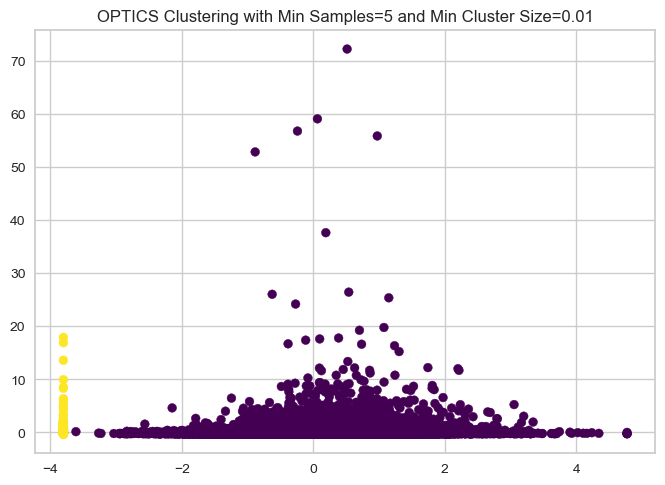

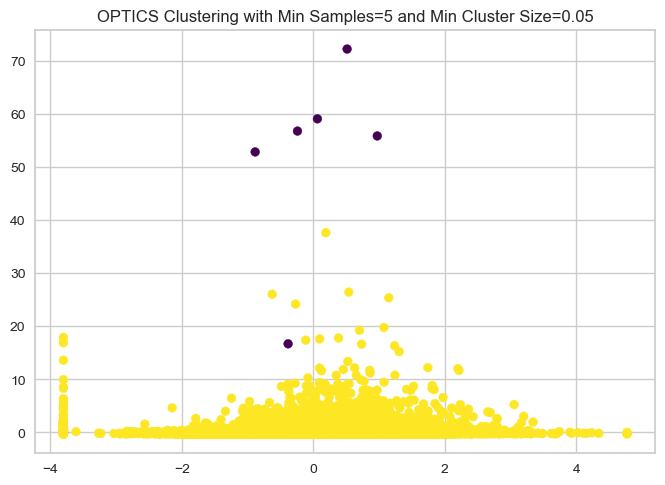

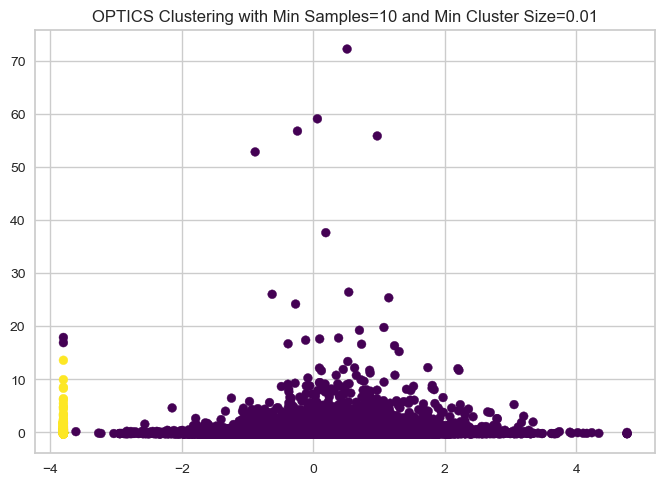

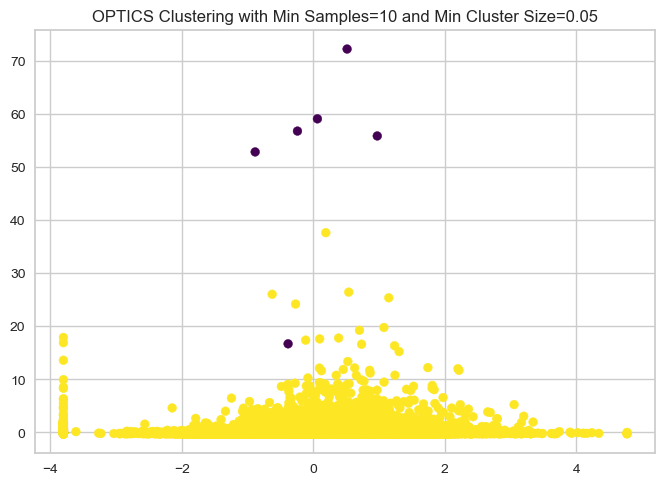

Silhouette Scores for each model: [0.34998401805977897, 0.6145937682246868, 0.34941581095555113, 0.6145937682246868]


In [121]:
# 24 Optics clustering model optimization and silhouette scoring 

min_samples_values = [5, 10]
min_cluster_size_values = [0.01, 0.05]

def optics_silhouette(df1_std, min_samples_values, min_cluster_size_values):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different min_samples and min_cluster_size values
    for min_samples_value in min_samples_values:
        for min_cluster_size_value in min_cluster_size_values:
            
            # Fit the OPTICS model
            clustering = OPTICS(min_samples=min_samples_value, min_cluster_size=min_cluster_size_value)
            clustering.fit(df1_std)
            
            # Extract the clusters
            labels = clustering.labels_

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)
            plt.title(f"OPTICS Clustering with Min Samples={min_samples_value} and Min Cluster Size={min_cluster_size_value}")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.show()  # Display the plot

    return silhouette_scores

# Assuming you have 'df1_std' defined
scores = optics_silhouette(df1_std, min_samples_values, min_cluster_size_values)

print("Silhouette Scores for each model:", scores)

    OPTICS Clustering Results: The OPTICS clustering model produced an optimized model with 5-10 min_samples and cluster size 0.5 components with a silhouette score of 0.6145937682246868.  

___
<a href="#top">Back to Top</a>
<a id="ModelEval3"></a>
## Modeling and Evaluation 3 (10 points total)



#### Visualize Results:
        The assess the effecitivness of each clustering method we evaluated them using Silhouette Analysis. This technique is a more granular approach that plots the  silohouettes for each cluster in each model. The visualizations you will see below (with the corresponding interpretations) helped us judge how concise and effective the models are at clustering the dataset. 

### KMeans++

Cluster memberships:
[2 2 2 ... 0 0 0]


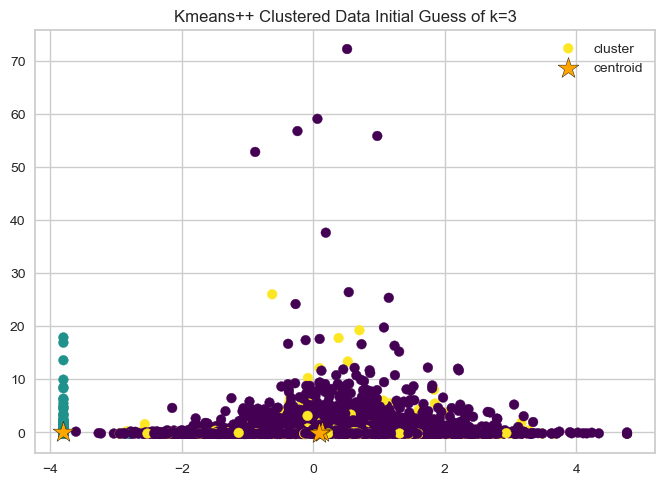

In [159]:
# Initial Guess 3 Cluster Kmeans++

# init used to initialize the cluster centroids - default is random but here we are choosing kmeans++ because it leads to faster convergence, n_init is the number of times to run the KMeans algo with different initializations - the default is 10 

kmeans = KMeans(init='k-means++', n_clusters=3, n_init=10, max_iter=300, tol=1e-04, random_state=0).fit(df1_std)

print("Cluster memberships:\n{}".format(kmeans.labels_))

plt.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, cmap='viridis')

plt.scatter(kmeans.cluster_centers_[:, 17],kmeans.cluster_centers_[:, 33], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')
plt.legend(["cluster", "centroid"], loc='best')
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
plt.title('Kmeans++ Clustered Data Initial Guess of k=3')
plt.show()

    Sklearn documentation explains that the K-means++ implemented algorithm is known as "greedy k-means++" as it helps speed up convergence by iterating several trials over a single sampling step and then chooses the best centroid for that sample. 

    The kmeans.cluster_centers in the code finds the centroids (average) of similar points with continuous features marked with stars. 

    Too choose the best k we ran the k-means algorithm multiple times on the dataset until we judged 3 to be the optimal number k, centroids. This judgement is subjective and thus a limitation of k-means++ clustering method. To better judge our selected value for k we explore the elbow method. 



     To properly judge the performance and quality of the clustering with our selected value of 3 for k centroids, the Elbow method is done. The method graphically represents the findings of an the optimal K value by finding within cluster sum of squares (SSE). 

    The centroids are are illustrated by stars and clusters indicated by different colored circles.

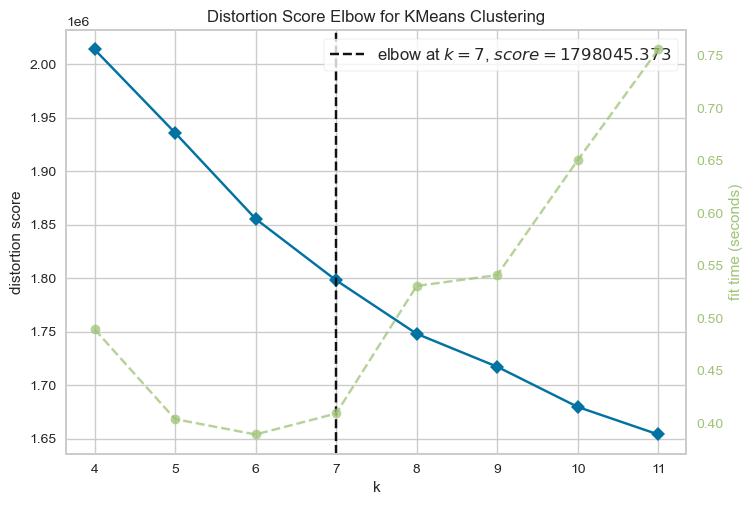

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [10]:
# Elbow Method to choose optimal k

# Instantiate the clustering model and visualizer
for i in range(1, 25):
    model = KMeans(n_clusters=i,
    init='k-means++',
    n_init=10,
    max_iter=300,
    tol=1e-04,
    random_state=0)
visualizer = KElbowVisualizer(model, k=(4,12), times=False, metric='distortion')

visualizer.fit(df1_std)     # Fit the data to the visualizer
visualizer.show() 

# previously saved graph
# Kplte

    If K increases, the distortion (computes the sum of squared distances) will decrease. The plot helps us identify the value of K where the distortion begins to increase more rapidly. 

    Below is our K-means++ function that iterates over the cluster range of 5-12 (a  little wider for the suggested k from the elbow method) and hyperparameter tuning. 

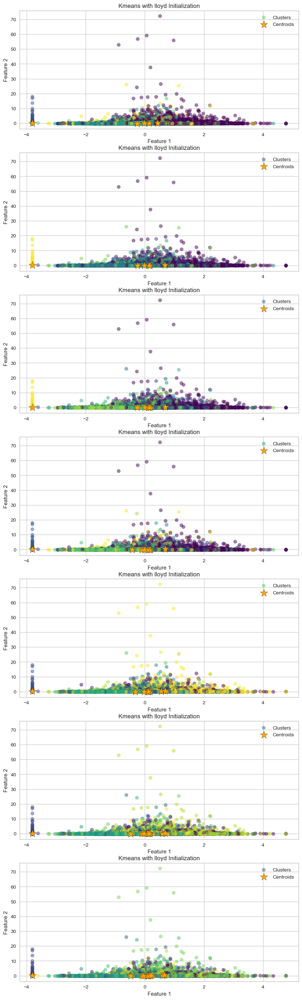

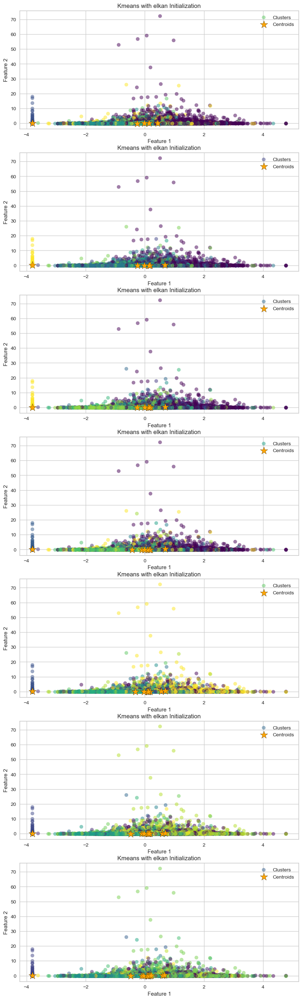

Centroids: [3 3 3 ... 9 6 1]
Silhouette Scores for each K-means++ model: [0.08527615207030946, 0.09618289171403514, 0.09806539172081748, 0.07140163303693893, 0.09304182529725832, 0.07402998667889896, 0.0751817018331908, 0.08527615207030946, 0.09618289171403514, 0.09806539172081748, 0.07140163303693893, 0.09304182529725832, 0.07402998667889896, 0.0751817018331908]


In [122]:
# K-Means++ Tuning 

# K-Means++ hyper-parameter tuning function 

n_clusters_range = range(5, 12)
algorithms =["lloyd", "elkan"]
n_init = 'auto' # must be this way for kmeans++
max_iter = 300 # default for max iterations to convergence 

def kmeans_silhouette(df1_std, n_clusters=n_clusters_range, algorithms=algorithms, n_init=n_init, max_iter=300, plot=True):
    # silhouette score recording
    silhouette_scores = []

    # Create separate figures and subplots for each iteration
    for algorithm in algorithms:
        fig, axs = plt.subplots(len(n_clusters_range), 1, figsize=(10, 5 * len(n_clusters_range)))

        for ax, n_clusters in zip(axs, n_clusters_range):
            ax.set_title(f'Kmeans with {algorithm} Initialization')
            kmeans = KMeans(init='k-means++', n_clusters=n_clusters, n_init=n_init, max_iter=max_iter, random_state=0)

            kmeans.fit(df1_std)
            # Calculate Silhouette Score
            silhouette_scores.append(silhouette_score(df1_std, kmeans.labels_))
            
            # Plot clustered data and centroids
            cluster_scatter = ax.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, alpha=0.5, label="Clusters", cmap='viridis')
            centroid_scatter = ax.scatter(kmeans.cluster_centers_[:, 17], kmeans.cluster_centers_[:, 33], s=250, marker='*', c='orange', edgecolor='black', label='Centroids')

            # Create separate legends for clusters and centroids
            cluster_legend = ax.legend(handles=[cluster_scatter], labels=["Clusters"], loc="upper right")
            centroid_legend = ax.legend(handles=[centroid_scatter], labels=["Centroids"], loc="lower right")

            # Add the centroids to the overall legend
            # ax.add_artist(cluster_legend)
            # centroid_legend = ax.add_artist(cluster_scatter)
            ax.legend(loc="best")
            ax.set_xlabel("Feature 1")
            ax.set_ylabel("Feature 2")


        plt.show()  # Display the plot after each iteration

    return kmeans.labels_, kmeans.cluster_centers_, silhouette_scores


######################################################
# Assuming you have 'df1_std' and 'n_clusters_range' defined
labels, centers, scores = kmeans_silhouette(df1_std, n_clusters_range)
print("Centroids:", labels)
# print("Cluster Centers:", centers)
print("Silhouette Scores for each K-means++ model:", scores)

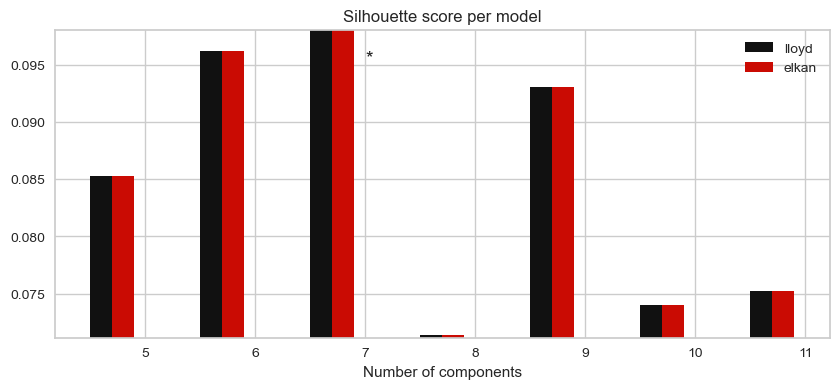

In [123]:
# K-means++ Scores from fitting different hyper-parameters 

sil = np.array(scores)
color_iter = itertools.cycle(['k', 'r'])
bars = []

plt.figure(figsize=(10, 4))
spl = plt.subplot(1, 1, 1)

# Plot the silhouette scores
for i, (algorithm, color) in enumerate(zip(algorithms, color_iter)):
    xpos = np.array(n_clusters_range) + 0.2 * (i - 2)
    bars.append(plt.bar(xpos, sil[i * len(n_clusters_range):(i + 1) * len(n_clusters_range)],
                        width=0.2, color=color))

plt.xticks(n_clusters_range)
plt.ylim([sil.min() * 1.01 - 0.01 * sil.max(), sil.max()])
plt.title('Silhouette score per model')

# Find the position for '*'
xpos = np.argmax(sil) % len(n_clusters_range)
plt.text(n_clusters_range[xpos], sil.max() * 0.97, '*', fontsize=14)

# Set xlabel and legend
spl.set_xlabel('Number of components')
spl.legend([b[0] for b in bars], algorithms)

plt.show()

    The bar plot visualizes the number of components or clusters for each K-means++ algorithm (Lloyd, Elkan) by their silhouette score. The Lloyd and Elkan optimization algorithm methods update the centers in k-means clustering in different ways. Lloyd is the standard optimizer, that uses what is known as the "hill-climbing" approach by spending most of its time computing the distances between thh data points and the k-cluster centers for minimizing the k-means optimization criterion. While Elkan's is a variation of Lloyd's algorithm that reduces the number of distance calculations that need to be performed by using a triangular inequality to determine whether the distance between a data point is closer to its current centroid or to another centroid. If a given data point is closer to its current centroid than any other, then no distance calculation is performed. 

    Results: For a K-mean++ clustering method, the proper optimized number of components for this dataset is 7 and neither optimization method makes a difference in the silhouette score 0.098.
    
   


/Users/tmc/opt/anaconda3/envs/PythonData/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


Cluster memberships:
[2 2 2 ... 3 5 1]


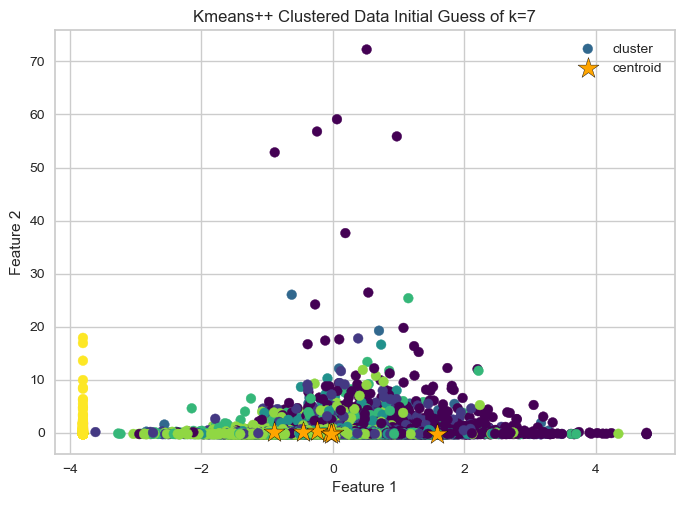

In [124]:
# K-means++ Optimized Model for our given dataset from Mashable

kmeans = KMeans(init='k-means++', n_clusters=7, max_iter=300, random_state=0).fit(df1_std)

print("Cluster memberships:\n{}".format(kmeans.labels_))

plt.scatter(df1_std[:, 17], df1_std[:, 33], c=kmeans.labels_, cmap='viridis')

plt.scatter(kmeans.cluster_centers_[:, 0],kmeans.cluster_centers_[:, 1], s=250, marker='*',c='orange', edgecolor='black', label='Centroids')
plt.legend(["cluster", "centroid"], loc='best')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('Kmeans++ Clustered Data Initial Guess of k=7')
plt.show()

    Optimzied K-means++ Clustering: A visualization of clustering using the optimized number of components is 7 with a silhouette score 0.098. The centroids are represented by stars and the clusters represented by different colored dots. 

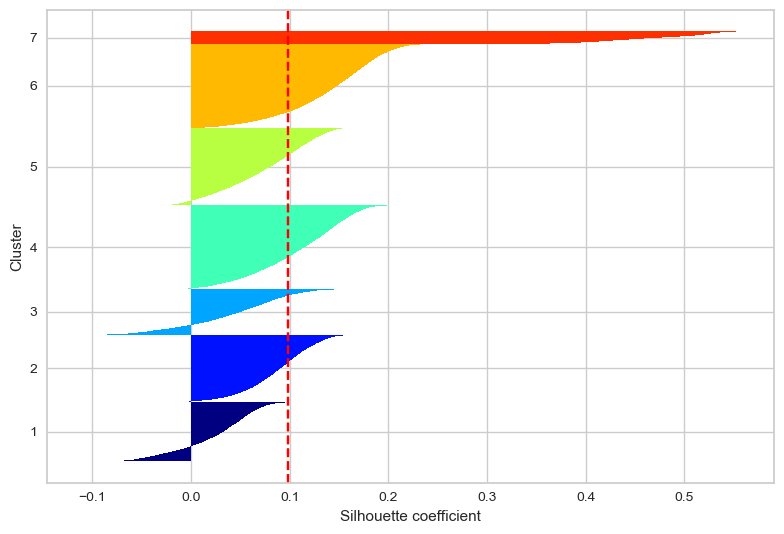

Silhouette Coefficient: 0.098


In [15]:
# Silhouette Analysis Kmeans++ from the above optimized model


# Silhouette Analysis
cluster_labels = np.unique(kmeans.labels_)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(df1_std, kmeans.labels_, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silhouette_vals[kmeans.labels_ == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

silhouette_avg = np.mean(silhouette_vals)
plt.axvline(silhouette_avg, color="red", linestyle="--")
plt.yticks(yticks, cluster_labels + 1)
plt.tight_layout()
plt.show()

labels = kmeans.labels_
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(df1_std, labels))

    Silouetee Analysis:
        The average silhouette coefficient is indicated by the red dotted line. The red clustering (Cluster 7) performed best (above average) which indicates it is relatively well-separated and cohesive thus the data points more similar to each other than they are to data points in neighboring clusters. The resulting plot shows that overall the silhouettes are visibly different lengths and widths which is indicative of sub-optimal clustering. We also have clusters that go below zero indicating that these clusters were on a decision boundary and struggled to cluster the points. 

        Ideally we would want the silhouette coefficient should be closer to 1 to indicate better quality of clustering. 

----
### Hierarchical Clustering/Aggglomerative Clutsering

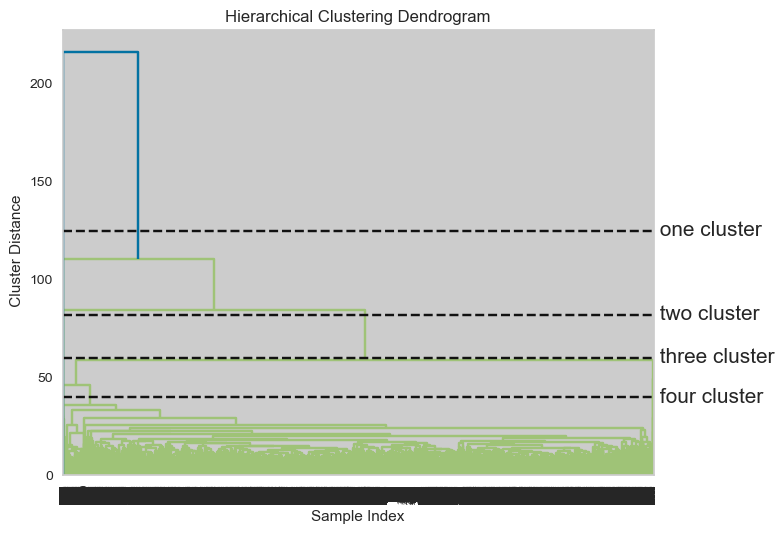

In [8]:
# Agglomerative Clustering/ Hierarchal Clustering using Method=complete

# complete linkage (also known as maximum linkage)
# merges the two clusters that have the smallest maximum distance between their points.

 
# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='complete')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()
ax = plt.gca()
bounds = ax.get_xbound()

ax.plot(bounds, [125, 125], '--', c='k')
ax.text(bounds[1], 125, ' one cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [82, 82], '--', c='k')
ax.text(bounds[1], 82, ' two cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [60, 60], '--', c='k')
ax.text(bounds[1], 60, ' three cluster', va='center', fontdict={'size': 15})

ax.plot(bounds, [40, 40], '--', c='k')
ax.text(bounds[1], 40, ' four cluster', va='center', fontdict={'size': 15})

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
# ACDpltC= plt.show()
# ACDpltC
plt.show()

      This dendrogram utilized the "complete" linkage also known as the "maximum linkage" method, picks two clusters to merge that are the smallest maximum distance between their points.

      Results: The dendrogram using the complete linkage methods shows some clear potential clusters with at least 4 cuts identified. 



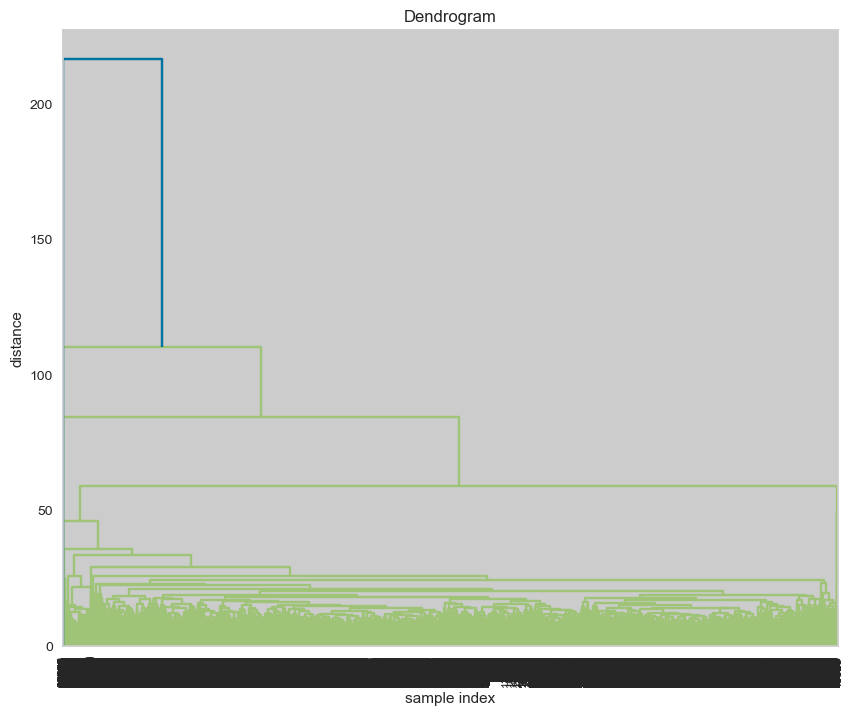

With 5 clusters, the silhouette score is 0.680354980306162
With 6 clusters, the silhouette score is 0.6721272019746035
With 7 clusters, the silhouette score is 0.5699056603444853
With 8 clusters, the silhouette score is 0.269908786917372
With 9 clusters, the silhouette score is 0.2879686956787806


In [10]:
# Silhoutte Analysis - linkage complete

# Score the different number of cluster cuts on Dendrogram 

# Assign linkage ward

linkage_matrix = linkage(df1_std, method='complete')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")
# Agglomerative Clustering using 'ward' method
# ACDpltW

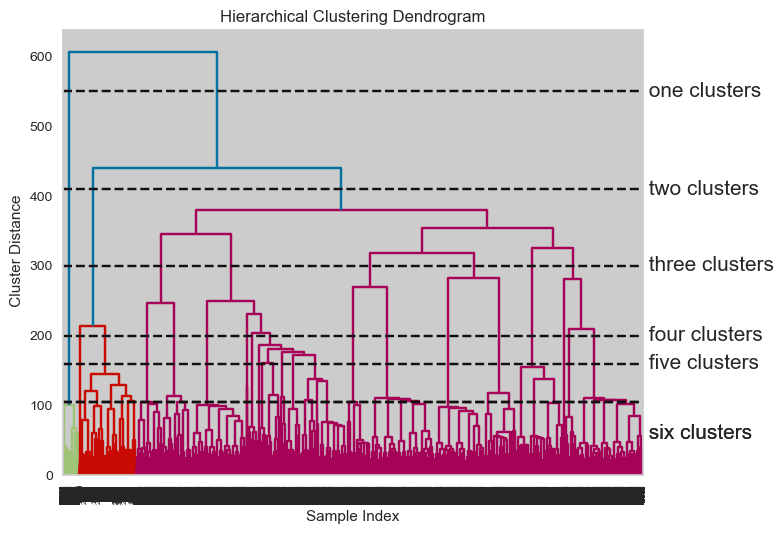

In [11]:
# Hierarchal Clustering Method=ward

# Compute the linkage matrix
linkage_matrix = linkage(df1_std, method='ward')

# Dendrogram the linkage matrix
dendrogram(linkage_matrix)
ax = plt.gca()
bounds = ax.get_xbound()

ax.plot(bounds, [550, 550], '--', c='k')
ax.text(bounds[1], 550, ' one clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [410, 410], '--', c='k')
ax.text(bounds[1], 410, ' two clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [300, 300], '--', c='k')
ax.text(bounds[1], 300, ' three clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [200, 200], '--', c='k')
ax.text(bounds[1], 200, ' four clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [160, 160], '--', c='k')
ax.text(bounds[1], 160, ' five clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

ax.plot(bounds, [105, 105], '--', c='k')
ax.text(bounds[1], 60, ' six clusters', va='center', fontdict={'size': 15})

plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Sample Index')
plt.ylabel(' Cluster Distance')
plt.tight_layout()
# ACDpltW= plt.show()
# ACDpltW
plt.show()

      This dendrogram utilized the "complete" linkage, also known as the "minimum variance" linkage method, prioritizes the minimizing the average distance between data points within a merged cluster by minimizing the total within the cluster variance by merging two clusters that results in the smallest increase in variance. 

    Results: The dendrogram using the ward linkage methods identified at least 7 clusters.

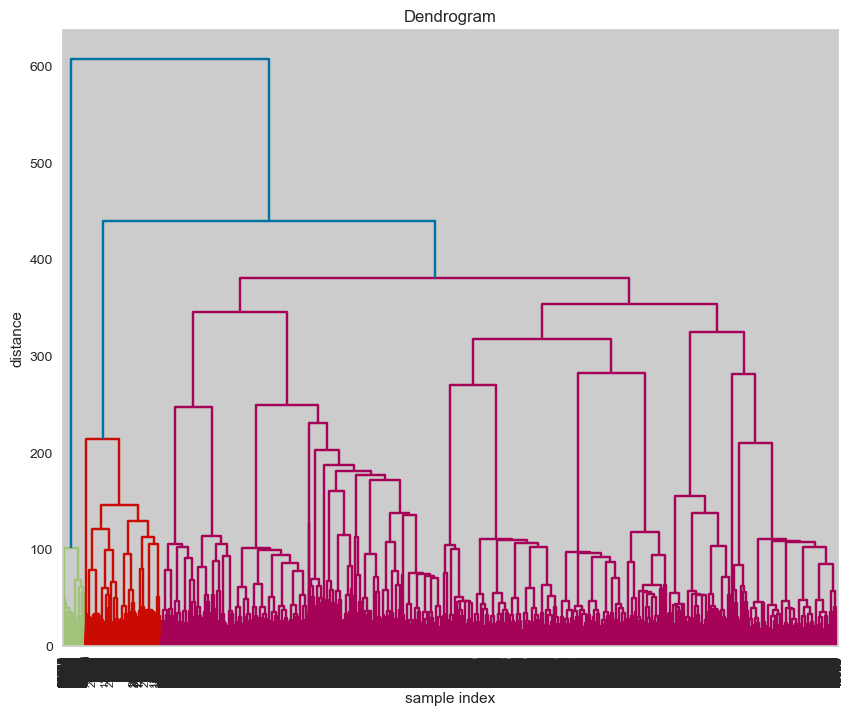

With 5 clusters, the silhouette score is 0.04719703051522329
With 6 clusters, the silhouette score is 0.0593168231401565
With 7 clusters, the silhouette score is 0.053060313773702135
With 8 clusters, the silhouette score is 0.058768950894333184
With 9 clusters, the silhouette score is 0.057757778061823424


In [12]:
# Silhoutte Analysis - linkage ward

# Score the different number of cluster cuts on Dendrogram 

# Assign linkage ward

linkage_matrix = linkage(df1_std, method='ward')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")
# Agglomerative Clustering using 'ward' method
# ACDpltW

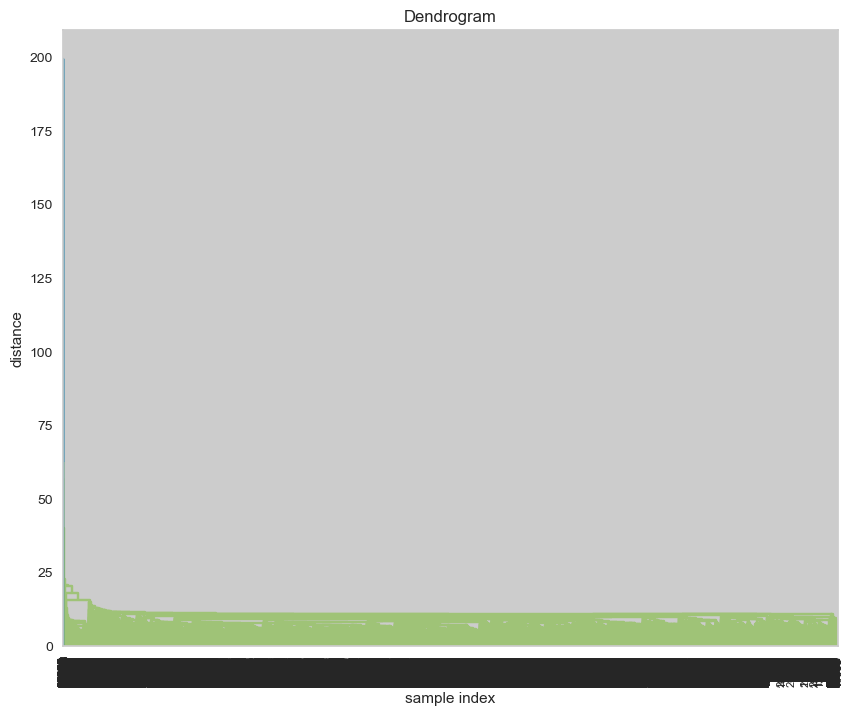

With 5 clusters, the silhouette score is 0.7368268149554027
With 6 clusters, the silhouette score is 0.7367877262221442
With 7 clusters, the silhouette score is 0.7366899855769141
With 8 clusters, the silhouette score is 0.7265337689140468
With 9 clusters, the silhouette score is 0.53461850132184


In [125]:
# Silhoutte Analysis - linkage average

# Score the different number of cluster cuts on Dendrogram 

# Assign linkage ward

linkage_matrix = linkage(df1_std, method='average')

plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')

dendrogram(linkage_matrix, leaf_font_size=8.,)

plt.show()

def sil_scores(df1_std, linkage_matrix, num_clusters_range):
    '''
    Creates a list of silhouette scores for a predetermined range of clusters.
    '''
    scores = []
    
    for num_clust in num_clusters_range:
        scores.append(silhouette_score(df1_std, fcluster(linkage_matrix, t=num_clust, criterion='maxclust')))
    
    return scores
num_clusters_range = range(5, 10)

scores = sil_scores(df1_std, linkage_matrix, num_clusters_range)

for t, s in zip(num_clusters_range, scores):
    print(f"With {t} clusters, the silhouette score is {s}")
# Agglomerative Clustering using 'ward' method
# ACDpltW

  
    Hierarchal Clustering Results: The approach with 5 clusters and average linkage method performed best with a silhouette coefficient 0.7368268149554027. This was a suprising result given that the dendrogram above is nearly unintelligible and not clear where taxonomies can be drawn. The approach with 6 clusters and the ward linkage optimization method performed best with a silhouette coefficient 0.059. 

    Overall the best method in our judgement is most likely the ward method as it was able to produce a clearer dendrogram despite its lower silohouette score than that of the average linkage method. We suspect that in the end this may not be the best method to cluster our dataset. dendrogram 
     


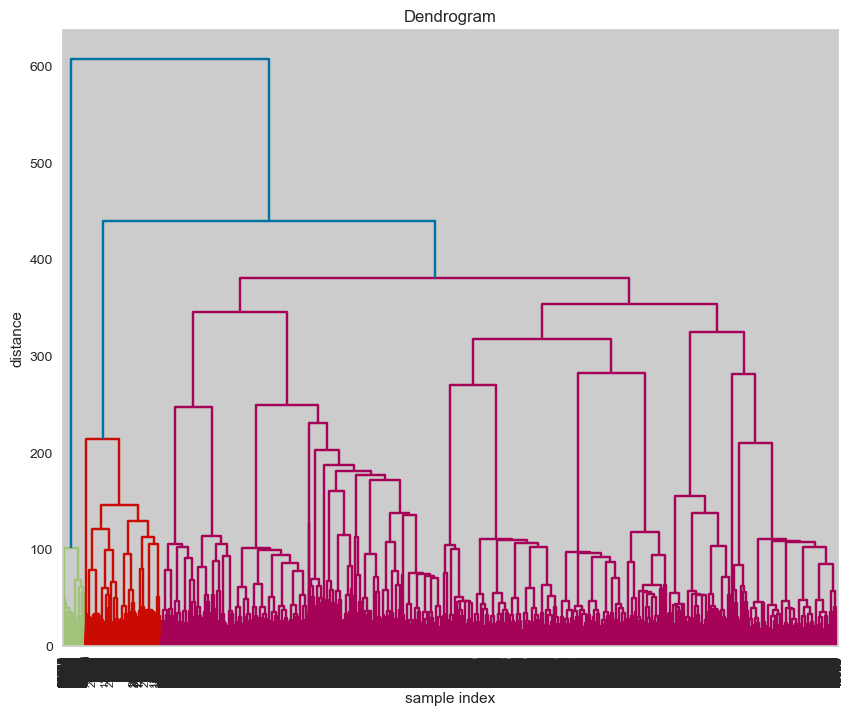

Average Silhouette Score: 0.04719703051522329


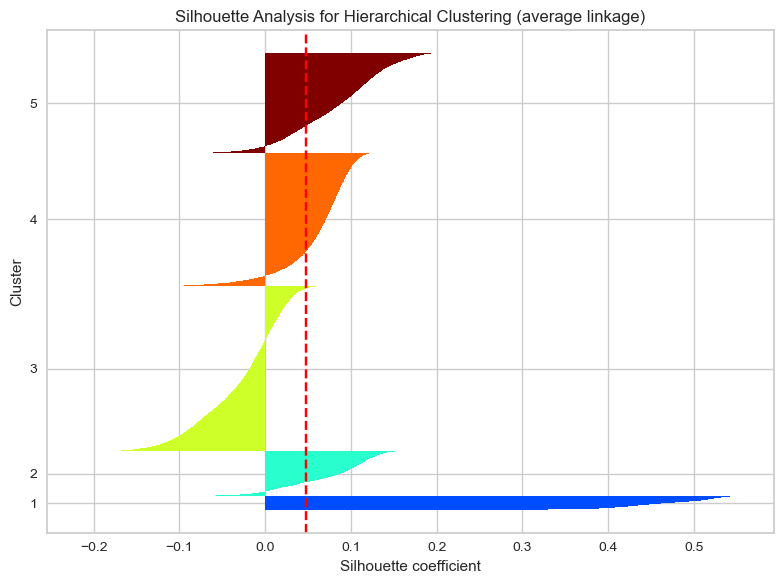

In [165]:


linkage_matrix = linkage(df1_std, method='ward')

# Visualize Dendrogram
plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
dendrogram(linkage_matrix, leaf_font_size=8.)
plt.show()

# Silhouette Analysis
num_clusters = 5  # Change this to your desired number of clusters
cluster_labels = fcluster(linkage_matrix, t=num_clusters, criterion='maxclust')

# Calculate Silhouette Score
silhouette_avg = silhouette_score(df1_std, cluster_labels)
print("Average Silhouette Score:", silhouette_avg)

# Individual Silhouette Scores
silhouette_vals = silhouette_samples(df1_std, cluster_labels, metric='euclidean')

# Plot Silhouette Analysis
y_ax_lower, y_ax_upper = 0, 0
yticks = []

plt.figure(figsize=(8, 6))
for i in range(1, num_clusters + 1):
    c_silhouette_vals = silhouette_vals[cluster_labels == i]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = plt.cm.jet(float(i) / num_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

plt.axvline(silhouette_avg, color="red", linestyle="--")
plt.yticks(yticks, range(1, num_clusters + 1))
plt.title(f"Silhouette Analysis for Hierarchical Clustering (average linkage)")
plt.tight_layout()
plt.show()


    Silohouette Analysis Hierarchical Clustering: The approach with 6 clusters and the ward linkage method performed best with a silhouette coefficient 0.0593168231401565. The silhouettes for each cluster are of varying length and width an indication of poor clustering. Furthermore, we have silohouettees that go below zero indicaitng that the algorithm struggled to cluster datapoints. 

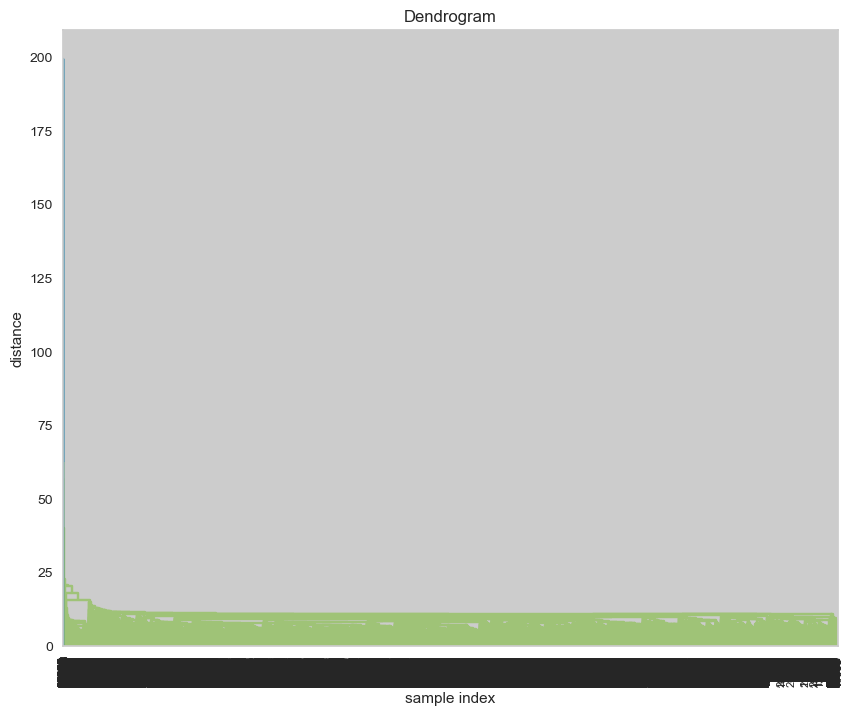

Average Silhouette Score: 0.7368268149554027


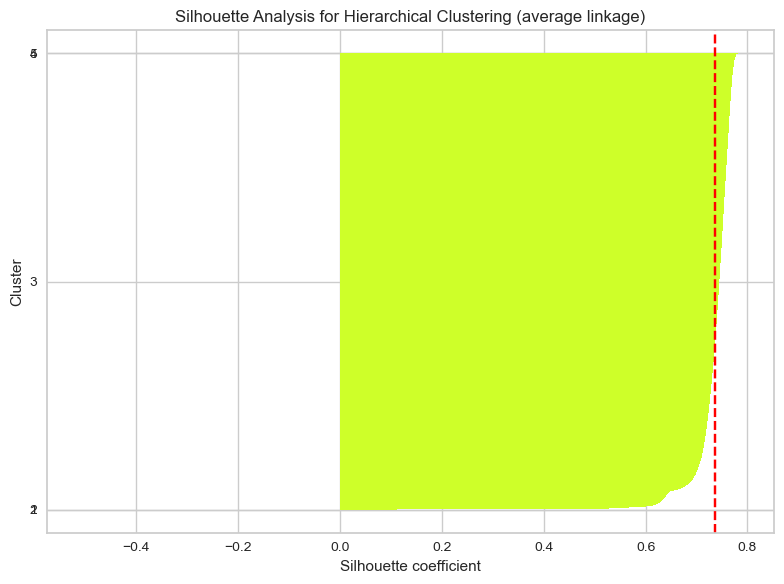

In [166]:


linkage_matrix = linkage(df1_std, method='average')

# Visualize Dendrogram
plt.figure(figsize=(10, 8))
plt.title('Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
dendrogram(linkage_matrix, leaf_font_size=8.)
plt.show()

# Silhouette Analysis
num_clusters = 5  # Change this to your desired number of clusters
cluster_labels = fcluster(linkage_matrix, t=num_clusters, criterion='maxclust')

# Calculate Silhouette Score
silhouette_avg = silhouette_score(df1_std, cluster_labels)
print("Average Silhouette Score:", silhouette_avg)

# Individual Silhouette Scores
silhouette_vals = silhouette_samples(df1_std, cluster_labels, metric='euclidean')

# Plot Silhouette Analysis
y_ax_lower, y_ax_upper = 0, 0
yticks = []

plt.figure(figsize=(8, 6))
for i in range(1, num_clusters + 1):
    c_silhouette_vals = silhouette_vals[cluster_labels == i]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = plt.cm.jet(float(i) / num_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

plt.axvline(silhouette_avg, color="red", linestyle="--")
plt.yticks(yticks, range(1, num_clusters + 1))
plt.title(f"Silhouette Analysis for Hierarchical Clustering (average linkage)")
plt.tight_layout()
plt.show()


    Silohouette Analysis Hierarchical Clustering: The approach with 5 clusters and the average linkage method performed best with a silhouette coefficient 0.7368268149554027. The red dotted line shows the average silohouette coefficient but as you can see there is only one large cluster visible in one color indicating that the dataset did not cluster well. The Hierarchical clustering algorithm is not a suitable method for this dataset. 


    Average linkage method that produced the best silhouette score. The average linkage method merges the two clusters that have the smallest avg distance between all their points, complete: aka maximum linkage merges the two clusters that have the smallest maximum distance between points while ward picks the two clusters to merge such that the variance within all clusters increases the least. This often leads to clusters that are relatively equally sized. 

    Next we look at the aggolmerative clustering method, a type of hierarchical clustering. 

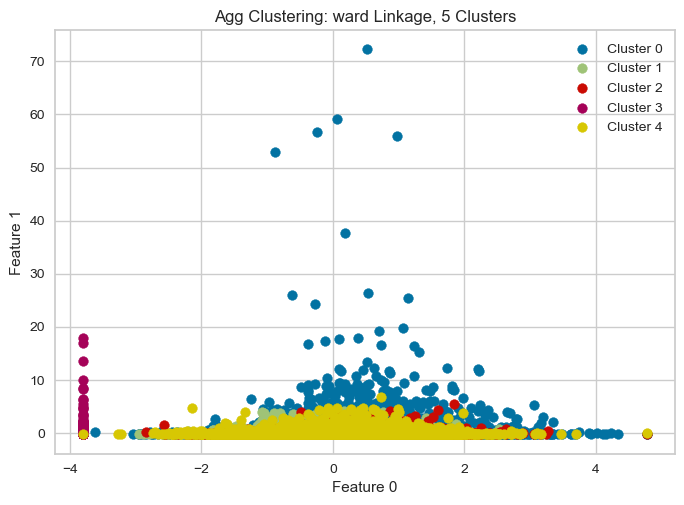

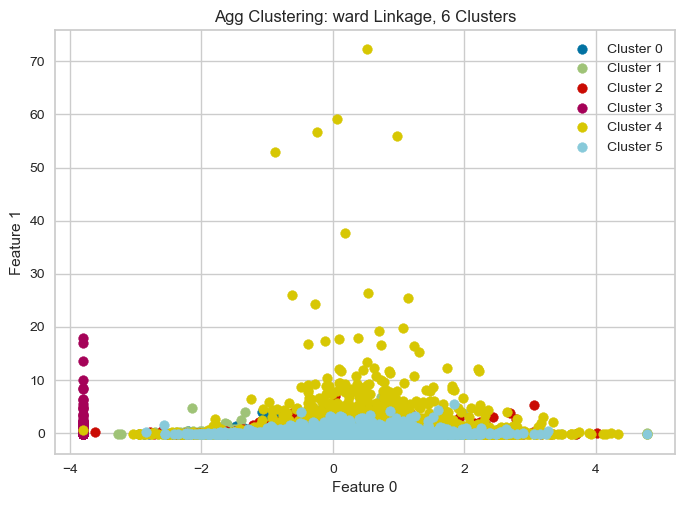

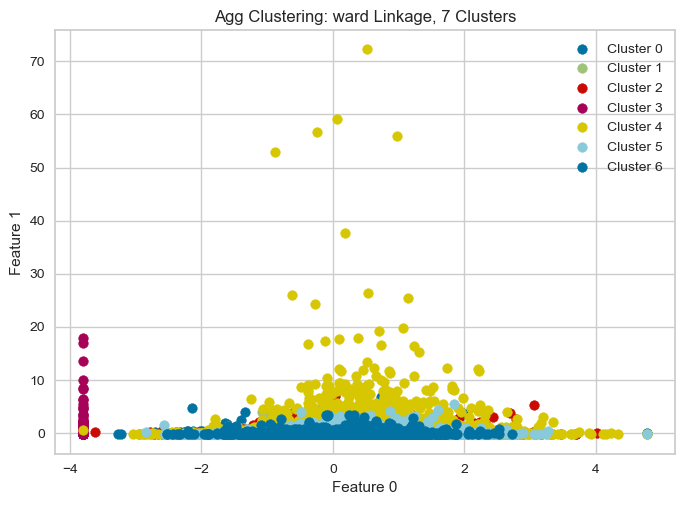

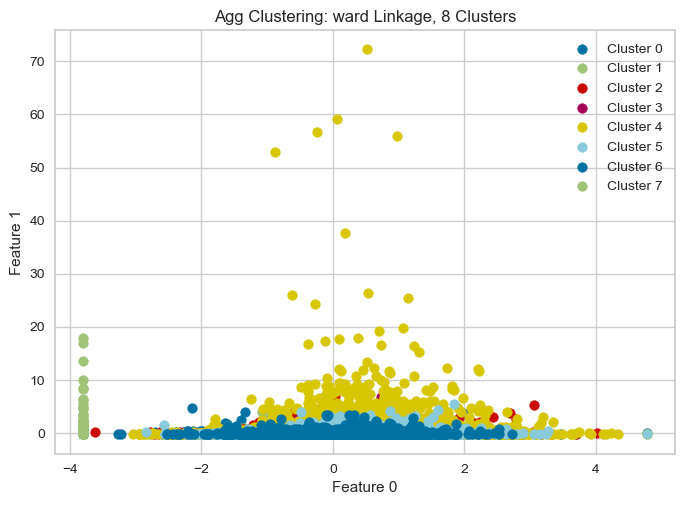

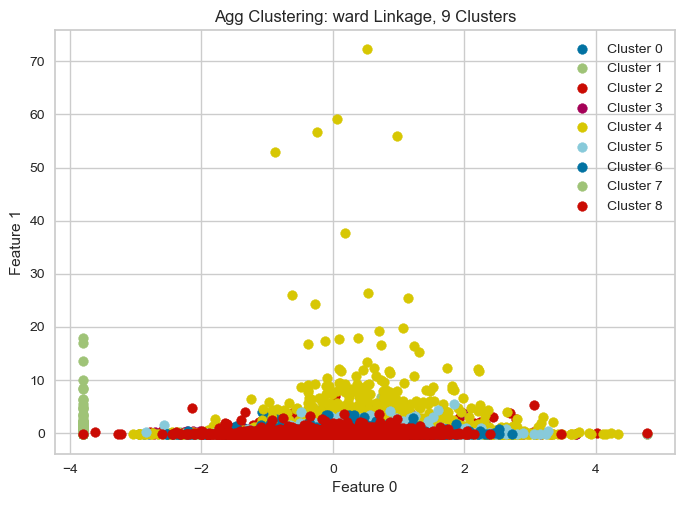

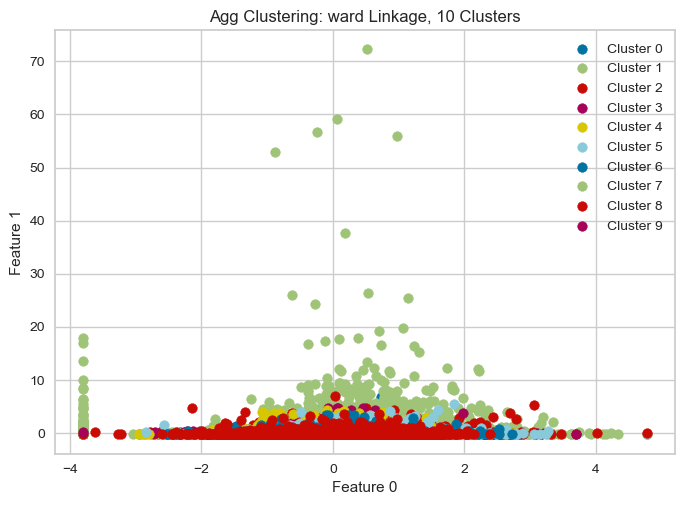

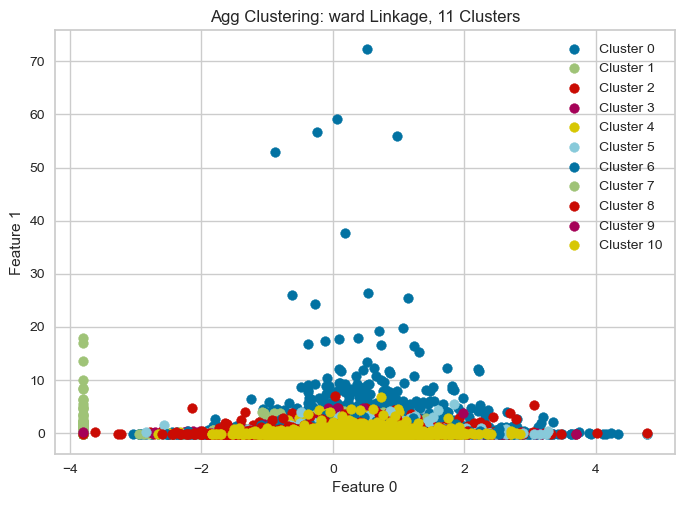

Silhouette Scores for ward linkage: [0.04719703051522329, 0.0593168231401565, 0.053060313773702135, 0.058768950894333184, 0.057757778061823424, 0.0574600527512066, 0.05719342324423517]


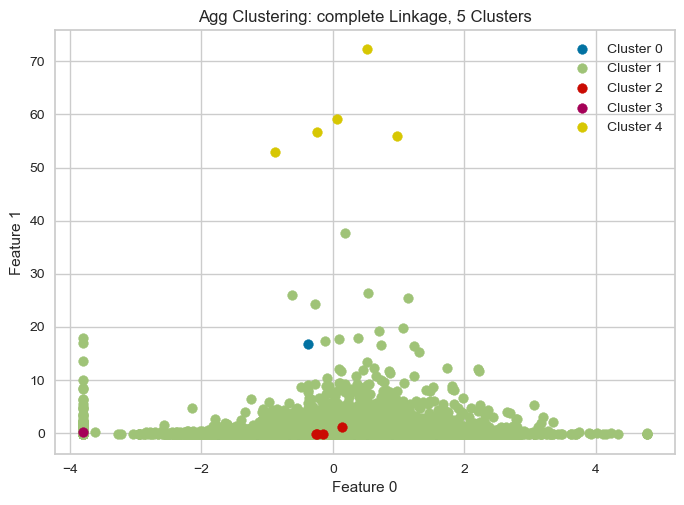

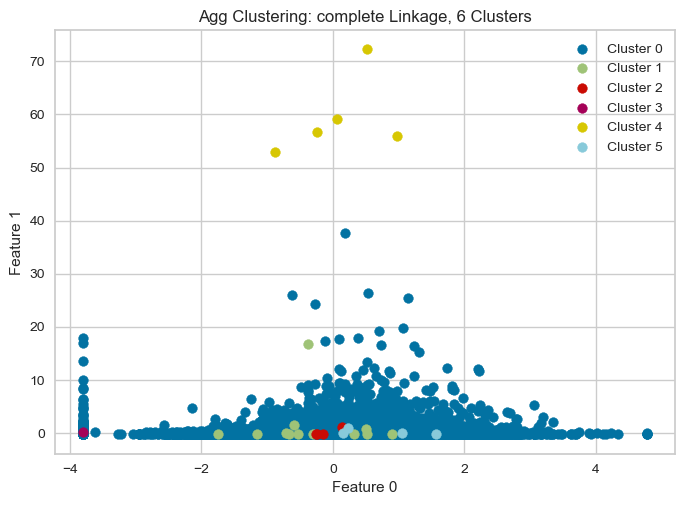

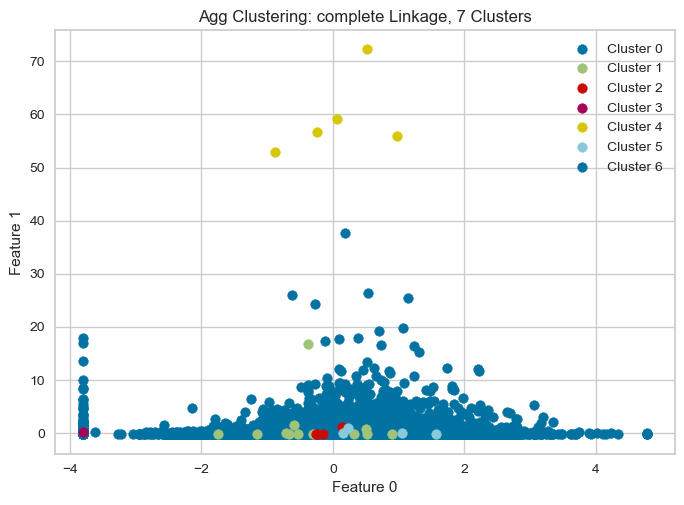

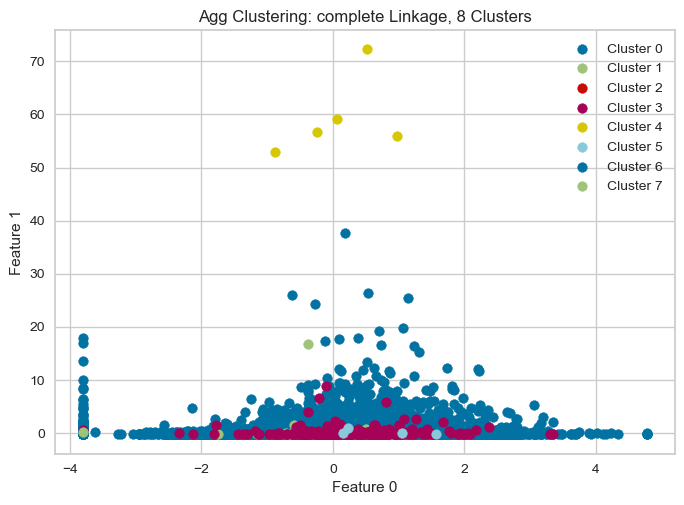

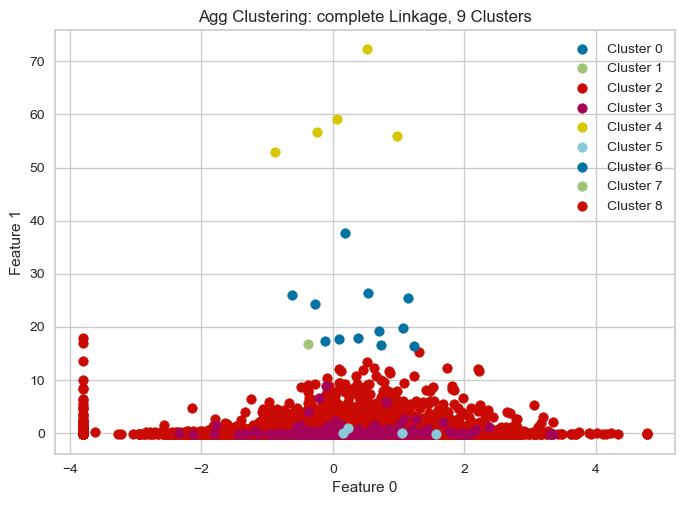

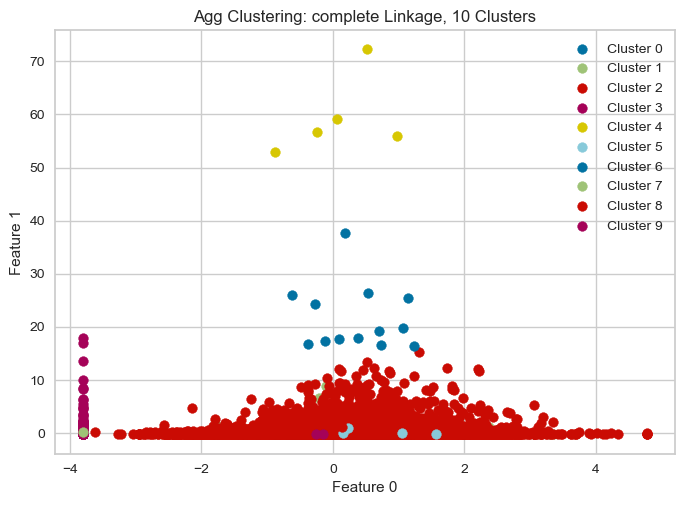

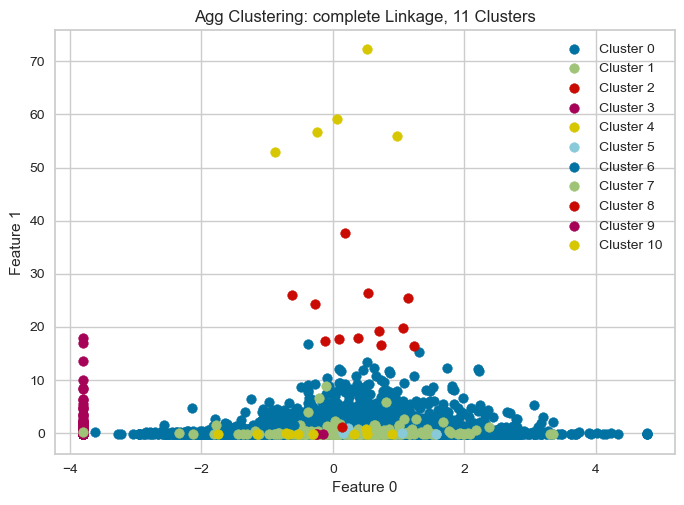

Silhouette Scores for complete linkage: [0.680354980306162, 0.6721272019746035, 0.5699056603444853, 0.269908786917372, 0.2879686956787806, 0.28795779827281054, 0.2879092126279348]


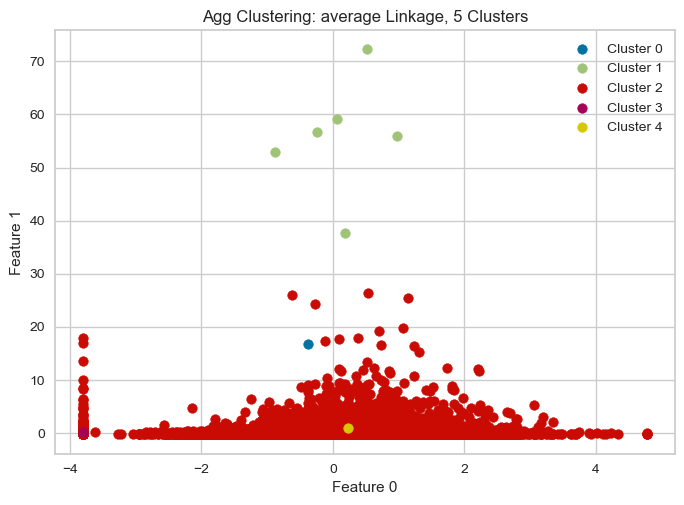

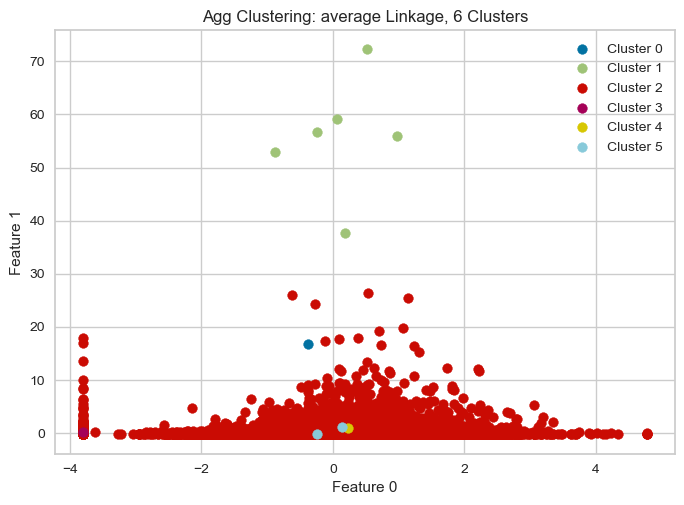

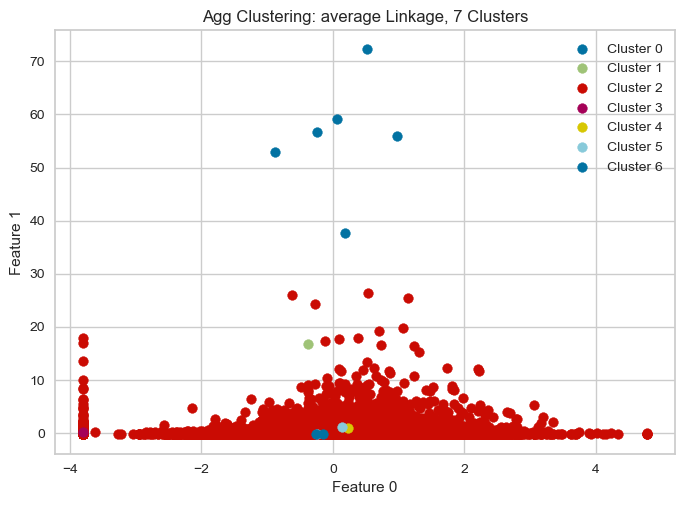

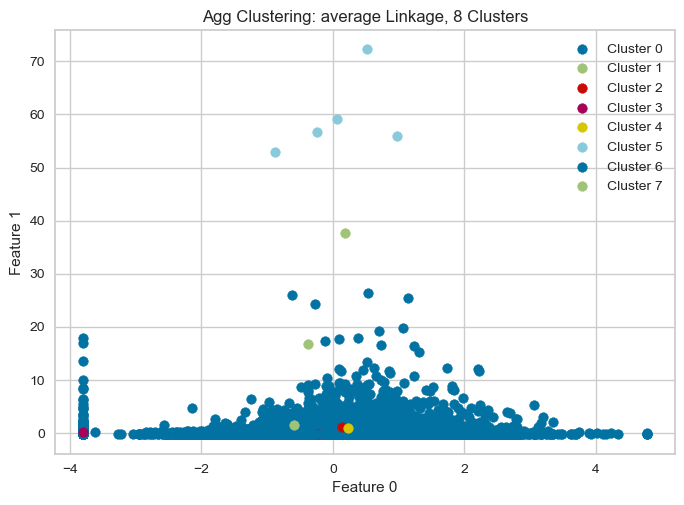

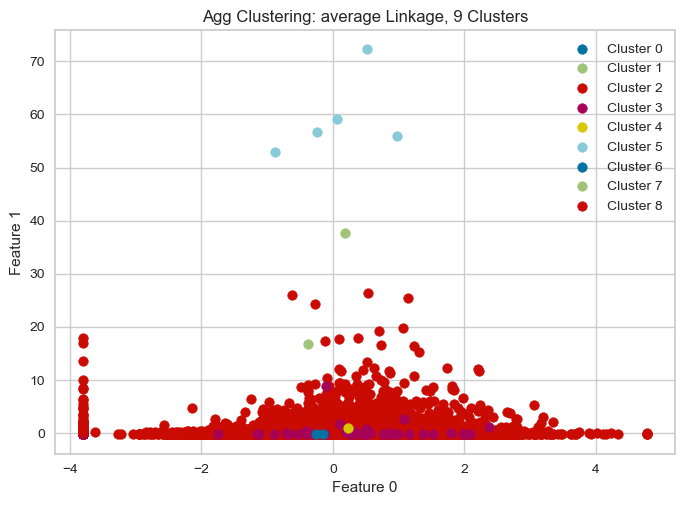

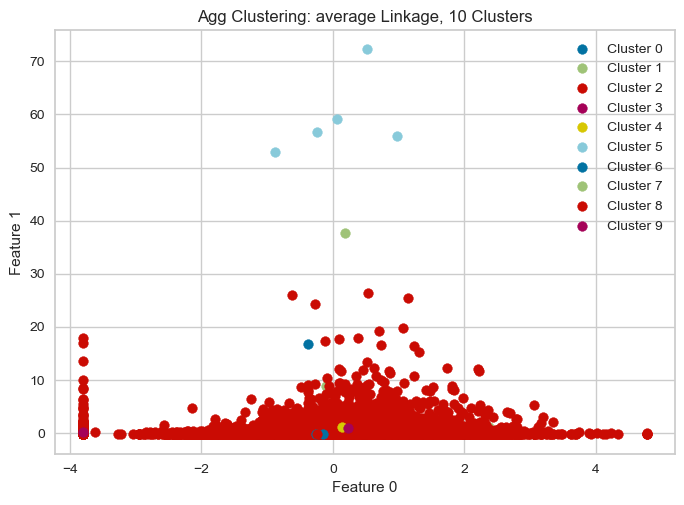

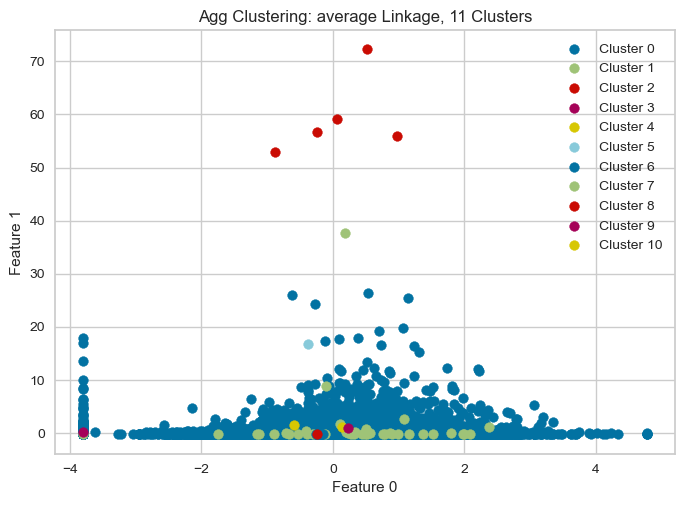

Silhouette Scores for average linkage: [0.7368268149554027, 0.7367877262221442, 0.7366899855769141, 0.7265337689140468, 0.53461850132184, 0.5346060017845208, 0.5345899358148731]


In [127]:
n_clusters_range = range(5, 12)


def agglomerative_silhouette(df1_std, n_clusters=n_clusters_range, linkage='ward'):
    # silhouette score recording 
    silhouette_scores = []

    for n_clusters in n_clusters_range:
        fig, ax = plt.subplots()
        agg_model = AgglomerativeClustering(n_clusters=n_clusters, linkage=linkage)
        
        agg_model.fit(df1_std)
        labels = agg_model.labels_
        
        clusters = np.unique(labels)
        
        for cluster in clusters:
            plt.scatter(df1_std[labels == cluster, 17], df1_std[labels == cluster, 33], label=f'Cluster {cluster}')
            
        # Calculate Silhouette Score
        silhouette_scores.append(silhouette_score(df1_std, labels))
        ax.set_title(f'Agg Clustering: {linkage} Linkage, {n_clusters} Clusters')
        ax.set_xlabel("Feature 0")
        ax.set_ylabel("Feature 1")
        ax.legend()
        
        plt.show()

    return silhouette_scores


# To iterate over different linkages and get scores 
linkages = ["ward", "complete", "average"]
for linkage in linkages:
    scores = agglomerative_silhouette(df1_std, n_clusters=n_clusters_range, linkage=linkage)
    print(f"Silhouette Scores for {linkage} linkage:", scores)

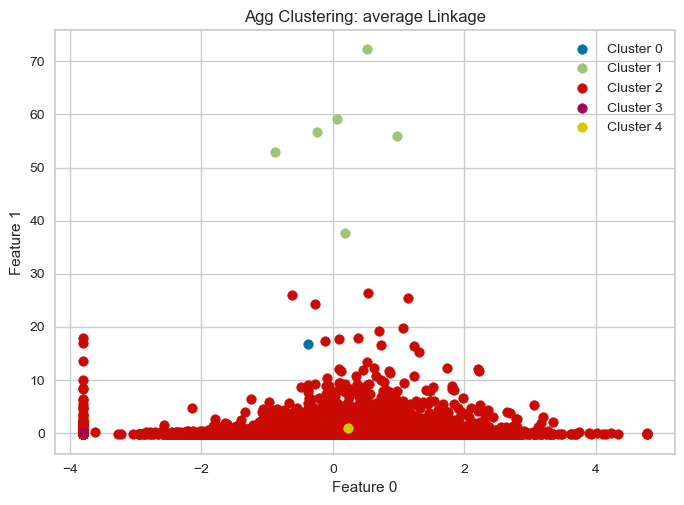

In [128]:
# Agglomerative Clustering model with best performance 5 clusters and the average linkage method 

agg_model = AgglomerativeClustering(n_clusters=5, linkage='average')
    
    # labels = agg_model.fit_predict(df1_std)

agg_model.fit(df1_std)  # Use fit instead of fit_predict
labels = agg_model.labels_


clusters = np.unique(labels)
# Create a new figure and axis here
fig, ax = plt.subplots()

for cluster in clusters:
    plt.scatter(df1_std[labels == cluster, 17], df1_std[labels == cluster, 33], label=f'Cluster {cluster}')
    
# Calculate Silhouette Score

# ax.set_title(f'Agg Clustering: {linkage} Linkage, {metric} Metric')
ax.set_title(f'Agg Clustering: {linkage} Linkage')
ax.set_xlabel("Feature 0")
ax.set_ylabel("Feature 1")
ax.legend()
        
# ACpltW = plt.show()
# ACpltW

plt.show()

     Agglomerative Clustering Results: The approach performed best with the highest silhouette score recorded, 0.7368268149554027 silhouette coefficient with 5 clusters using the average linkage method.  The average linkage merges the two clusters that have the smallest average distance between all their data points.

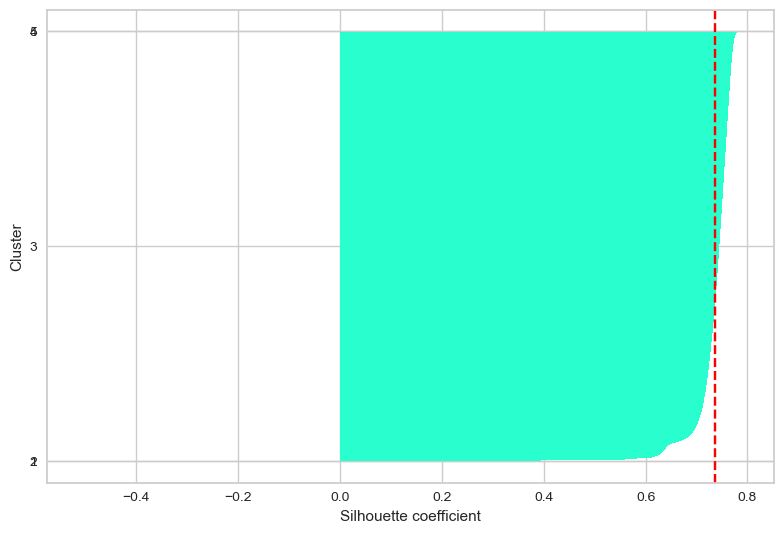

Highest silhouette coefficient/score for the Agglomerative Clustering Model: 0.737


In [13]:
# previously saved graph using 'ward' method
# SCORE THE AGGLOMORATIVE METHOD 
model = AgglomerativeClustering(linkage='average', n_clusters=5)

# Agglomerative clustering has no predict method, to build a model and get clustering memberships on the training set, we have to use the fit_predict method 
y_km = model.fit_predict(df1_std)
# Get the cluster assignments
labels = model.labels_

cluster_labels = np.unique(y_km)
n_clusters = cluster_labels.shape[0]
silhouette_vals = silhouette_samples(df1_std, y_km, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(cluster_labels):
    c_silhouette_vals = silhouette_vals[y_km == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / n_clusters)
    plt.barh(range(y_ax_lower, y_ax_upper),c_silhouette_vals,height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

silhouette_avg = np.mean(silhouette_vals)
plt.axvline(silhouette_avg, color="red", linestyle="--")
plt.yticks(yticks, cluster_labels+1)
plt.tight_layout()

# SACplt = plt.show()
# SACplt
plt.show()

# The silhouette score measures the cohesion within clusters and the separation between clusters. It ranges from -1 to 1, with a higher score indicating a better model. 
print("Highest silhouette coefficient/score for the Agglomerative Clustering Model: %0.3f" % metrics.silhouette_score(df1_std, labels))
# SACplt

    Agglomerative Clustering Results: The agglomerative approach performed best with the highest silhouette score recorded so far with 0.737 silhouette coefficient with 13 clusters using the average linkage method and Euclidean metric. The clusters again much like our previous hierarchical cluserting method seems to be putting a majority of the datapoints into one large cluster with the others not visible. Overall despite the high silohouette score is not the best method for our given datset. 

----
### DBSCAN

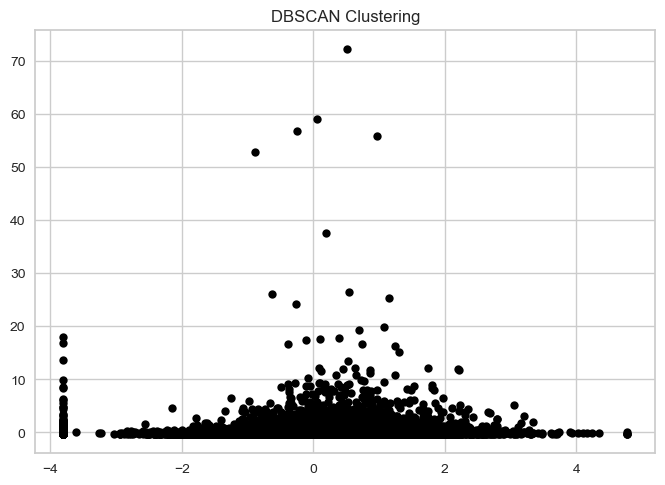

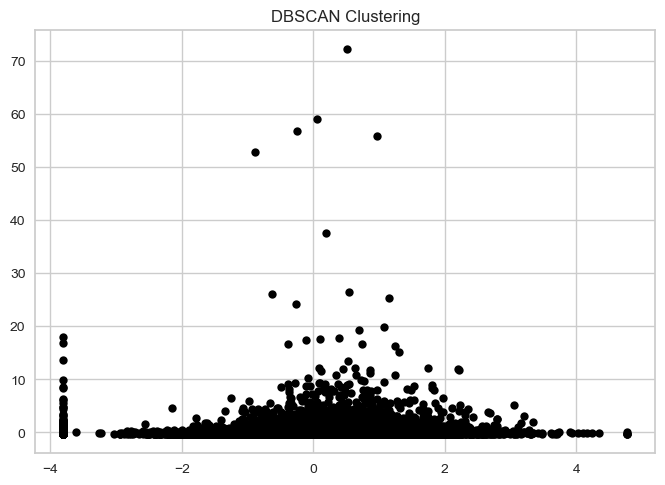

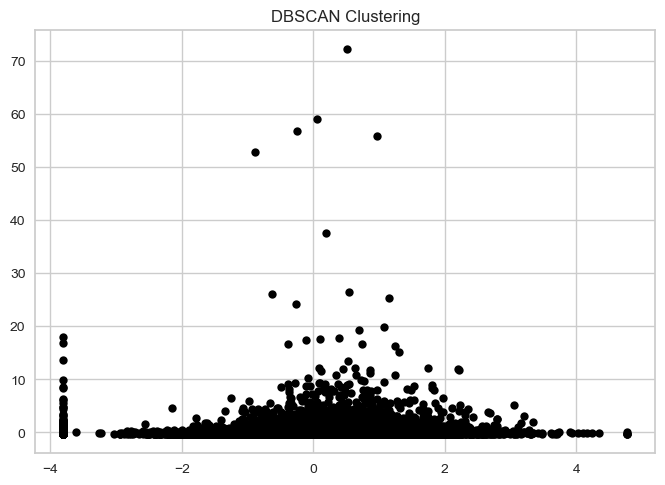

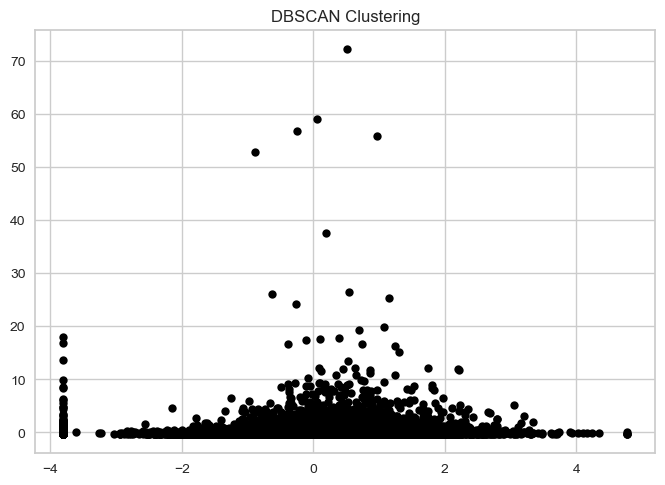

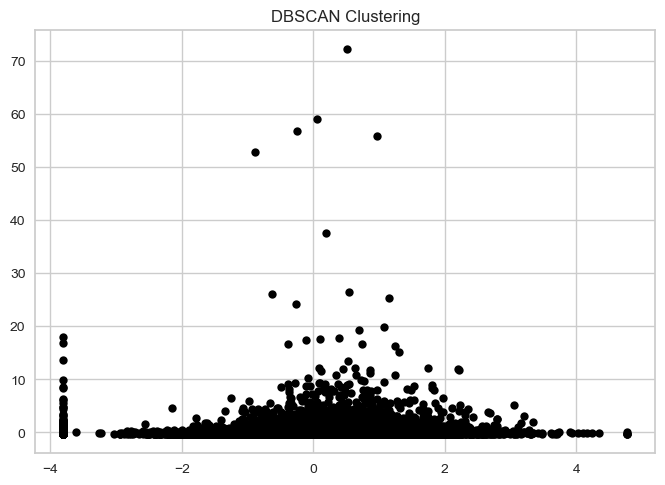

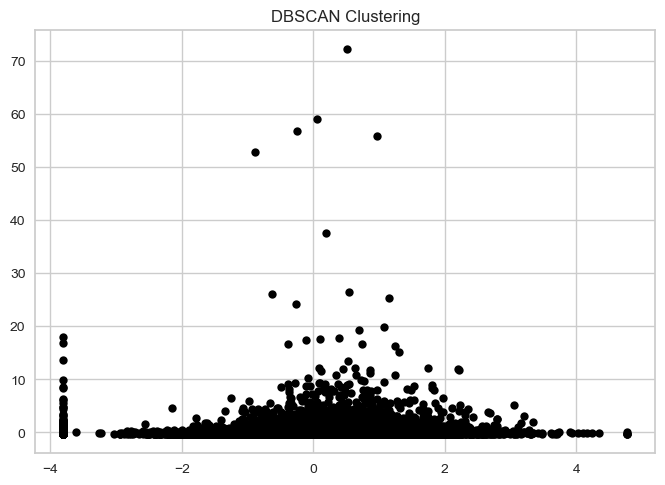

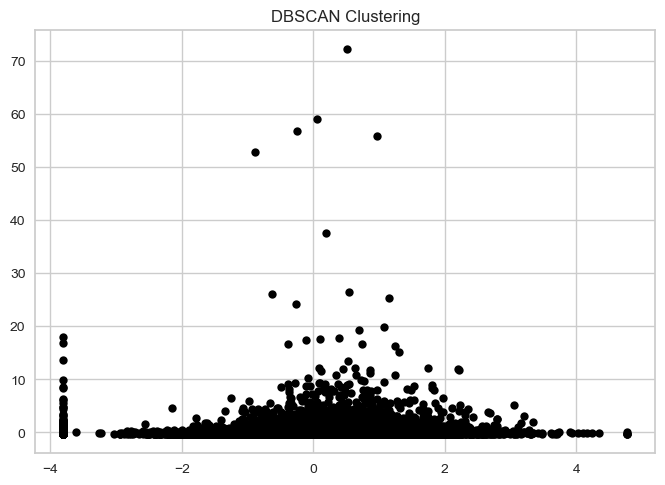

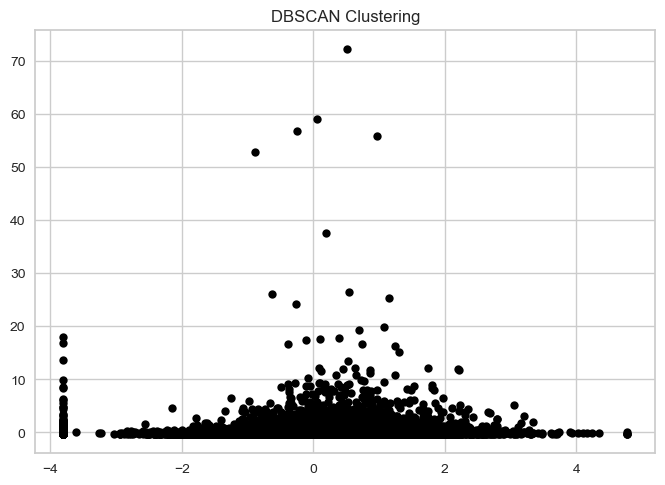

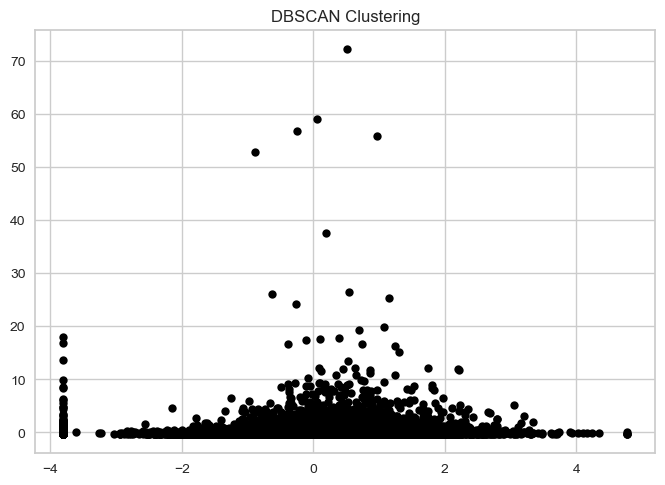

Highest Silhouette Score: 0.7368268149554027
Corresponding EPS: 0.3
Corresponding Min Samples: 5


In [129]:
eps_values = [0.3, 0.5, 0.7]
min_samples_values = [5, 10, 15]
dbscan_silhouette_scores = []

for eps in eps_values:
    for min_samples in min_samples_values:
        dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        cluster_labels = dbscan.fit_predict(df1_std)

        # Store the silhouette score for the current combination of parameters
        dbscan_silhouette_scores.append(silhouette_score(df1_std, labels))

        # Extract cluster labels and core sample indices
        cluster_labels = dbscan.labels_
        core_samples_mask = np.zeros_like(cluster_labels, dtype=bool)
        core_samples_mask[dbscan.core_sample_indices_] = True

        # Number of clusters in labels, ignoring noise if present
        n_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
        n_noise = list(cluster_labels).count(-1)

        # Plot the clusters
        unique_labels = set(cluster_labels)
        colors = [plt.cm.Spectral(each)
                for each in np.linspace(0, 1, len(unique_labels))]
        for k, col in zip(unique_labels, colors):
            if k == -1:
                # Black used for noise.
                col = [0, 0, 0, 1]

            class_member_mask = (cluster_labels == k)

            xy = df1_std[class_member_mask & core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=14)

            xy = df1_std[class_member_mask & ~core_samples_mask]
            plt.plot(xy[:, 17], xy[:, 33], 'o', markerfacecolor=tuple(col),
                    markeredgecolor='k', markersize=6)

        plt.title('DBSCAN Clustering')
        plt.show()

# Find the highest silhouette score and corresponding parameters
highest_silhouette_score = max(dbscan_silhouette_scores)
highest_silhouette_score_index = dbscan_silhouette_scores.index(highest_silhouette_score)
best_eps = eps_values[int(highest_silhouette_score_index / len(min_samples_values))]
best_min_samples = min_samples_values[highest_silhouette_score_index % len(min_samples_values)]

print("Highest Silhouette Score:", highest_silhouette_score)
print("Corresponding EPS:", best_eps)
print("Corresponding Min Samples:", best_min_samples)


In [135]:
# Find the highest silhouette score
highest_dbscan_score = max(dbscan_silhouette_scores)
# Store the highest score in the dictionary
# highest_scores_dict['DBSCAN Clustering:'] = highest_dbscan_score


print("Highest Silhouette Score for DBSCAN with eps=0.3 and min_samples=5: ", highest_dbscan_score)

Highest Silhouette Score for DBSCAN with eps=0.3 and min_samples=5:  0.7368268149554027


    DBSCAN RESULTS: The DBSCAN clustering approach performed well with the same silhouette score as the Agglomerative clustering method 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5. This is a promising result, unfortunately we were unable to visualize each silhouette for each cluster but given DBSCAN method of clustering this seems like the most promising method to cluster our dataset. 

In [ ]:
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.pyplot as plt
import numpy as np

# Use the best-performing parameters from DBSCAN
best_dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
best_cluster_labels = best_dbscan.fit_predict(df1_std)

# Compute silhouette scores
best_silhouette_avg = silhouette_score(df1_std, best_cluster_labels)
best_silhouette_vals = silhouette_samples(df1_std, best_cluster_labels, metric='euclidean')

# Plot silhouette analysis
y_ax_lower, y_ax_upper = 0, 0
yticks = []

unique_best_labels = np.unique(best_cluster_labels)
n_clusters_best = unique_best_labels.shape[0]

for i, c in enumerate(unique_best_labels):
    c_silhouette_vals = best_silhouette_vals[best_cluster_labels == c]
    c_silhouette_vals.sort()
    
    y_ax_upper += len(c_silhouette_vals)
    color = plt.cm.Spectral(float(i) / n_clusters_best)
    
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

plt.axvline(best_silhouette_avg, color="red", linestyle="--")
plt.yticks(yticks, unique_best_labels + 1)
plt.title('DBSCAN Silhouette Analysis')
plt.tight_layout()

# Display the silhouette analysis plot
plt.show()

# Print the silhouette score for the DBSCAN model with the best parameters
print("Highest silhouette coefficient/score for the DBSCAN Model: %0.3f" % best_silhouette_avg)


----
### Fuzzy C-Means Clustering

    Fuzzy C-Means Clustering - another type of unsupervised learning alogorithm that is an extension of K-means and is also known as soft-Kmeans clustering. The name alludes to the way the algorithm allows a point to have a varying degree of membership in each cluster. This method balances the distance between the a given point and the centroid of the cluster and the degree of each membership of each point in each cluster. This makes FCM particularly useful when dealing with data points that may very well belong to more than one group simultaneously. 

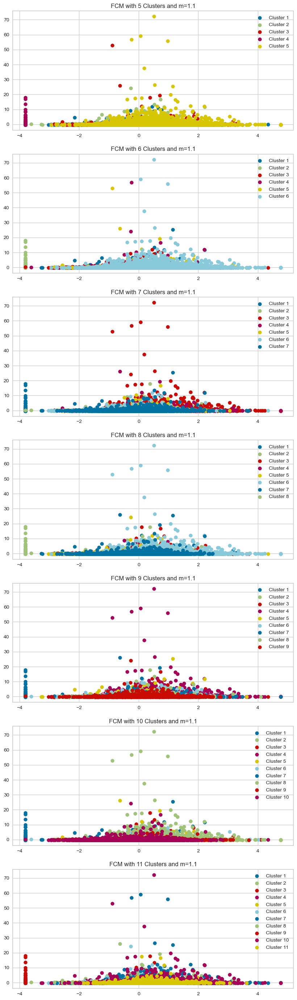

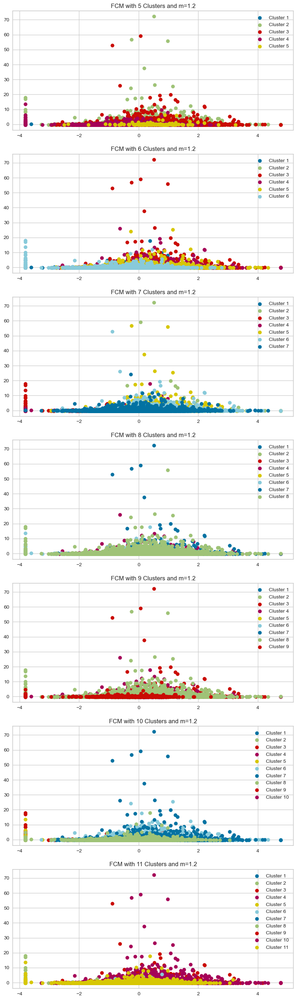

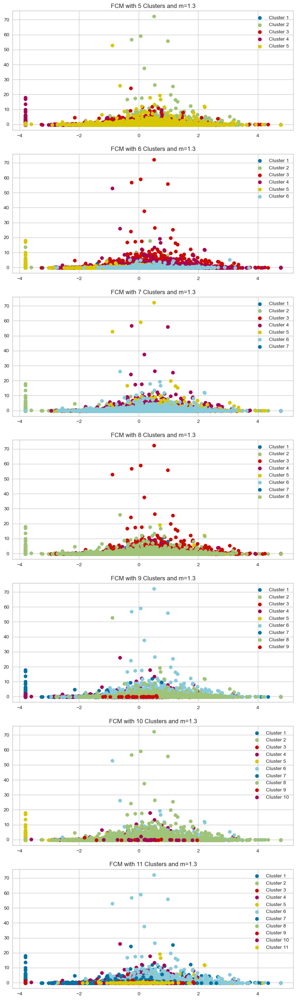

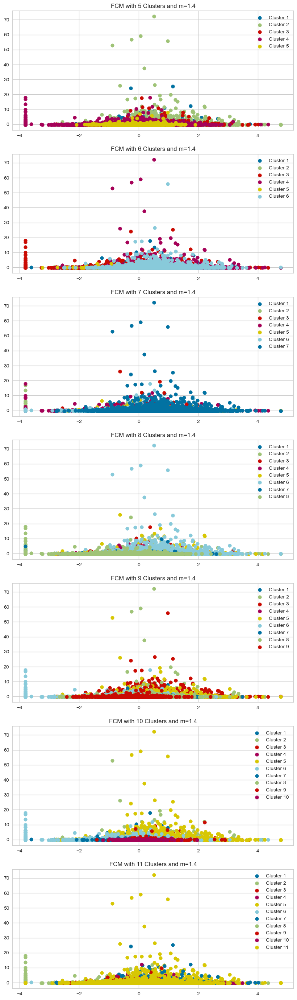

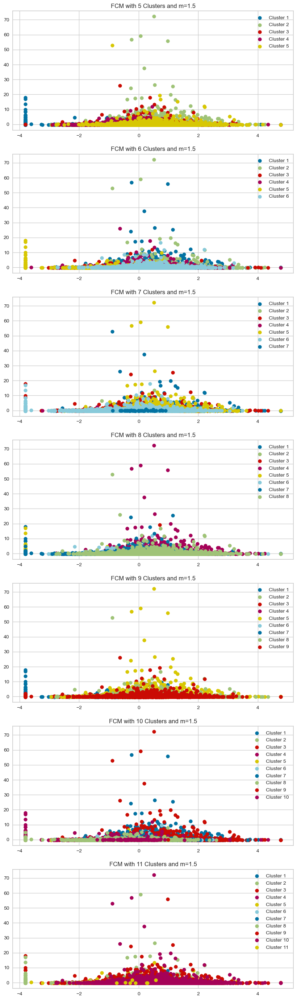

Silhouette Scores for each model: [0.07301689215081322, 0.08605643684057994, 0.0969210403769712, 0.10021080691457933, 0.0992662027922817, 0.09399287427278954, 0.10221592034044073, -0.00037112620679937704, 0.030029279639862305, -0.06139378709416986, -0.08667251062772544, -0.09903273007496902, -0.06215467715126239, -0.06448124026641507, -0.01646232042289872, -0.037503326794070806, -0.008018422008176132, -0.05730791115426271, -0.07274665753216583, -0.04268983834100814, -0.02728665386076854, -0.03689670971600381, -0.0166432997807449, 0.024892882718269928, -0.004145327003624386, -0.05777353735648334, -0.06983325031688542, -0.06697206706899986, 0.015848930374765282, 0.012495003184575334, -0.05355248095042835, -0.005902320193976051, 0.0035135018866944557, -0.0736311785257469, -0.03622174455626434]
Highest FCM Clustering Model Silhouette Score is 5 clusters an m_value of 1.2: 0.10221592034044073


In [148]:
# Fuzzy C-Means Clustering - visualize, score it (there are other scoring methods too)
# # Number of clusters

n_clusters_range = range(5, 12)
m_values = [1.1, 1.2, 1.3, 1.4, 1.5]

def fcm_silhouette(df1_std, n_clusters_range=n_clusters_range, m_values=m_values):
    # silhouette score recording
    silhouette_scores = []

    # Create separate figures and subplots for each iteration
    for m_value in m_values:
        fig, axs = plt.subplots(len(n_clusters_range), 1, figsize=(10, 5 * len(n_clusters_range)))

        for i, n_clusters in enumerate(n_clusters_range):
            ax = axs[i]
            ax.set_title(f'FCM with {n_clusters} Clusters and m={m_value}')

            cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(df1_std.T, n_clusters, m_value, error=0.005, maxiter=1000)

            # Assign each data point to the cluster with the highest membership value
            cluster_membership = np.argmax(u, axis=0)

            # Plotting the results
            for j in range(n_clusters):
                ax.scatter(df1_std[cluster_membership == j, 17], df1_std[cluster_membership == j, 33], label=f'Cluster {j + 1}', marker='o')

            ax.legend()
            # ax.set_xlabel('Feature 17')
            # ax.set_ylabel('Feature 33')

            # Calculate Silhouette Score
            silhouette_scores.append(silhouette_score(df1_std, cluster_membership))

        plt.show()  # Display the plot after each iteration

    return silhouette_scores

# Assuming you have 'df1_std' defined
scores = fcm_silhouette(df1_std)

print("Silhouette Scores for each model:", scores)
# 19 FCM Optimized model with highest silhouette score 

######################################################

# Find the highest silhouette score
highest_fcm_score = max(scores)
# Store the highest score in the dictionary
# highest_scores_dict['FCM Clustering:'] = highest_fcm_score


print("Highest FCM Clustering Model Silhouette Score is 5 clusters an m_value of 1.2:", highest_fcm_score)
#################################

    FCM and K-means in practice typically produce  very similar results in practice but given FCM's leniency  towards clustering data points it outperformed the best K-means++ model we created earlier. 




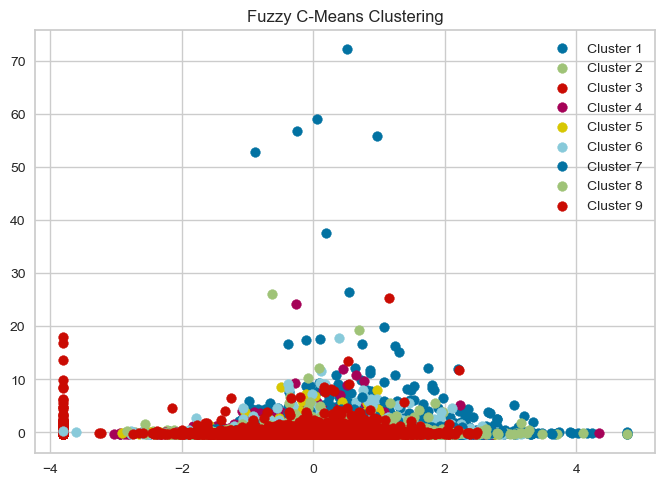

Highest FCM Clustering Model Silhouette Score is 9 clusters an m_value of 1.1: 0.10221592034044073


In [149]:
# Best Fuzzy C-Means Clustering - visualize, score it (there are other scoring methods too)

n_clusters=9
m_value=1.1
# # Fuzzy c-means algorithm
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(df1_std.T, n_clusters, m_value, error=0.005, maxiter=1000)


# # Assign each data point to the cluster with the highest membership value
cluster_membership = np.argmax(u, axis=0)

# # Plotting the results
fig, ax = plt.subplots()
for j in range(n_clusters):
    ax.scatter(df1_std[cluster_membership == j, 17], df1_std[cluster_membership == j, 33], label=f'Cluster {j + 1}', marker='o')

ax.legend()
# plt.xlabel('Feature 1')
# plt.ylabel('Feature 2')
plt.title('Fuzzy C-Means Clustering')
plt.show()
plt.show()
print("Highest FCM Clustering Model Silhouette Score is 9 clusters an m_value of 1.1:", highest_fcm_score)

    FCM Clustering Results: The FCM clustering method produced a silhouette score of 0.10301753918726955 with 10 clusters and m_value of 1.1. 

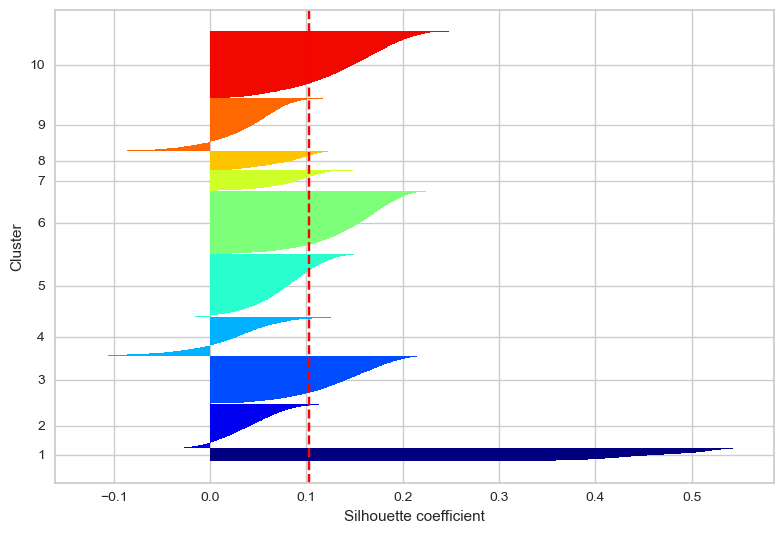

In [167]:
# FCM Silouette Analysis 

# Number of clusters for FCM
n_clusters = 10
m_value = 1.1

# Fuzzy c-means algorithm
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(df1_std.T, n_clusters, m_value, error=0.005, maxiter=1000)

# Assign each data point to the cluster with the highest membership value
cluster_membership_fcm = np.argmax(u, axis=0)

# Silhouette score bar chart for FCM
silhouette_vals_fcm = silhouette_samples(df1_std, cluster_membership_fcm, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(np.unique(cluster_membership_fcm)):
    c_silhouette_vals = silhouette_vals_fcm[cluster_membership_fcm == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / len(np.unique(cluster_membership_fcm)))
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

silhouette_avg_fcm = np.mean(silhouette_vals_fcm)
plt.axvline(silhouette_avg_fcm, color="red", linestyle="--")
plt.yticks(yticks, np.unique(cluster_membership_fcm) + 1)
plt.tight_layout()
plt.show()



        Silouette Analysis FCM Clustering: 
                The resulting plot shows the average silhouette coefficient at 0.10301753918726955 as a red dotted line , with each silohouette with different lengths and widths; both the low average coeffcient and the variation are evidence that the GMM Clustering method performed suboptimally. An average silhouette average coefficient closer to 1 and more similarity in length and width in the silhouettes would have been more ideal. Further evidence of poor clustering cna be seen with the clusters that go below zero, suggestign that there were decision boundary issues and struggled to cluster the datapoints. 

----
### Gaussian Mixture Model

        GMM - A Gaussian Mixture Model is a another method that will try to find a mix of multi-dimensional Gaussian probability distributions that best model any feature in the dataset. 

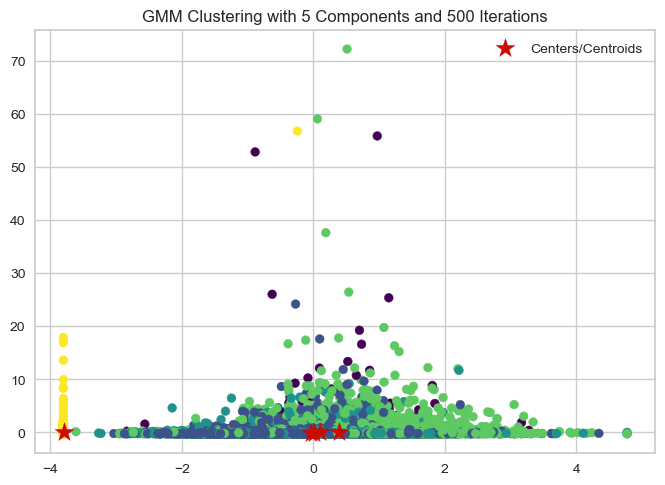

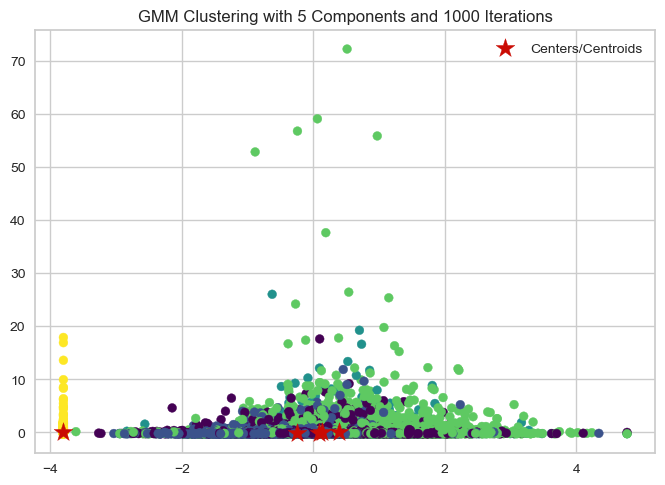

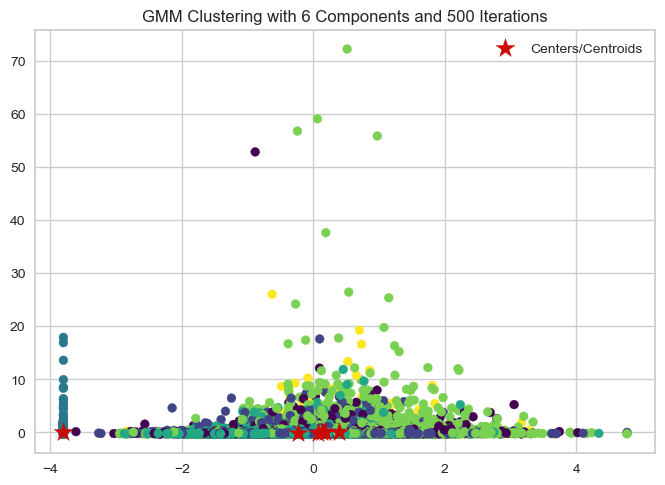

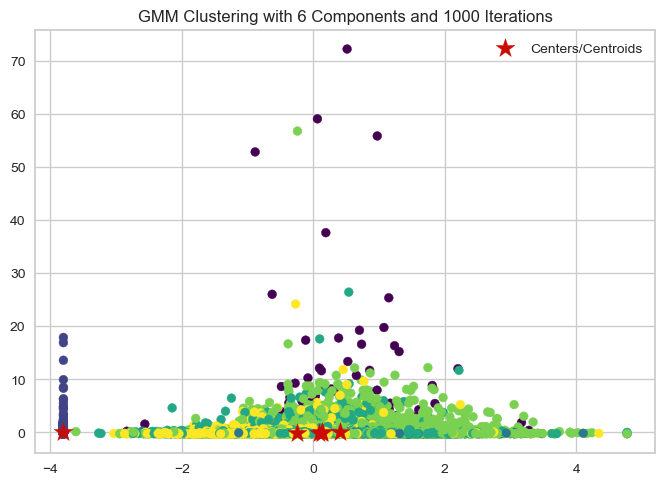

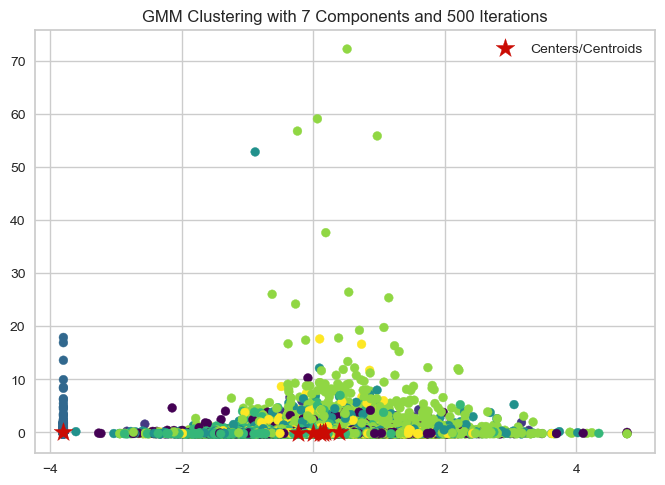

...

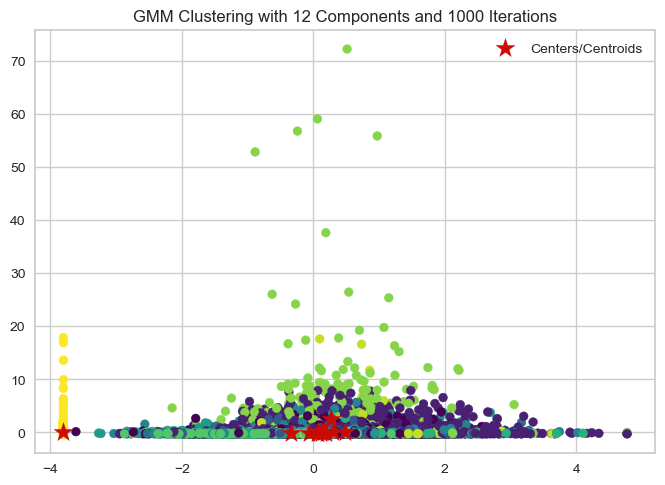

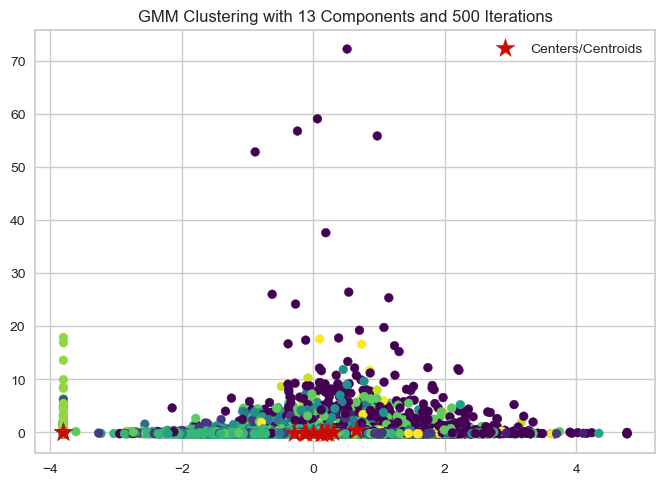

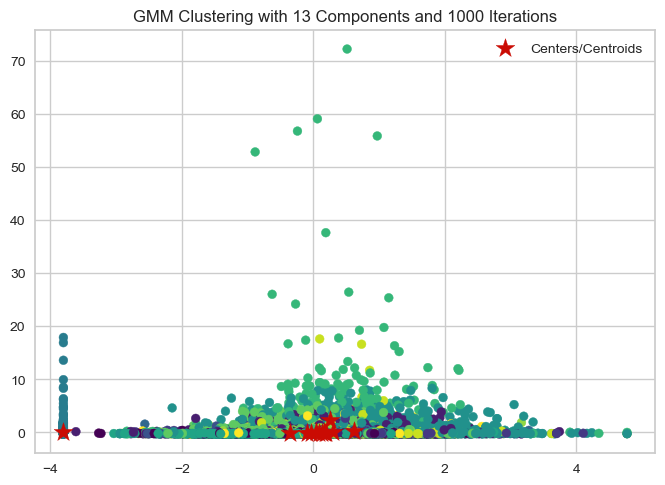

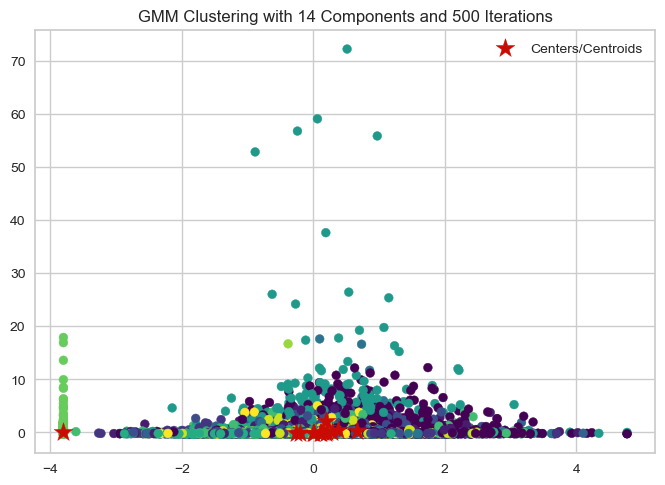

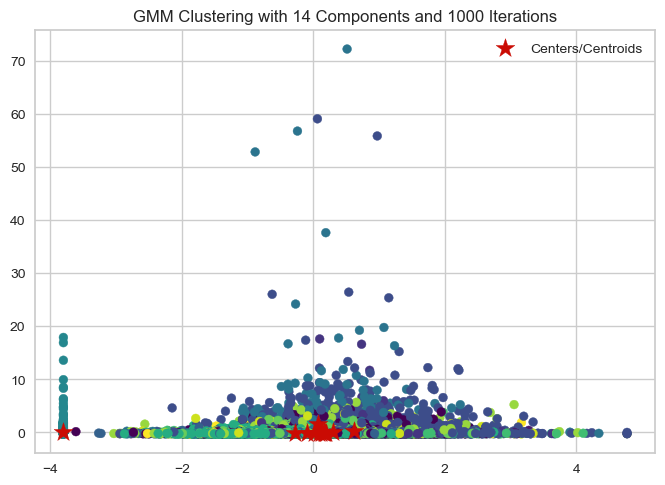

GMM Silhouette Scores for each model: [0.07886355467281056, 0.07396253590409206, 0.06876148695131658, 0.07913365547435454, 0.07980752616445352, 0.07879061608993837, 0.09394426925037151, 0.07031320008343425, 0.09348610333183072, 0.09615358483447663, 0.10006561509748843, 0.0991936637649791, 0.1017499119063997, 0.09665181356599746, 0.09774959065171569, 0.0846686262266972, 0.059433543424651486, 0.06683533996715517, 0.0923797214274855, 0.0896885685274981]


In [150]:
# GMM optimized model / silhouette scoring 

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_silhouette(df1_std, n_components_range, max_iters):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Predict cluster labels
            labels = gmm.predict(df1_std)

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot

    return silhouette_scores


########
# Assuming you have 'df1_std' defined
scores = gmm_silhouette(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("GMM Silhouette Scores for each model:", scores)

In [151]:
# Find the highest silhouette score
highest_gmm_score = max(scores)
# Store the highest score in the dictionary
print("Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations", highest_gmm_score)

Highest GMM Clustering Model Silhouette Score is 10 clusters 1000 max_iterations 0.1017499119063997


    GMM Clustering (Silhouette Score) Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.10731105780431043.

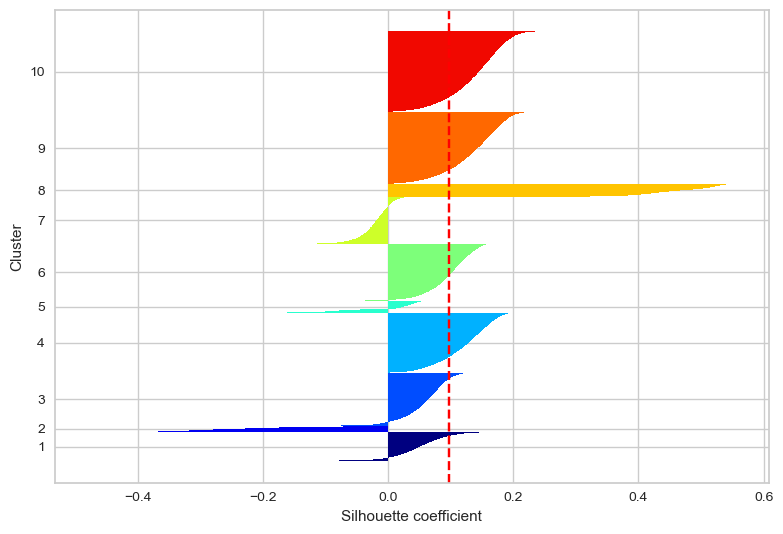

In [169]:
# Number of components for GMM
n_components = 10  # Adjust as needed

# Create GMM model
gmm = GaussianMixture(n_components=n_components, max_iter=1000)

# Fit the GMM model
gmm.fit(df1_std)

# Predict the cluster assignments
cluster_membership_gmm = gmm.predict(df1_std)



# Silhouette score bar chart for GMM
silhouette_vals_gmm = silhouette_samples(df1_std, cluster_membership_gmm, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(np.unique(cluster_membership_gmm)):
    c_silhouette_vals = silhouette_vals_gmm[cluster_membership_gmm == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / len(np.unique(cluster_membership_gmm)))
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

silhouette_avg_gmm = np.mean(silhouette_vals_gmm)
plt.axvline(silhouette_avg_gmm, color="red", linestyle="--")
plt.yticks(yticks, np.unique(cluster_membership_gmm) + 1)
plt.tight_layout()
plt.show()



    Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.107311.

    Silouette Analysis GMM Clustering: 
        The resulting plot shows the average silhouette coefficient at 0.107311, with each silohouette with different lengths and widths; both the low average coeffcient and the variation are evidence that the GMM Clustering method performed suboptimally. An average silhouette average coefficient closer to 1 and more similarity in length and width in the silhouettes would have been more ideal. Further evidence of poor clustering cna be seen with the clusters that go below zero, suggestign that there were decision boundary issues and struggled to cluster the datapoints. 

----
### OPTICS Clustering

    OPTIC Clustering -- Ordering Points To Identify Clustering Structure a density based unsupervised learning algorithm similar to DBSCAN. OPTICS unlike DBSCAN deos not require the density to be consistent across a dataset, so for OPTICS we can discard eps (constant distance parameter).

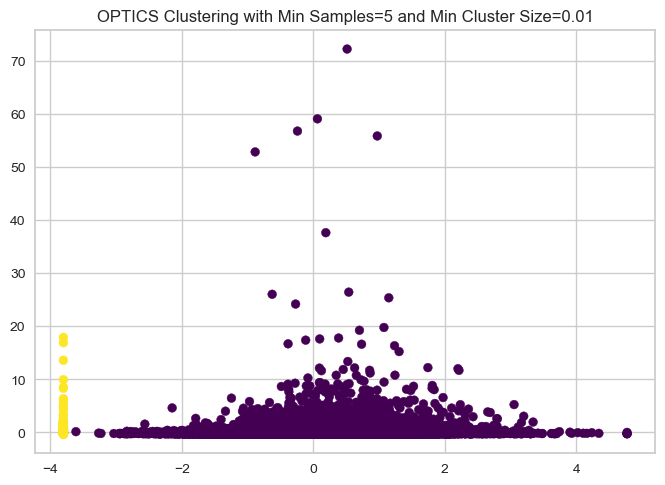

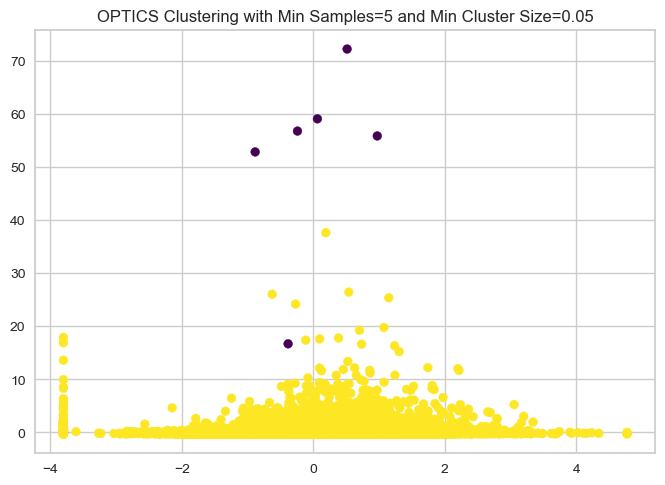

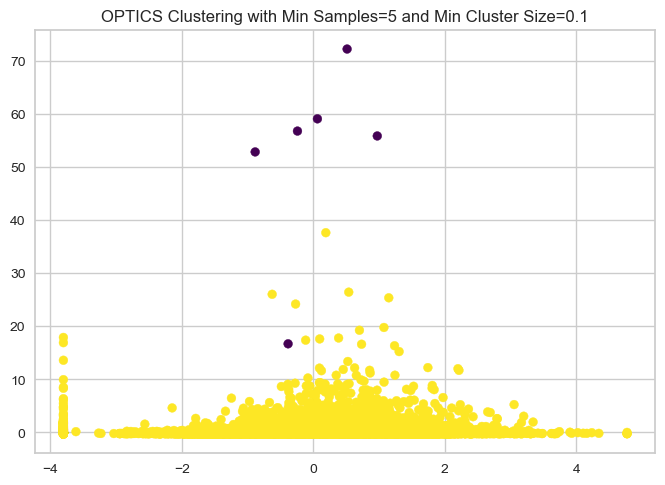

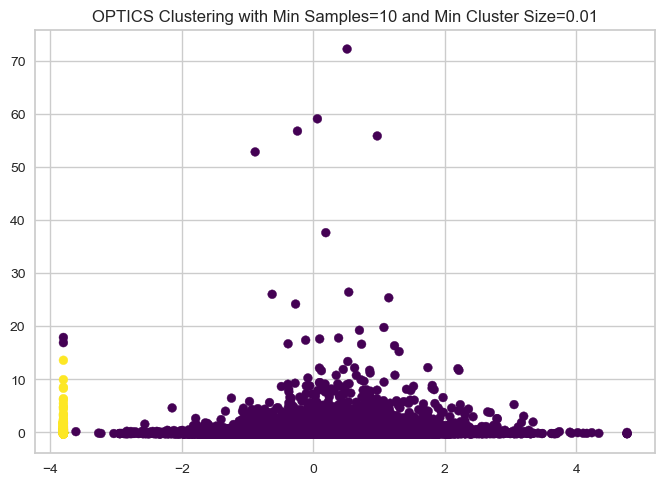

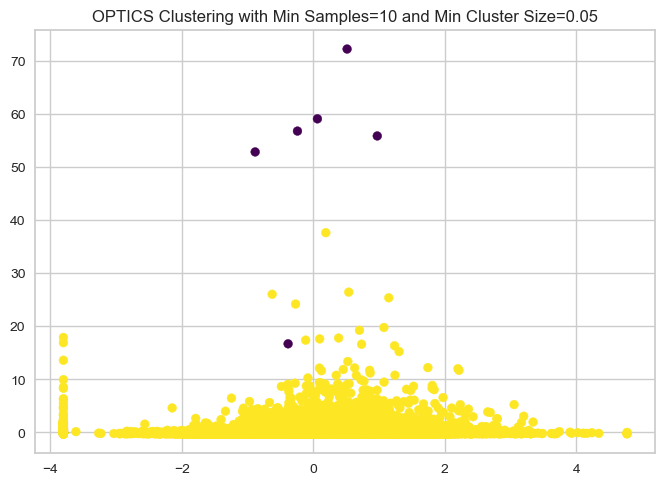

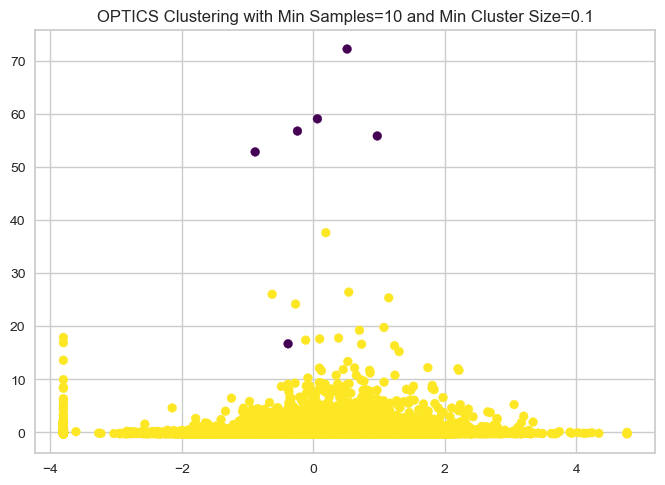

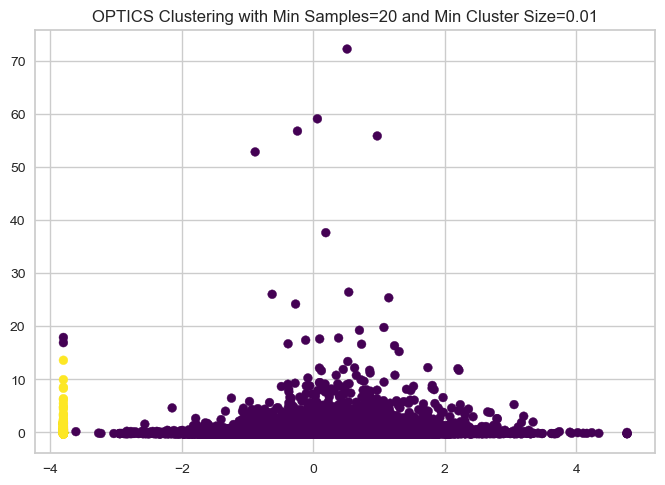

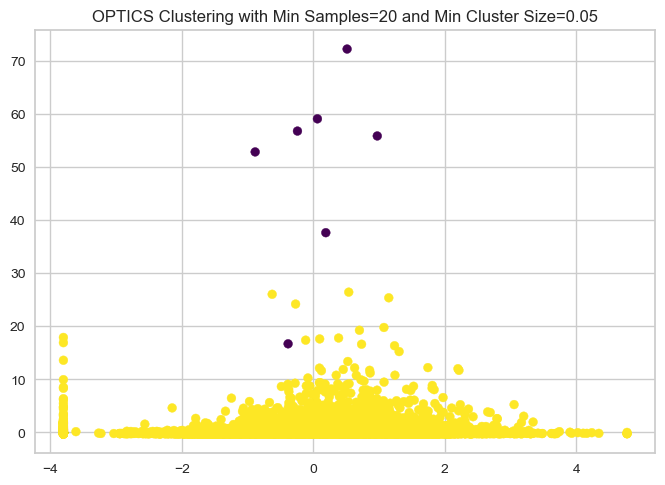

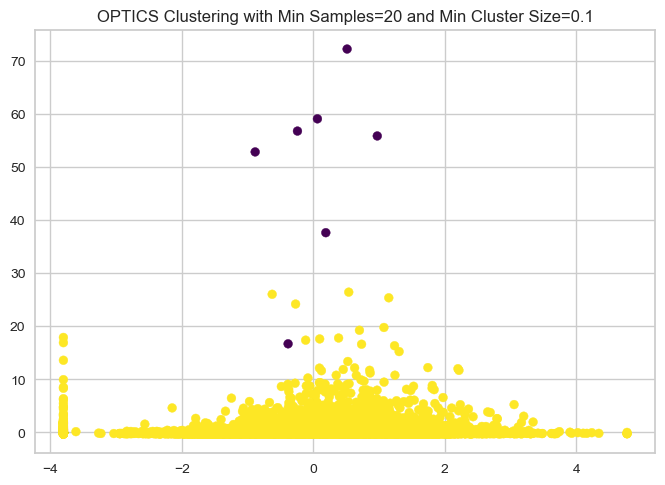

Silhouette Scores for each model: [0.34998401805977897, 0.6145937682246868, 0.6145937682246868, 0.34941581095555113, 0.6145937682246868, 0.6145937682246868, 0.34929496109599084, 0.6163235629937397, 0.6163235629937397]


In [153]:
# OPTICS clustering hyper parameter tuning 

min_samples_values = [5, 10, 20]
min_cluster_size_values = [0.01, 0.05, 0.10]

def optics_silhouette(df1_std, min_samples_values, min_cluster_size_values):
    # silhouette score recording
    silhouette_scores = []

    # Iterate over different min_samples and min_cluster_size values
    for min_samples_value in min_samples_values:
        for min_cluster_size_value in min_cluster_size_values:
            
            # Fit the OPTICS model
            clustering = OPTICS(min_samples=min_samples_value, min_cluster_size=min_cluster_size_value)
            clustering.fit(df1_std)
            
            # Extract the clusters
            labels = clustering.labels_

            # Calculate silhouette score
            silhouette_score_value = silhouette_score(df1_std, labels)
            silhouette_scores.append(silhouette_score_value)

            # Create a plot to visualize the clusters
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=labels, s=40, cmap='viridis', alpha=1.0)
            plt.title(f"OPTICS Clustering with Min Samples={min_samples_value} and Min Cluster Size={min_cluster_size_value}")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.show()  # Display the plot

    return silhouette_scores

# Assuming you have 'df1_std' defined
scores = optics_silhouette(df1_std, min_samples_values, min_cluster_size_values)

print("Silhouette Scores for each model:", scores)

In [41]:
optics_highest_sil_score = max(scores)

print("Highest OPTICS Clustering Model silhouette score with 5-10 min_samples and cluster size 0.5 components", optics_highest_sil_score)

Highest OPTICS Clustering Model silhouette score with 20 min_samples and min cluster size 0.5 0.6163235629937397


    Results: The OPTICS clustering model produced an optimized model with 20 min_samples and min cluster size 0.5 components with a silhouette score of 0.6145937682246868. This represents our second best performing model. 

Cluster Labels: [-1 -1 -1 ...  0  0  0]
Cluster memberships:
[-1 -1 -1 ...  0  0  0]


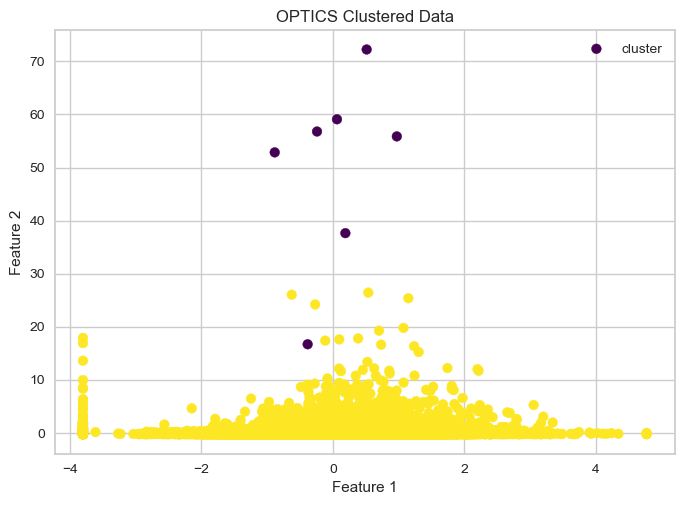

In [168]:
# Plot OPTICS
# Best performing OPTICS Model with the following hyperparameters

clustering = OPTICS(min_samples=20, xi=.05, min_cluster_size=.05)
clustering.fit(df1_std)

# Extract the clusters
labels = clustering.labels_

# Print the cluster labels
print("Cluster Labels:", labels)

print("Cluster memberships:\n{}".format(clustering.labels_))

plt.scatter(df1_std[:, 17], df1_std[:, 33], c=clustering.labels_, cmap="viridis")

# Calculate the number of clusters
num_clusters = len(np.unique(labels))
# Update the legend with the number of clusters
plt.legend(["cluster"] * num_clusters, loc='best')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('OPTICS Clustered Data')
plt.show()

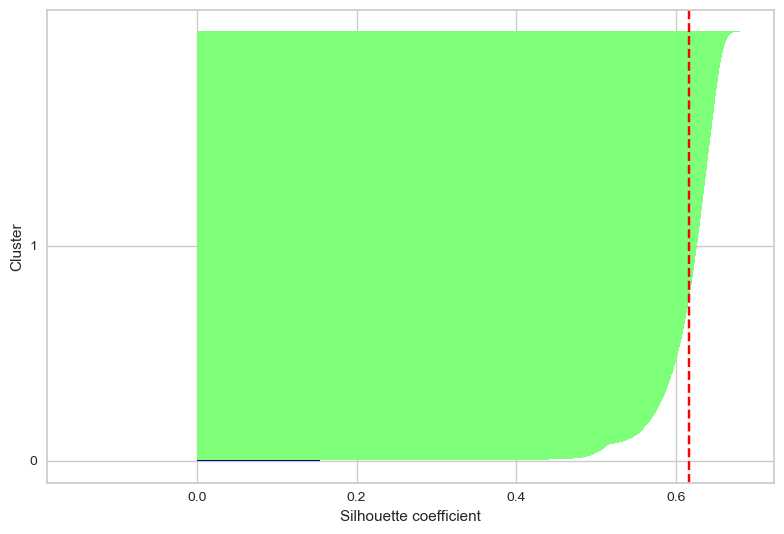

Highest silhouette coefficient/score for OPTICS Clustering: 0.616


In [43]:
# Create OPTICS model
clustering = OPTICS(min_samples=20, xi=.05, min_cluster_size=.05)

# Fit the OPTICS model
clustering.fit(df1_std)

# Predict the cluster assignments
cluster_membership_optics = clustering.labels_

# Silhouette score bar chart for OPTICS
silhouette_vals_optics = silhouette_samples(df1_std, cluster_membership_optics, metric='euclidean')
y_ax_lower, y_ax_upper = 0, 0
yticks = []

for i, c in enumerate(np.unique(cluster_membership_optics)):
    c_silhouette_vals = silhouette_vals_optics[cluster_membership_optics == c]
    c_silhouette_vals.sort()
    y_ax_upper += len(c_silhouette_vals)
    color = cm.jet(float(i) / len(np.unique(cluster_membership_optics)))
    plt.barh(range(y_ax_lower, y_ax_upper), c_silhouette_vals, height=1.0, edgecolor='none', color=color)
    yticks.append((y_ax_lower + y_ax_upper) / 2.)
    y_ax_lower += len(c_silhouette_vals)

plt.xlabel('Silhouette coefficient')
plt.ylabel('Cluster')

silhouette_avg_optics = np.mean(silhouette_vals_optics)
plt.axvline(silhouette_avg_optics, color="red", linestyle="--")
plt.yticks(yticks, np.unique(cluster_membership_optics) + 1)
plt.tight_layout()
plt.show()

# The silhouette score measures the cohesion within clusters and the separation between clusters.
print("Highest silhouette coefficient/score for OPTICS Clustering: %0.3f" % silhouette_avg_optics)

        Silouette Analysis OPTICS Clustering: 
                The resulting plot shows the average silhouette coefficient at 0.616, with each silohouette with different lengths and widths. We can see that there is one large cluster that is dominating the other clusters in the dataset an indication that most datapoints have been labled inot one cluster. This is most likely not the optimal method to use for our dataset. 

___
___
<a href="#top">Back to Top</a>
<a id="ModelEval4"></a>
## Modeling and Evaluation 4 
Summarize the Ramifications

----

In [62]:


df_highest_scores = pd.DataFrame(list(highest_scores_dict.items()), columns=['Clustering Method', 'Score'])
df_highest_scores = df_highest_scores.sort_values(by='Score', ascending=False)

# Set the option to display all rows, columns, and prevent truncation of column content
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

# Print the DataFrame
print(df_highest_scores)

# Reset the options to default (optional)
pd.reset_option('display.max_rows')
pd.reset_option('display.max_columns')
pd.reset_option('display.max_colwidth')

                                  Clustering Method     Score
2  Agglomerative Clustering: average linkage method  0.736827
3                                DBSCAN Clustering:  0.736827
6                               Optics Clustering :  0.614594
5                                   GMM Clustering:  0.107311
4                                   FCM Clustering:  0.103018
0                                          Kmeans++  0.098065
1        Hierarchal Clustering: ward linkage method  0.059317



    K-means++ Clustering Results: 
        For a K-mean++ clustering method, the proper optimized number of components (k) for this dataset is 7 for either optimization method with a silhouette score 0.098. The results were quite poor. Ideally a silhouette score closer to 1 is needed to indicate a good concise clustering. K-meant++ model struggled to correctly cluster the Mashable dataset even after hyper parameter optimization. 
        -Silouetee Analysis:
            The average silhouette coefficient is indicated by the red dotted line. The red clustering (Cluster 7) performed best (above average) which indicates it is relatively well-separated and cohesive thus the data points more similar to each other than they are to data points in neighboring clusters. The resulting plot shows that overall the silhouettes are visibly different lengths and widths which is indicative of sub-optimal clustering. We also have clusters that go below zero indicating that these clusters were on a decision boundary and struggled to cluster the points. 

        Ideally we would want the silhouette coefficient should be closer to 1 to indicate better quality of clustering. 
    
    Hierarchical / Agglomerative Clustering Results: 
        Hierarchical Clustering Results: The approach with 5 clusters and average linkage method performed best with a silhouette coefficient 0.7368268149554027. This was a suprising result given that the dendrogram above is nearly unintelligible and not clear where taxonomies can be drawn. The approach with 6 clusters and the ward linkage optimization method performed best with a silhouette coefficient 0.059. 
        -Silohouette Analysis Hierarchical Clustering: 
            The approach with 5 clusters and the average linkage method performed best with a silhouette coefficient 0.7368268149554027. The red dotted line shows the average silohouette coefficient but as you can see there is only one large cluster visible in one color indicating that the dataset did not cluster well. The Hierarchical clustering algorithm is not a suitable method for this dataset. The approach with 6 clusters and the ward linkage method performed best with a silhouette coefficient 0.0593168231401565. The silhouettes for each cluster are of varying length and width an indication of poor clustering. Furthermore, we have silohouettees that go below zero indicaitng that the algorithm struggled to cluster datapoints. 
        Agglomerative Clustering Results: The agglomerative clustering approach performed best with the highest silhouette score recorded so far with 0.7368268149554027 silhouette coefficient with 5 clusters using the average linkage method.  The average linkage merges the two clusters that have the smallest average distance between all their data points.
        -Silouette Analysis (Agglomerative Clustering): 
            The agglomerative approach performed best with the highest silhouette score recorded so far with 0.737 silhouette coefficient with 13 clusters using the average linkage method and Euclidean metric. The clusters again much like our previous hierarchical cluserting method seems to be putting a majority of the datapoints into one large cluster with the others not visible. Overall despite the high silohouette score is not the best method for our given datset. 

    DBSCAN Clustering Results: 
	    The DBSCAN clustering approach performed well with the same silhouette score as the Agglomerative clustering method 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5. This is a promising result, unfortunately we were unable to visualize each silhouette for each cluster but given DBSCAN method of clustering this seems like the most promising method to cluster our dataset.

    FCM Clustering Results: 
         The FCM clustering method produced a silhouette score of 0.10301753918726955 with 10 clusters and m_value of 1.1.  FCM and K-means in practice typically produce very similar results in practice but given FCM's leniency towards clustering data points it outperformed the best K-means++ model we created earlier.
         -Silouette Analysis FCM Clustering: 
                The resulting plot shows the average silhouette coefficient at 0.10301753918726955 as a red dotted line , with each silohouette with different lengths and widths; both the low average coeffcient and the variation are evidence that the GMM Clustering method performed suboptimally. An average silhouette average coefficient closer to 1 and more similarity in length and width in the silhouettes would have been more ideal. Further evidence of poor clustering cna be seen with the clusters that go below zero, suggestign that there were decision boundary issues and struggled to cluster the datapoints. 

    GMM Clustering Results: 
        GMM Silhouette Score Results: 
            GMM Clustering (Silhouette Score) Results: The GMM model produced an optimized model with 10 clusters and max iterations of 1000 and produced a silhouette score of 0.10731105780431043.
        GMM BIC Score Results: 
            The GMM model produced an optimized model with 14 clusters and max iterations of 1000 and produced a BIC score of -2653007.6839213474. The lower a BIC score the better; what makes the results curious is that the BIC score suggested different number of clusters compared to that of the silhouette score from the GMM model earlier.
            -Silouette Analysis GMM Clustering: 
                The resulting plot shows the average silhouette coefficient at 0.107311, with each silohouette with different lengths and widths; both the low average coeffcient and the variation are evidence that the GMM Clustering method performed suboptimally. An average silhouette average coefficient closer to 1 and more similarity in length and width in the silhouettes would have been more ideal. Further evidence of poor clustering cna be seen with the clusters that go below zero, suggestign that there were decision boundary issues and struggled to cluster the datapoints. 

    OPTIC Clustering Results: 
        The OPTICS clustering model produced an optimized model with 5-10 min_samples and cluster size 0.5 components with a silhouette score of 0.6145937682246868. This represents our second best performing model.
        -Silouette Analysis OPTICS Clustering: 
                The resulting plot shows the average silhouette coefficient at 0.616, with each silohouette with different lengths and widths. We can see that there is one large cluster that is dominating the other clusters in the dataset an indication that most datapoints have been labled inot one cluster. This is most likely not the optimal method to use for our dataset. 


    Comprehensive Results: 
        -Agglomeratiuve Clustering: complete average linkage method silhouette score 0.736827.
        -DBSCAN Clustering: With an eps=0.3 and min_samples=5 silhouette score 0.736827.

    Why: 
        Agglomerative and DBSCAN performed best and there are few possible reasons why these methods worked best for this particular datset. Both methods can effectively identify non-spherical clusters and given each clustering methods unique way of adapting to cluster shapes is most likely the reason why they yielded the highest silhouette scores close to 1. Another reason why these clustering methods performed well compared to the other methods is that each both agglomerative and DBSCAN clustering methods method are robust to outliers. Agglomerative is able to merge outliers based on their linkage distance while DBSCAN has a high tolerance for sparse regions and consequently effective at dealing with outliers. 


    Summerize the Ramifications: 

        Given our understanding of the dataset andt the various models that intensely investigated and evaluated, the DBSCAN clustering approach performed best with the same silhouette score 0.736826814955402 with an epsilon of 0.3 and minimum number of samples of 5. This is a promising result, unfortunately we were unable to visualize each silhouette for each cluster using silhouette analsysi but given density based method of clsutering and our complicated dataset this seems like the most promising method to cluster our dataset.



___
<a href="#top">Back to Top</a>
<a id="Deployment"></a>
## Deployment (10 points total)

----
Did you achieve your goals? If not, can you reign in the utility of your modeling?

    After evaluation of the ‘Online News Popularity’ dataset, it's evident that our goals were not achieved, primarily due to the complex nature of the dataset. The large dataset, with numerous features, resulted in overlapping clusters and a lack of meaningful insights. To address these challenges, a reduction in dataset features is necessary, with a particular emphasis on eliminating features that have no influence on the popularity of a news article. By focusing on relevant features, would potentially enhance the model's performance and provide more valuable insights from the data.

----
How useful is your model for interested parties (i.e., the companies or organizations that might want to use it)?

    The comprehensive nature of the model, with its multitude of features, poses challenges in clearly identifying distinct feature clusters within the data. To construct an efficient model for Mashable, it is imperative to discern and eliminate features that contribute to noise in the dataset. Streamlining the dataset with more pertinent features will enable the identification of meaningful trends that influence the popularity of news articles.

----
How would your deploy your model for interested parties?

    To facilitate accessibility and updates, our initial step involves selecting a platform such as Google Cloud. We will save our trained machine learning model using TensorFlow, ensuring seamless access and straightforward updates to the model.

----
What other data should be collected?

    It would be useful to have information about Mashable's target audience and the current makeup of the demographic of readers. Perhaps understanding the amount of additional engagement, such as commenting and liking articles on their website, could allow us to improve our modeling.

----
How often would the model need to be updated, etc.?

    It is crucial to consider updating the model on a quarterly basis, as the landscape of current events and life factors covered in the news is continually evolving. A static model may fail to accurately capture dynamic relationships in the data, potentially affecting the performance of algorithms designed to identify the popularity of news articles.
----

___
___
<a href="#top">Back to Top</a>
<a id="Exceptional"></a>
## Exceptional Work (10 points total)
You have free reign to provide additional analyses or combine analyses

    BIC Analysis was performed on the GMM Model as it is common metric to use to judge the quality of clustering. However, silhouette score was chosen as our golden metric since it was broadly applciable to all model types that were considered in our notebook. Below are the results of the BIC scoring method on the GMM model. 

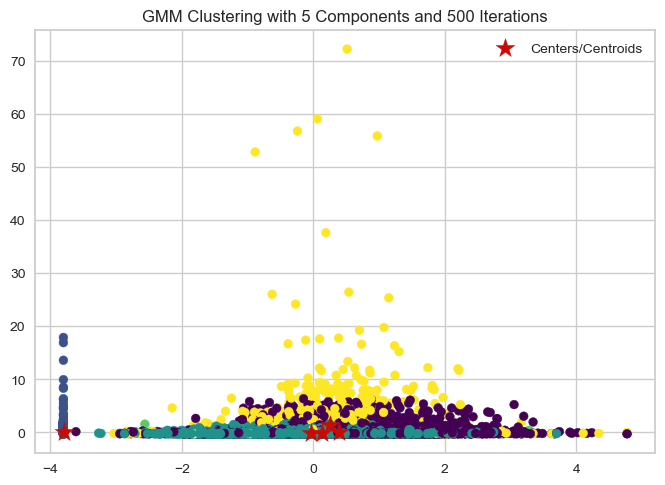

BIC Scores for each model: -367517.09611105593


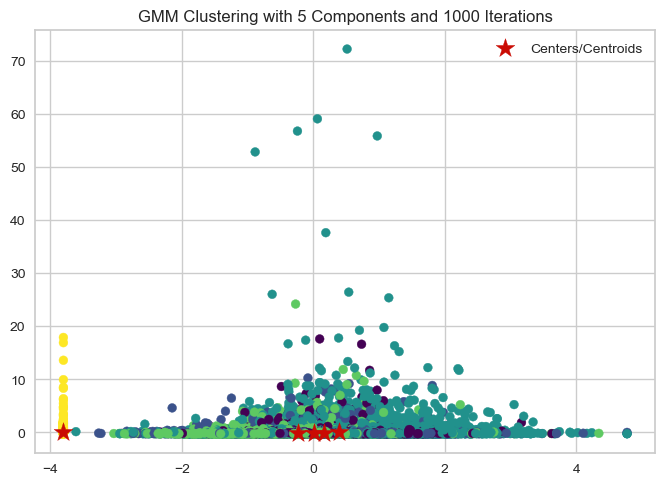

BIC Scores for each model: -246769.51863209868


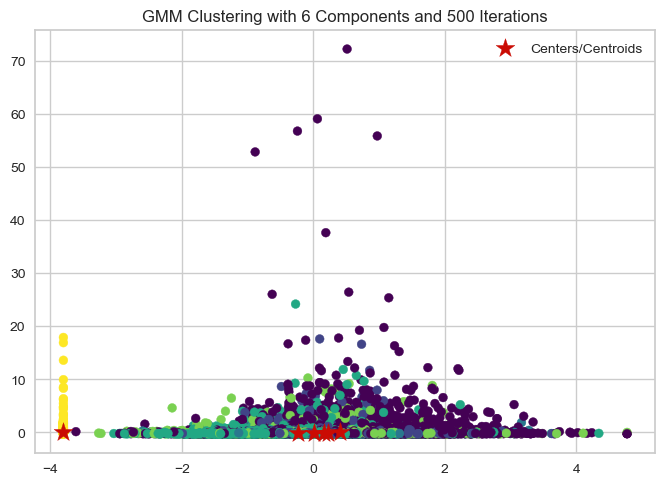

BIC Scores for each model: -476494.290246982


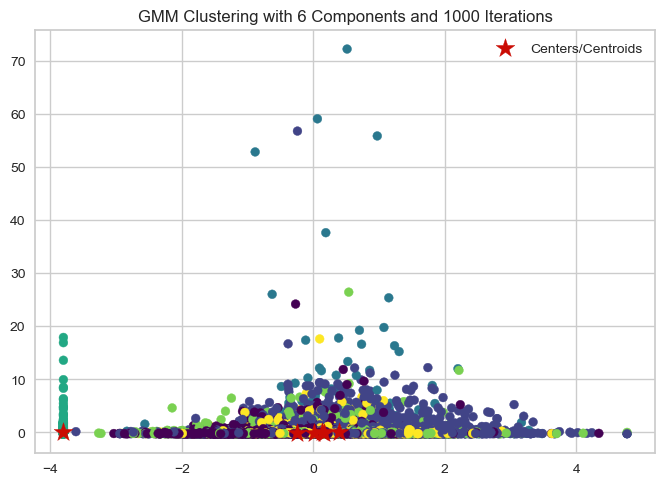

BIC Scores for each model: -714448.0733217285


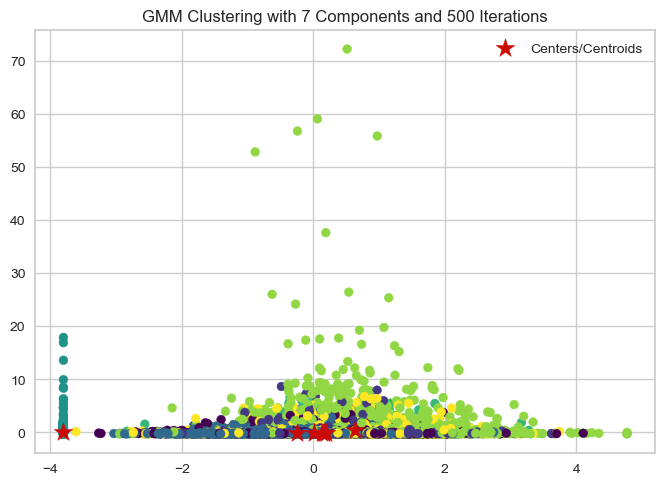

BIC Scores for each model: -1023708.4527271865


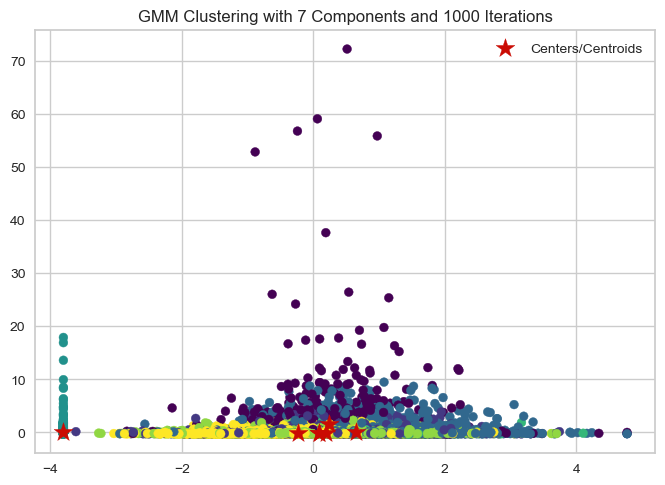

BIC Scores for each model: -1020859.4122020963


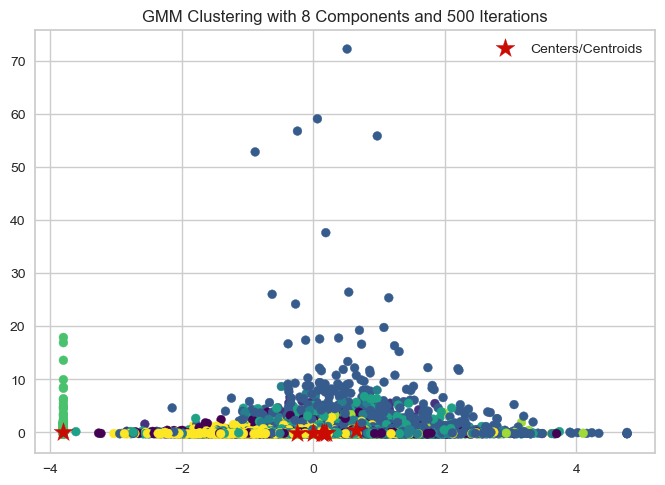

BIC Scores for each model: -1059676.1197909287


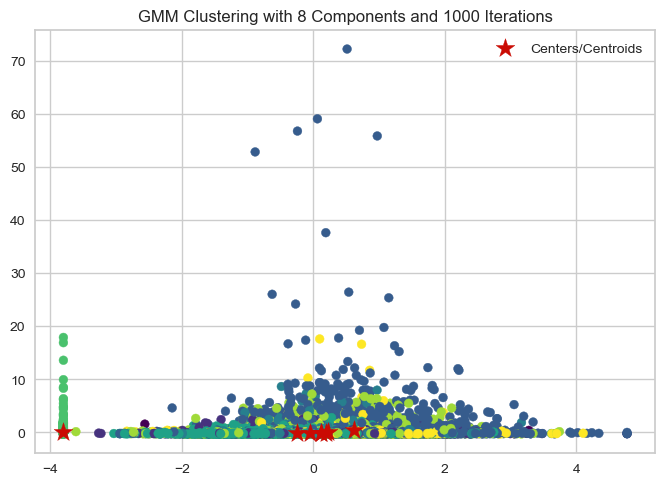

BIC Scores for each model: -1267467.3014841957


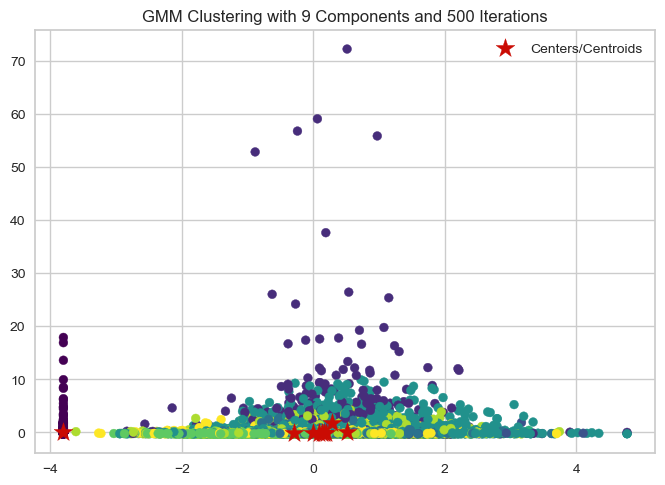

BIC Scores for each model: -1426048.8398502856


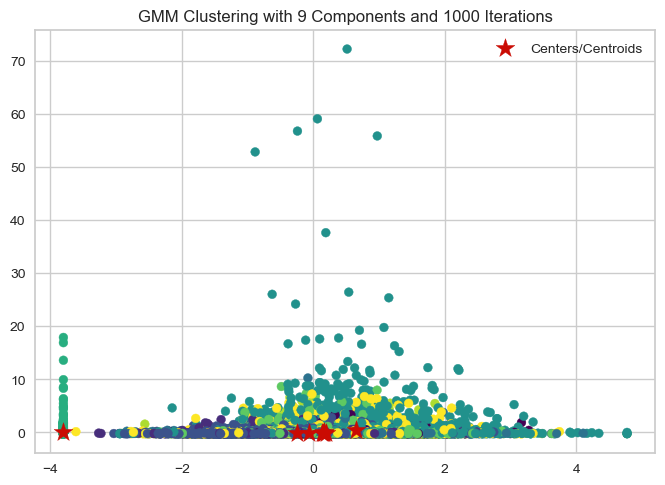

BIC Scores for each model: -1207413.6388046741


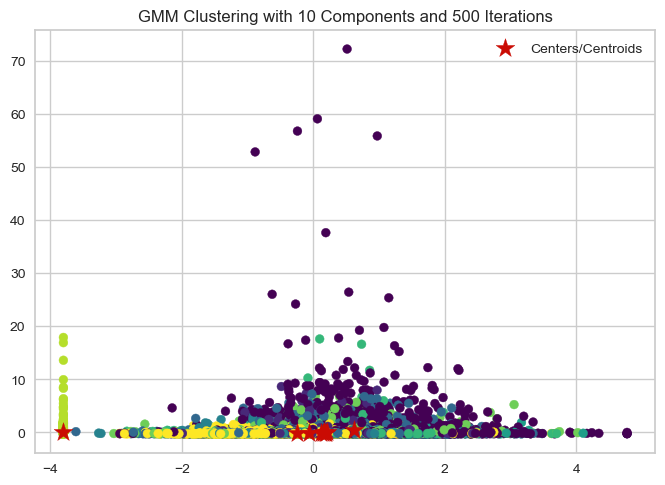

BIC Scores for each model: -1797094.6051601146


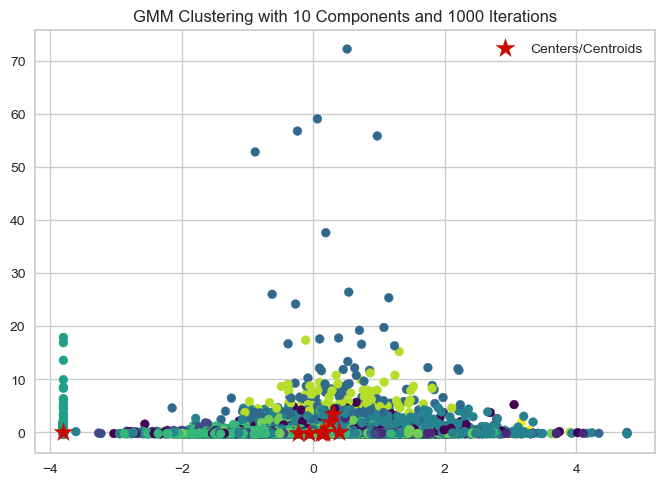

BIC Scores for each model: -1930819.4419564025


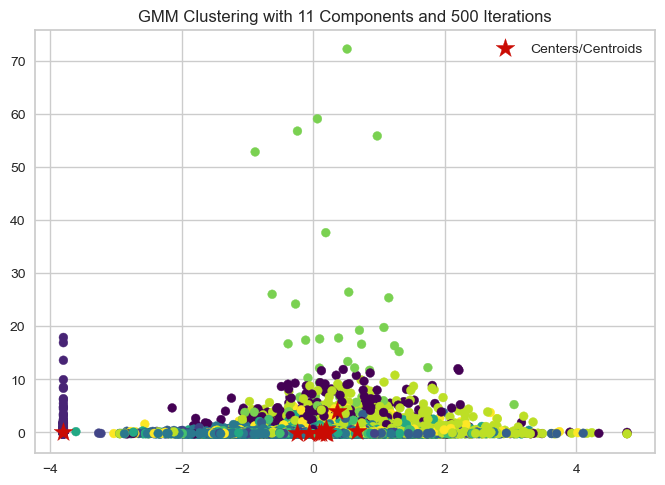

BIC Scores for each model: -2109364.7808483033


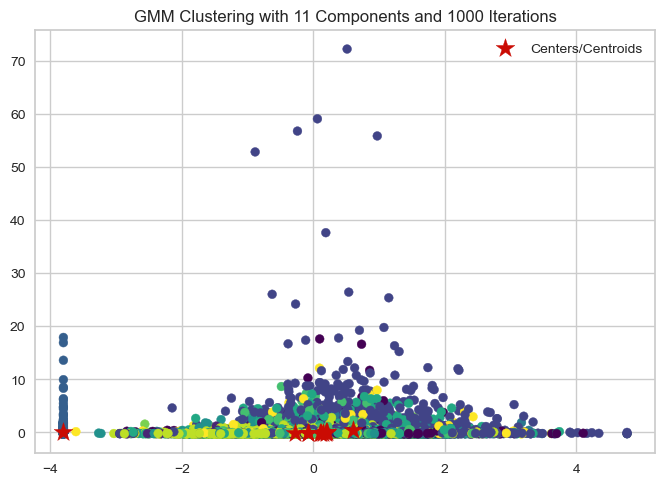

BIC Scores for each model: -1867221.624023347


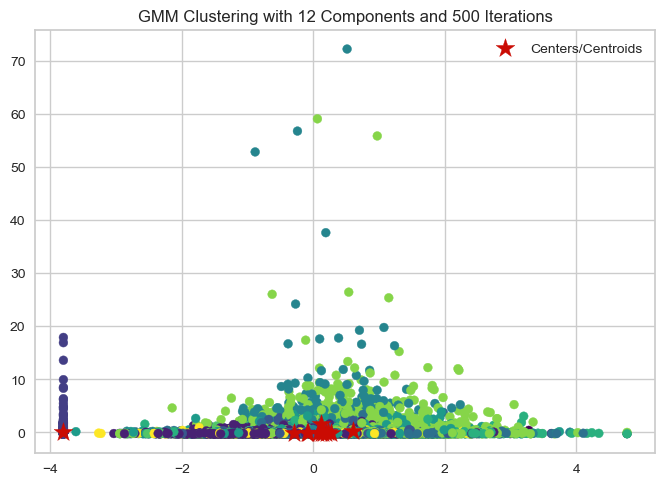

BIC Scores for each model: -1778275.485978204


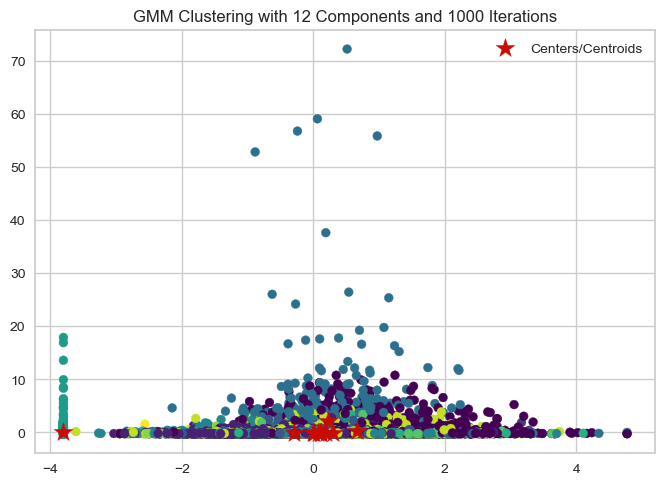

BIC Scores for each model: -1730328.4409986262


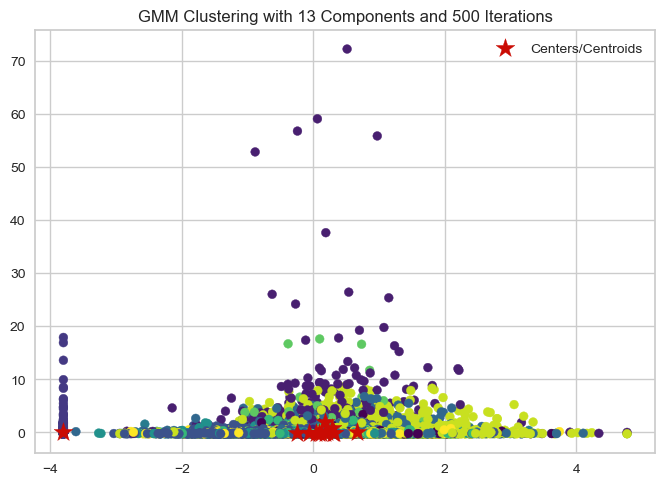

BIC Scores for each model: -1864047.9855024864


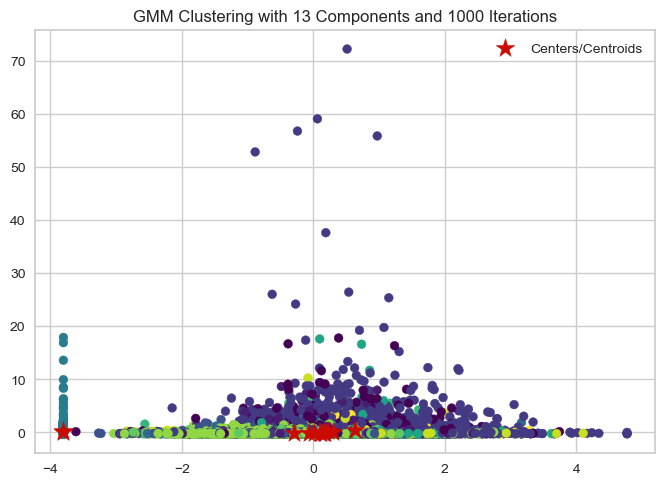

BIC Scores for each model: -1634200.0954028289


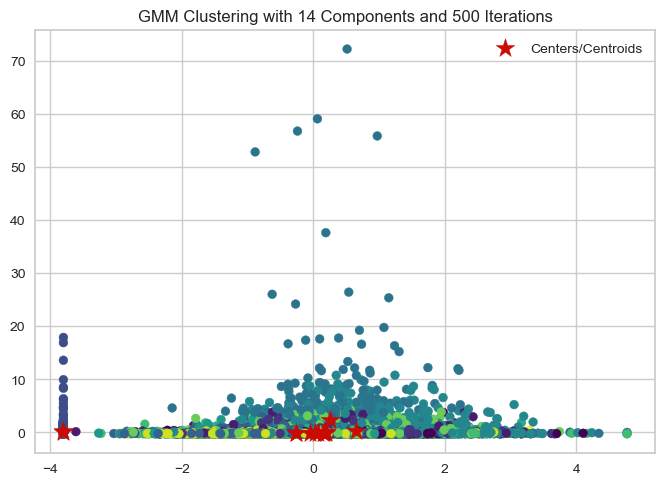

BIC Scores for each model: -2275183.6337176054


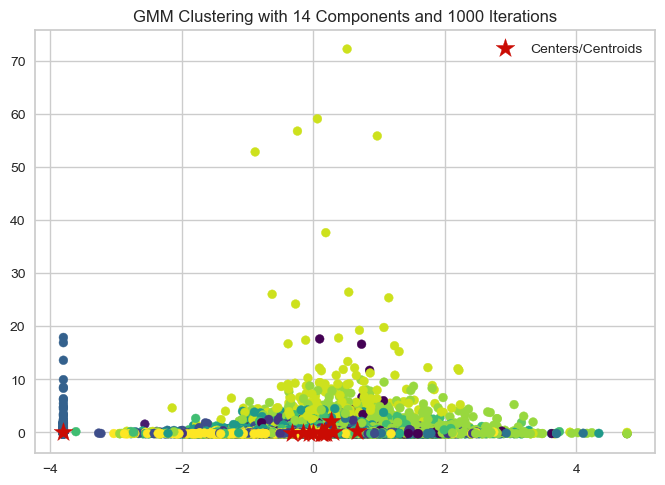

BIC Scores for each model: -2135192.762928603
BIC Scores for each model: [-367517.09611105593, -246769.51863209868, -476494.290246982, -714448.0733217285, -1023708.4527271865, -1020859.4122020963, -1059676.1197909287, -1267467.3014841957, -1426048.8398502856, -1207413.6388046741, -1797094.6051601146, -1930819.4419564025, -2109364.7808483033, -1867221.624023347, -1778275.485978204, -1730328.4409986262, -1864047.9855024864, -1634200.0954028289, -2275183.6337176054, -2135192.762928603]


In [154]:
# GMM model BIC score 

from sklearn.mixture import GaussianMixture

n_components_range = range(5, 15)
max_iters = [500, 1000]

def gmm_bic(df1_std, n_components_range, max_iters):
    # BIC score recording
    bic_scores = []

    # Iterate over different n_components and max_iter values
    for n_components in n_components_range:
        for max_iter in max_iters:
            # Initialize and fit the GMM model
            gmm = GaussianMixture(n_components=n_components, max_iter=max_iter)
            gmm.fit(df1_std)

            # Calculate BIC score
            bic_score = gmm.bic(df1_std)
            bic_scores.append(bic_score)

            # Create a plot to visualize the clusters and their centers
            plt.figure()
            plt.scatter(df1_std[:, 17], df1_std[:, 33], c=gmm.predict(df1_std), s=40, cmap='viridis', alpha=1.0)

            centers = gmm.means_
            plt.scatter(centers[:, 17], centers[:, 33], c='r', marker='*', s=200, label='Centers/Centroids')
            plt.title(f"GMM Clustering with {n_components} Components and {max_iter} Iterations")
            # plt.xlabel('Feature 1')
            # plt.ylabel('Feature 2')
            plt.legend()
            plt.show()  # Display the plot
            print("BIC Scores for each model:", bic_score)


    return bic_scores

# Assuming you have 'df1_std' defined
bic_scores = gmm_bic(df1_std, n_components_range=range(5, 15), max_iters=[500, 1000])

print("BIC Scores for each model:", bic_scores)

In [14]:
# GMM record the highest silhouette score
######################################################

# Find the highest silhouette score
lowest_gmm_BICscore = min(bic_scores)

print("Lowest GMM Clustering Model BIC score with 14 components and 500 iterations", lowest_gmm_BICscore)

Lowest GMM Clustering Model BIC score with 14 components and 500 iterations -2368687.2885275623


    Results: The GMM model produced an optimized model with 15 clusters and max iterations of 500 and produced a BIC score of -2368687.2885275623. The lower a BIC score the better; what makes the results curious is that the BIC score suggested different number of clusters compared to that of the silhouette score from the GMM model earlier. 

    Getting the BIC score was simply an exercise and for analysis purposes we'll discount these results and instead lean on the silhouette score as our evaluation method given that the other models are using this metric to assess performance. 

____


### Resources/Sources: 

    AI: Google's Bard, Chatgpt3.5 was utilized to optmized and debug as necessary. 
    
    chrome-extension://efaidnbmnnnibpcajpcglclefindmkaj/https://www.khoury.northeastern.edu/home/radivojac/classes/2021fallcs6220/hamerly_bookchapter_2014.pdf
    
    https://www.vlfeat.org/api/kmeans-fundamentals.html#:~:text=Elkan's%20algorithm%20%5B7%5D%20is%20a,when%20assigning%20points%20to%20clusters.

    https://towardsdatascience.com/understanding-optics-and-implementation-with-python-143572abdfb6
    
    https://cdanielaam.medium.com/understanding-optics-clustering-hands-on-with-scikit-learn-1786bddc71f5
    site Source:  https://www.geeksforgeeks.org/ml-optics-clustering-explanation/

    https://jakevdp.github.io/PythonDataScienceHandbook/05.12-gaussian-mixtures.html
    cite source: https://www.datatechnotes.com/2022/07/clustering-example-with-gaussian.html

    Textbook: Python Machine Learning: Machine Learning and Deep Learning with Python, scikit-learn, and TensorFlow2, Sebastian Raschka & Vahid Mirjalili, Third Edition 2019
    
    Textbook:
